In [1]:
import bz2
import dill
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import glob, os, pathlib, re
import pickle
import ipywidgets as widgets
from ipywidgets import Button, Layout, Dropdown
from lmfit import Model, Parameters
from lmfit.models import PseudoVoigtModel, PolynomialModel, ConstantModel, LinearModel, PowerLawModel
from scipy.interpolate import CubicSpline, splev, splrep, interp1d


import inflect
p = inflect.engine()

from xrd_tools import getReflections
from Testing_LMFIT_functions import *

In [2]:
# Define paths
data_dir = r'Z:\Diamond_MG28894-1_DATA_BACKUP\rawdata'
cal_dir = r"Z:\Diamond_MG28894-1_DATA_BACKUP\processing"
final_data = r"Z:\Diamond_MG28894-1_PROCESSING\Diamond_integrated_stacked"

In [3]:
### find data paths ###

experiment_paths = [x for x in pathlib.Path(final_data).iterdir() if x.is_dir()]
experiment_dirs = [x.stem for x in experiment_paths]

In [4]:
drop_down = Dropdown(options=experiment_dirs, value=experiment_dirs[0], description='scanID:', disabled=False, 
                             layout=Layout(width='40%'), style={'description_width': 'initial'})

def dropdown_handler(change):
    global scanID
    scanID = change.new
drop_down.observe(dropdown_handler, names='value')
display(drop_down)

Dropdown(description='scanID:', layout=Layout(width='40%'), options=('New folder', '108800_mask0pt75_non_dil')…

## Select cakes:

In [5]:
### setup frames list for chosen experiment ###

frame_list_paths = sorted(list(pathlib.Path(final_data + "\\" + scanID).glob("**\\*.txt")))
frame_list = sorted(frame_list_paths, key=lambda i: int(i.stem))

In [6]:
cake_list = [9,10,11]

data, frames = merge_cakes(frame_list, cake_list)

In [ ]:
# def safe_open_w(path):
#     ''' Open "path" for writing, creating any parent directories as needed.
#     '''
#     os.makedirs(os.path.dirname(path), exist_ok=True)
#     return open(path, 'w')

In [ ]:
# sname = "Z:\\Diamond_MG28894-1_PROCESSING\\Diamond_stacked_data\\" + sample + "_merged_c9-10-11\\" + sample + ".csv"
# with safe_open_w(sname) as output:
#     df.to_csv(output, index=None, sep='\t', mode='a', line_terminator='\n')

x_max:  3643 	 x_min:  636 	 len_x:  3007 	 len_y:  3007


<IPython.core.display.Javascript object>


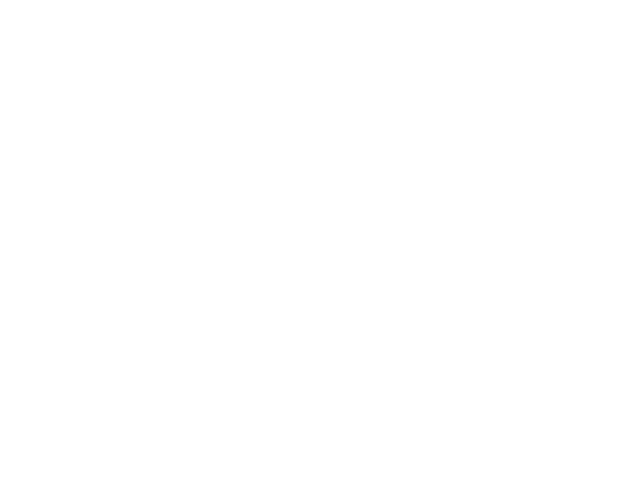

In [7]:
# data = data.T[:-3].T ### slice array if nonsense data somewhere

### plot diffraction pattern and add horizontal line for each automatically chosen peak & trough
x_min = np.where(data[0][1:]<=2.71806)[0][-1]
x_max = np.where(data[0][1:]>=6.1)[0][0]

x = data[0][x_min:x_max]
y = data[1][x_min:x_max]

print("x_max: ", x_max , "\t x_min: ", x_min, "\t len_x: ", len(x), "\t len_y: ", len(y))
# plt.xlim(2.85, 2.9)
# plt.ylim(5*10**4, 10**5.5)

plt.plot(x, y)
plt.yscale("log")

In [8]:
### roughly find Zr peaks & background knots (for use with cubic spline background) ###

max_threshold = 500
min_threshold = 80
auto_peaks = list(auto_peak_selector(x, y, max_threshold))
auto_minimums = list(auto_minimum_selector(x, y, min_threshold))

# find maximum for each peak
peak_max = []

for peak in auto_peaks:
    intensitys = [val[1] for val in peak]
    max_y = max(intensitys)
    ymax_twotheta = peak[intensitys.index(max_y)][0]
    peak_max.append((ymax_twotheta, max_y))
    
# find minimum between each peak
trough_mins = []

for peak in auto_minimums:
    intensitys = [val[1] for val in peak]
    min_y = min(intensitys)
    ymin_twotheta = peak[intensitys.index(min_y)][0]
    trough_mins.append((ymin_twotheta, min_y))

print(trough_mins)
    
# remove last minimum where signal is very weak to improve background fit
trough_mins = trough_mins[:-1]

[(2.7250626248493792, 4.845106333494186), (2.8701876498386265, 43.59579086303711), (2.927562659718096, 72.09461784362793), (3.0456876800581814, 12.361409604549408), (3.1424376967176793, 19.445744514465332), (3.6216877792403106, 5.531623959541321), (4.392312911935151, 4.566558361053467), (5.249563059546054, 5.739896535873413), (5.611813121922315, 21.328006267547607), (5.720938140712679, 29.443490028381348), (6.095563205219805, 14.611210346221924)]


In [9]:
### set simple constant background ###

bg_model = ConstantModel(prefix='bg_')
params = bg_model.make_params()
params["bg_c"].set(value=y[0], vary=True, max=y[0])

In [10]:
### parameters for Zr peaks ###

### Zr-Hydride parameters for reverse fit ###
# ZrH111d_min = 2.825; ZrH111d_max = 2.865
# ZrH111g_min = 2.868; ZrH111g_max = 2.89
# ZrH200d_min = 3.271; ZrH200d_max = 3.328
# ZrH200g_min = 3.342; ZrH200g_max = 3.382
# SPP1_min = 3.622 ;SPP1_max = 3.650
# SPP2_min = 3.692; SPP2_max = 3.722
# ZrH220a_min = 4.588; ZrH220a_max = 4.656
# ZrH220b_min = 4.557; ZrH220b_max = 4.595
# ZrH311_min = 5.456; ZrH311_max = 5.495

### Zr-Hydride parameters for forward fit ###
ZrH111d_min = 2.878; ZrH111d_max = 2.915
ZrH111g_min = 2.914; ZrH111g_max = 2.947
ZrH200d_min = 3.306; ZrH200d_max = 3.342; ZrH200d_centre = 3.322
ZrH200g_min = 3.408; ZrH200g_max = 3.428
SPP1_min = 3.692 ;SPP1_max = 3.710
SPP2_min = 3.765; SPP2_max = 3.781
ZrH220a_min = 4.696; ZrH220a_max = 4.749
ZrH220b_min = 4.765; ZrH220b_max = 4.811
ZrH311_min = 5.508; ZrH311_max = 5.549
ZrFeCr_min = 3.15; ZrFeCr_max = 3.17

#########################################################################################

pv_models = {}
# min_y = min(y[50: -50])

for i, maxima in enumerate(auto_peaks):
    
    # generate PseudoVoigtModels for each peak (i.e. maxima range from auto_peak_selector)
    model_key = "pv{0}".format(i+1)
    prefix=model_key+"_"
    pv_models[model_key] = PseudoVoigtModel(prefix=prefix)
    params.update(pv_models[model_key].make_params())
    
    # set initial parameter values
    intensitys = [val[1] for val in maxima]
    max_y = max(intensitys)
    ymax_twotheta = maxima[intensitys.index(max_y)][0]
#     pv_twotheta_max = maxima[-1][0] # set sigma based on min & max ttheta from the auto_peaks function
#     pv_twotheta_min = maxima[0][0]
#     sigma = (pv_twotheta_max-pv_twotheta_min)/4

    sigma = 0.01 # set sigma to known approximate value

    params.add(f"{model_key}_center", value=ymax_twotheta, min=ymax_twotheta-sigma, max=ymax_twotheta+sigma)
    params.add(f"{model_key}_sigma", value=sigma, min=sigma/10, max=sigma*2)
    params.add(f"{model_key}_fraction", value=0.1, min=0.01, max=0.2)

### Add Zr peaks to Zr Model ###
zr_model = bg_model
for key, value in pv_models.items():
    zr_model = zr_model + value

### Fit Zr model ###
zr_init = zr_model.eval(params, x=x)
zr_out = zr_model.fit(y, params, x=x, nan_policy='omit')
zr_comps = zr_out.eval_components(x=x)

In [ ]:
# print(zr_out.fit_report())

In [ ]:
# print(zr_out.params.pretty_print())
interactive_plot_results(x, y, zr_init, zr_out)

## Loop through full experiment

In [11]:
zr_fits = dict()
zr_fits[frames[0]] = [zr_out, zr_init]

In [12]:
### fit Zr peaks over full experiment
previous_params = zr_out.params

### set all parameters to vary ####
for param in previous_params:
    previous_params[param].set(vary=True)

fitting frame:  00016 	 index:  2


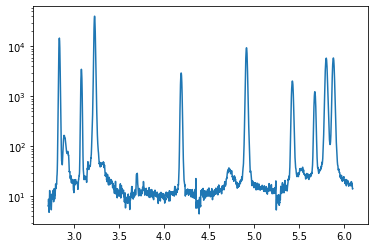


 fit after re-setting peak parameters


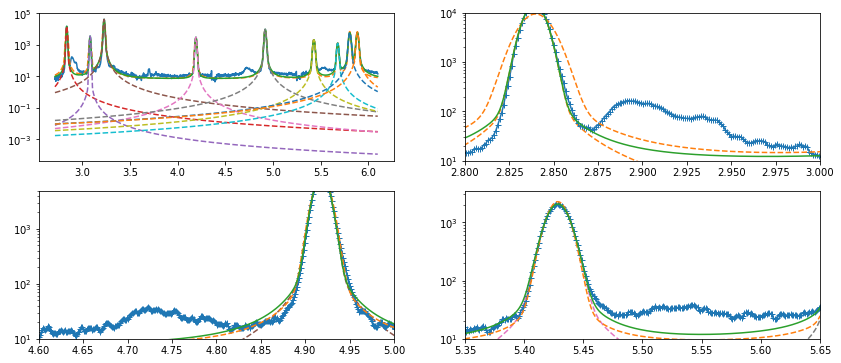

fitting frame:  00026 	 index:  3


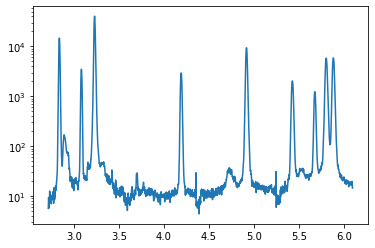


 fit after re-setting peak parameters


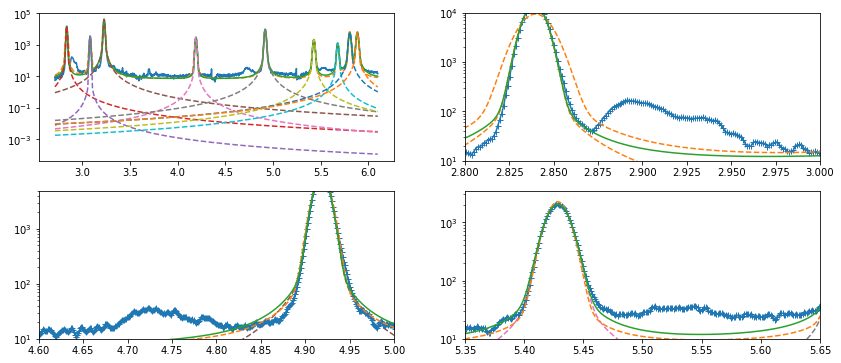

fitting frame:  00036 	 index:  4


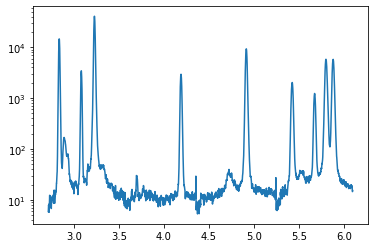


 fit after re-setting peak parameters


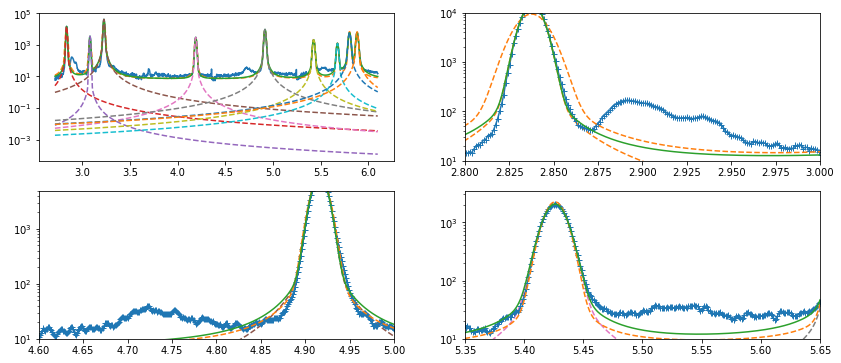

fitting frame:  00046 	 index:  5


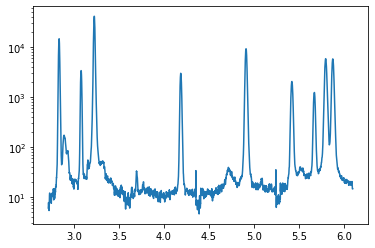


 fit after re-setting peak parameters


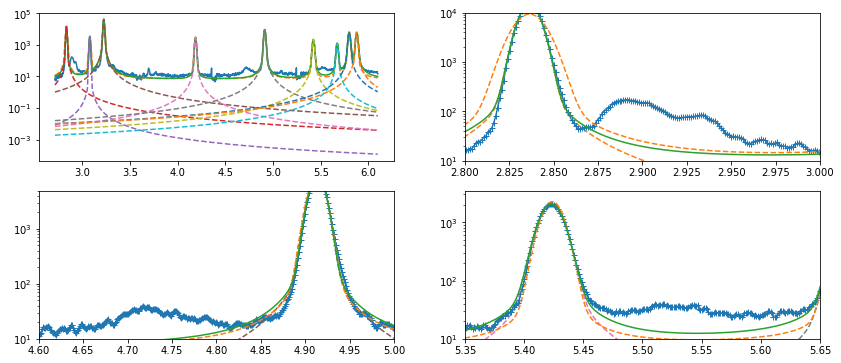

fitting frame:  00056 	 index:  6


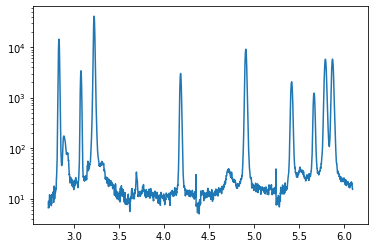


 fit after re-setting peak parameters


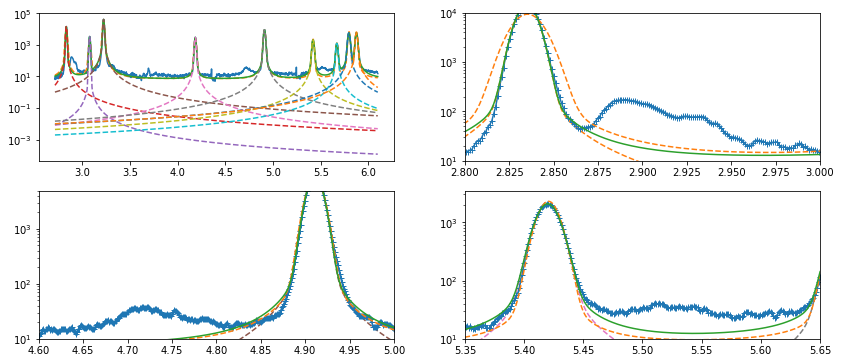

fitting frame:  00066 	 index:  7


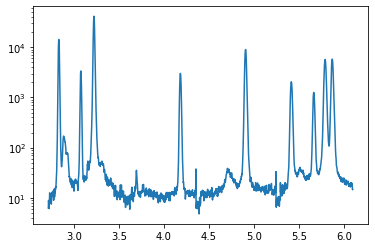


 fit after re-setting peak parameters


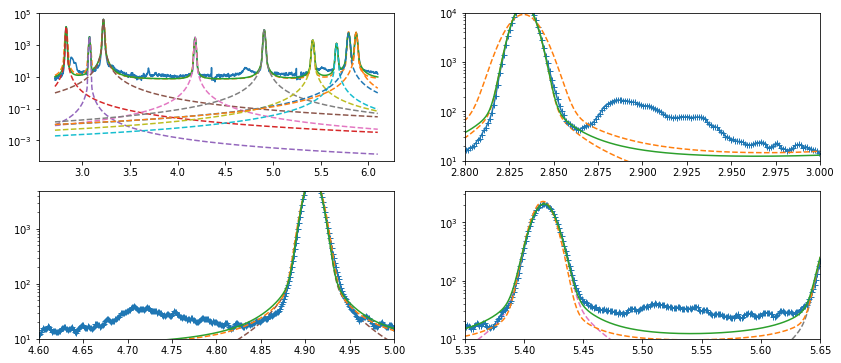

fitting frame:  00076 	 index:  8


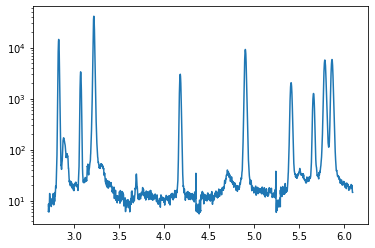


 fit after re-setting peak parameters


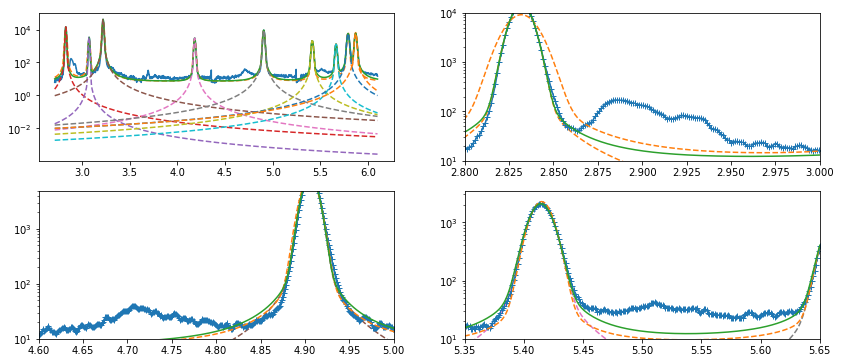

fitting frame:  00086 	 index:  9


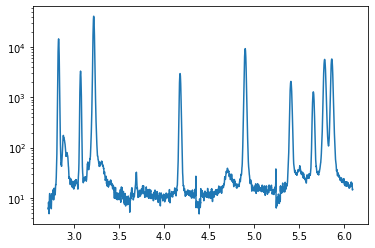


 fit after re-setting peak parameters


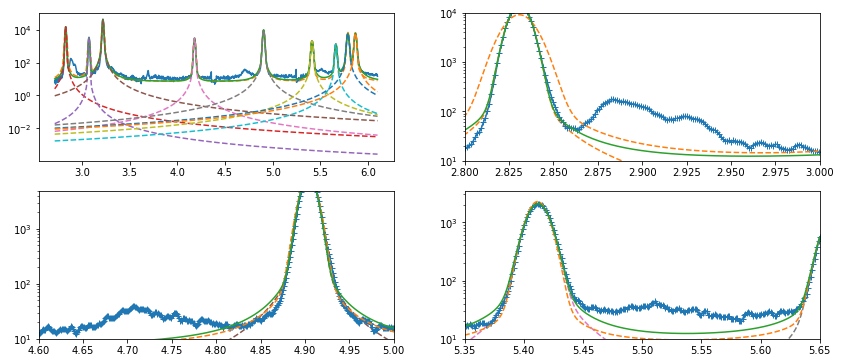

fitting frame:  00096 	 index:  10


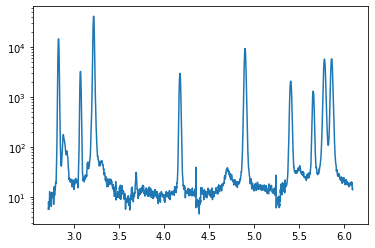


 fit after re-setting peak parameters


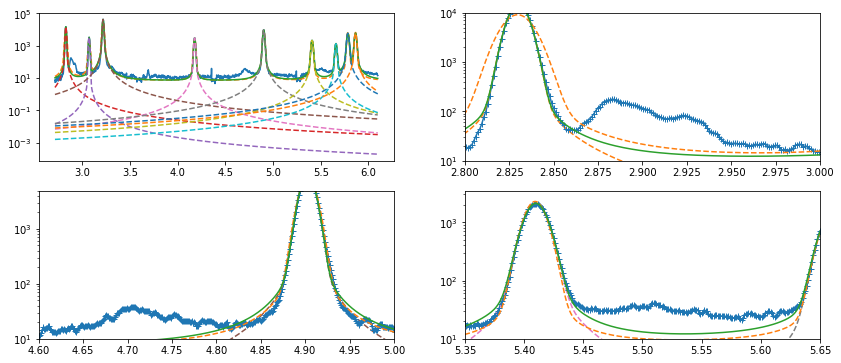

fitting frame:  00106 	 index:  11


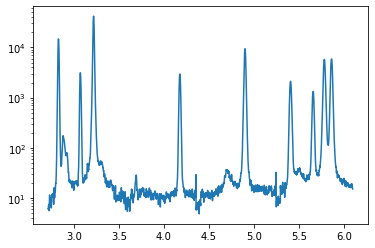


 fit after re-setting peak parameters


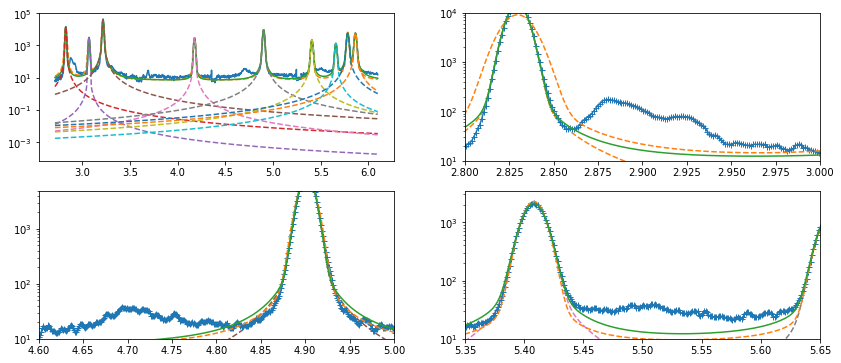

fitting frame:  00116 	 index:  12


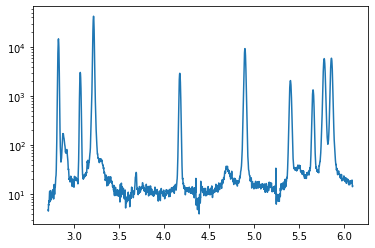


 fit after re-setting peak parameters


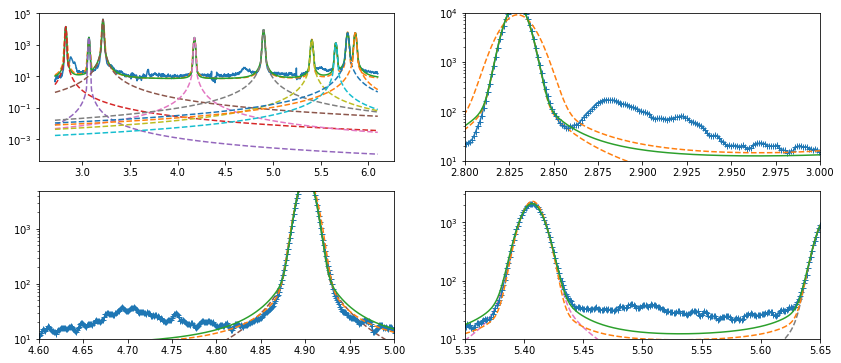

fitting frame:  00126 	 index:  13


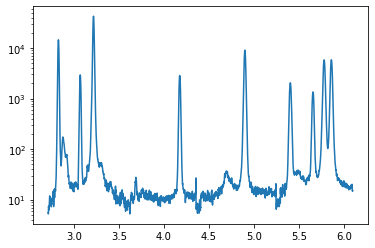


 fit after re-setting peak parameters


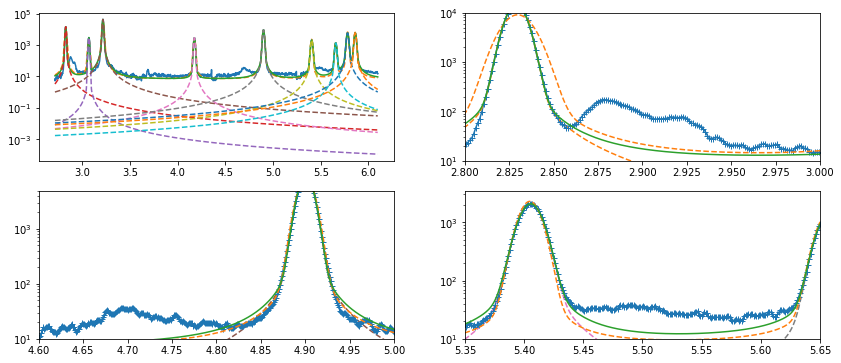

fitting frame:  00136 	 index:  14


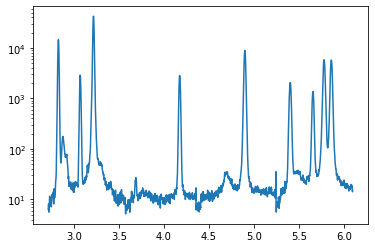


 fit after re-setting peak parameters


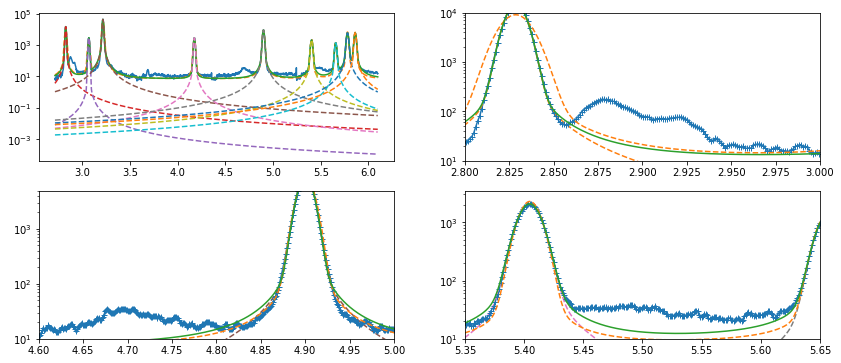

fitting frame:  00146 	 index:  15


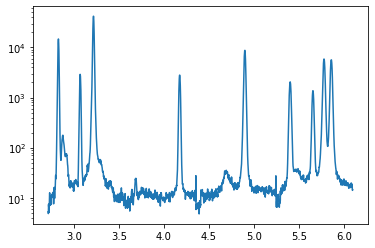


 fit after re-setting peak parameters


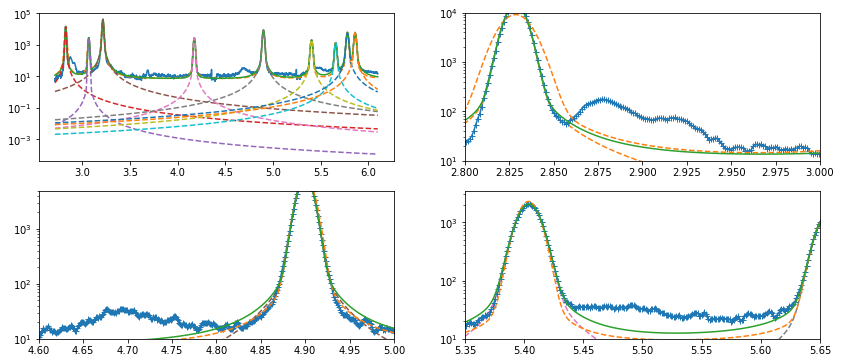

fitting frame:  00156 	 index:  16


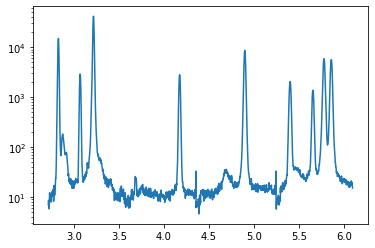


 fit after re-setting peak parameters


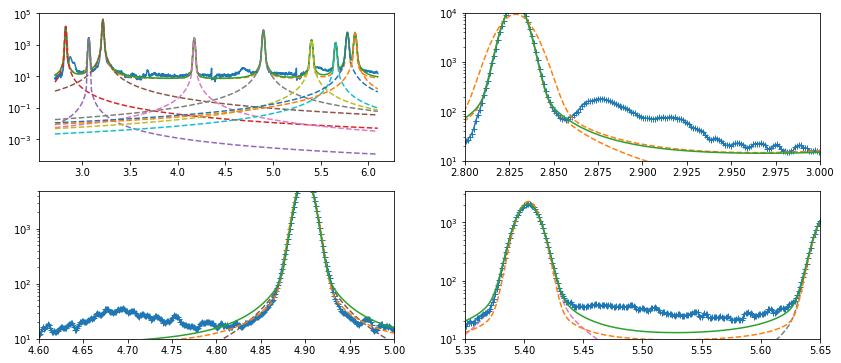

fitting frame:  00166 	 index:  17


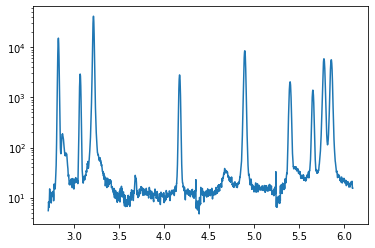


 fit after re-setting peak parameters


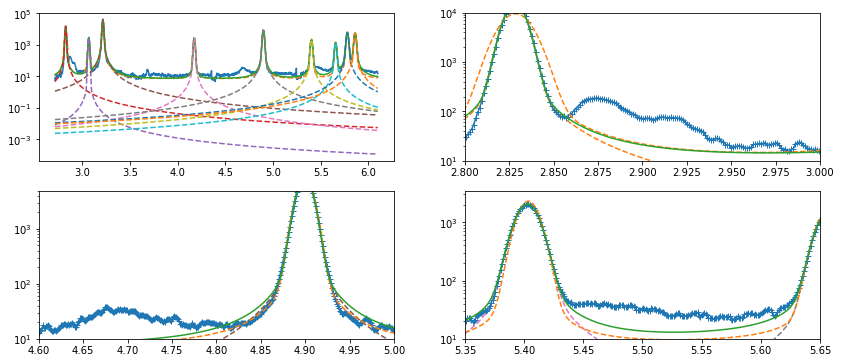

fitting frame:  00176 	 index:  18


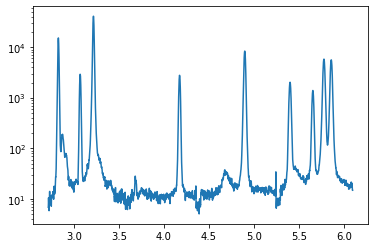


 fit after re-setting peak parameters


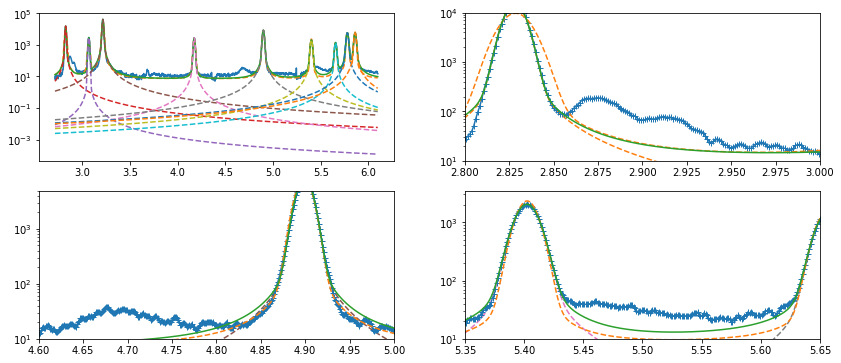

fitting frame:  00186 	 index:  19


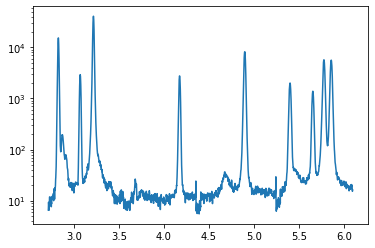


 fit after re-setting peak parameters


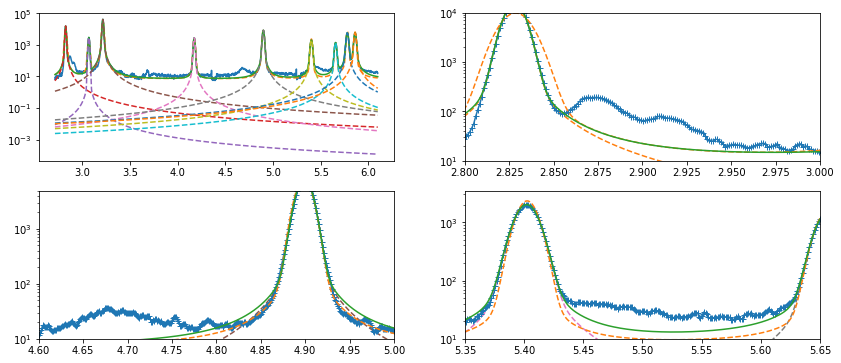

fitting frame:  00196 	 index:  20


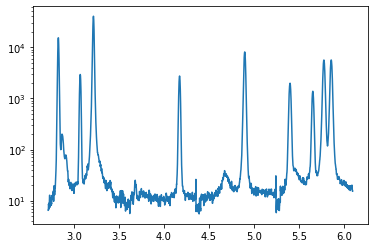


 fit after re-setting peak parameters


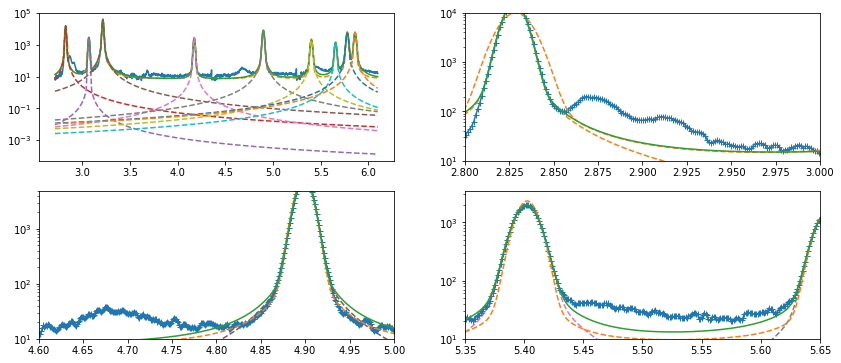

fitting frame:  00206 	 index:  21


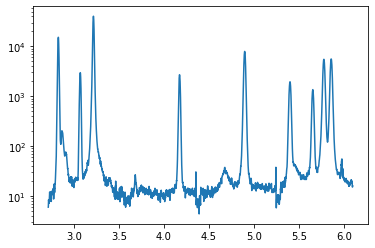


 fit after re-setting peak parameters


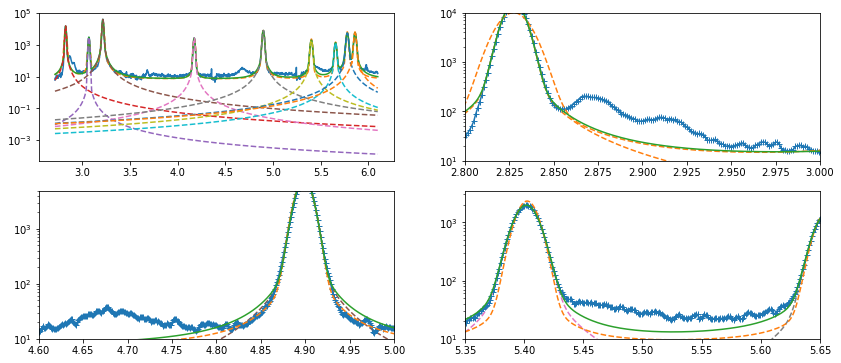

fitting frame:  00216 	 index:  22


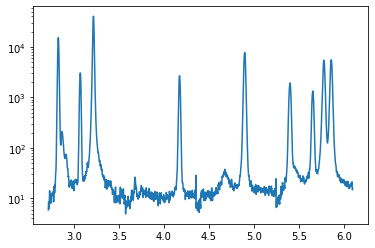


 fit after re-setting peak parameters


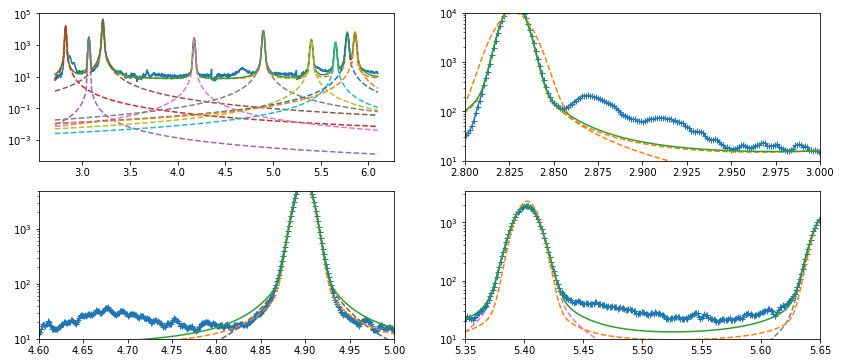

fitting frame:  00226 	 index:  23


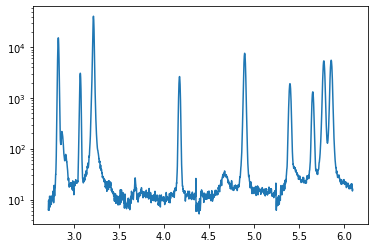


 fit after re-setting peak parameters


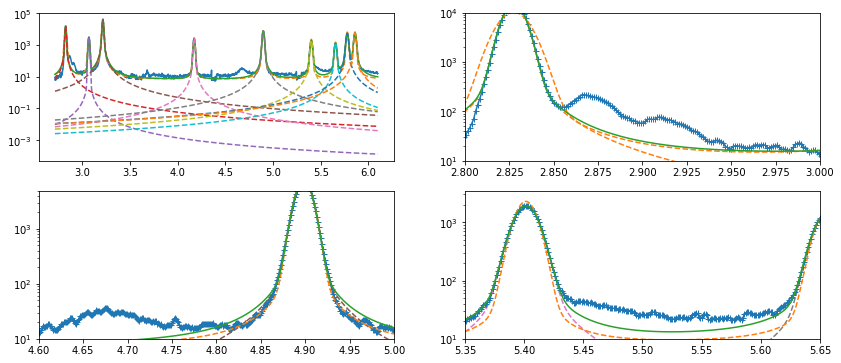

fitting frame:  00236 	 index:  24


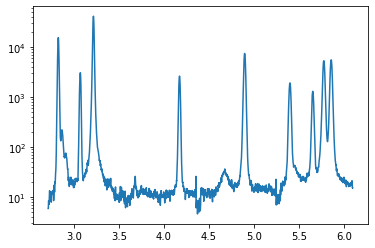


 fit after re-setting peak parameters


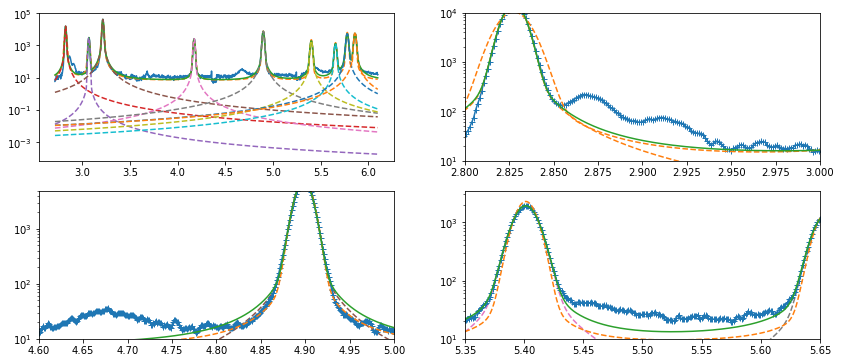

fitting frame:  00246 	 index:  25


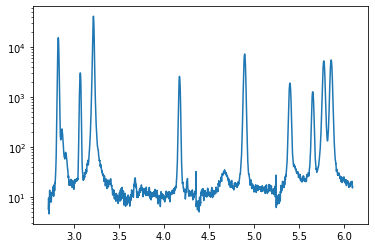


 fit after re-setting peak parameters


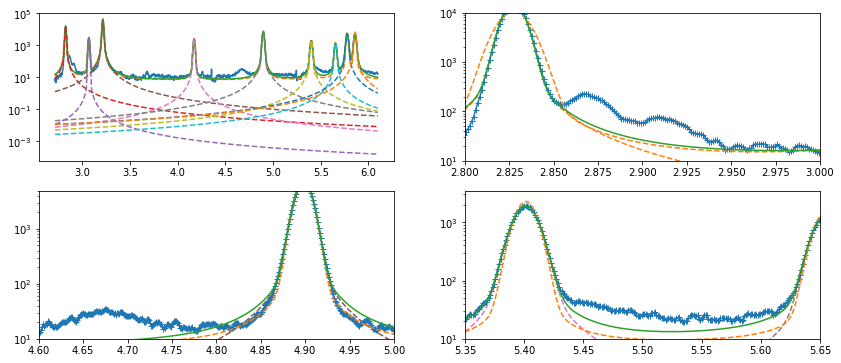

fitting frame:  00256 	 index:  26


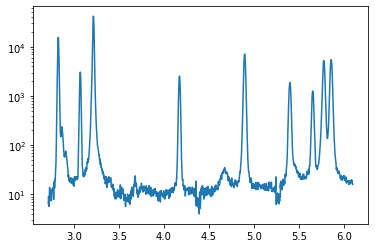


 fit after re-setting peak parameters


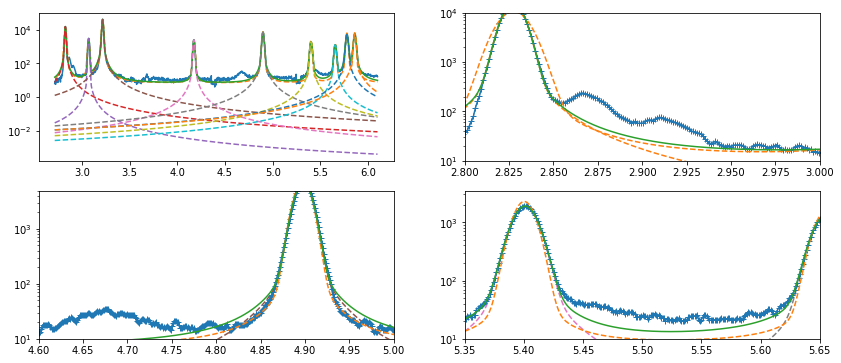

fitting frame:  00266 	 index:  27


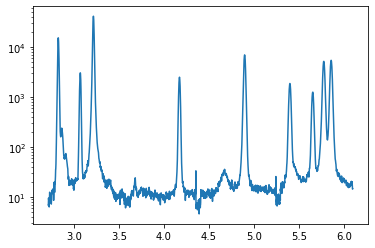


 fit after re-setting peak parameters


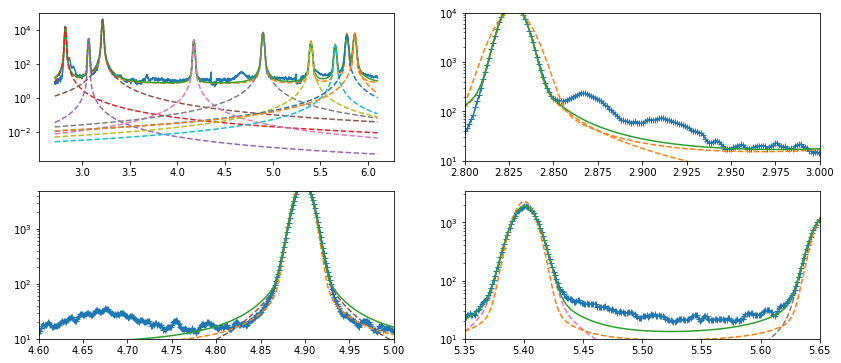

fitting frame:  00276 	 index:  28


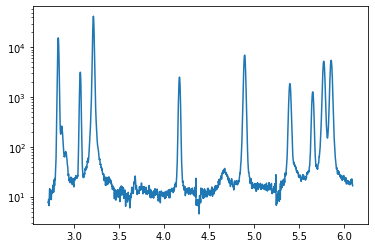


 fit after re-setting peak parameters


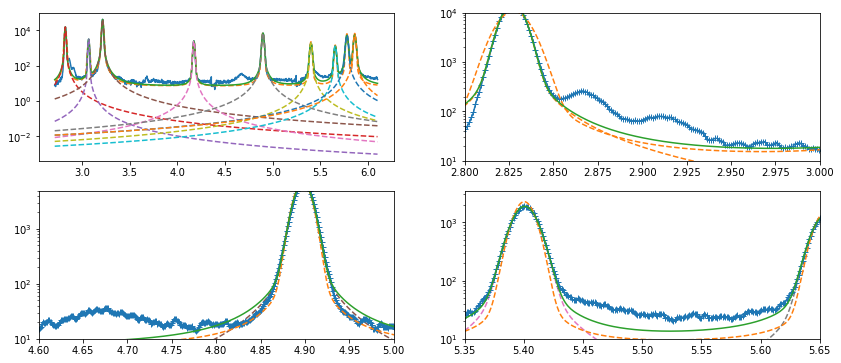

fitting frame:  00286 	 index:  29


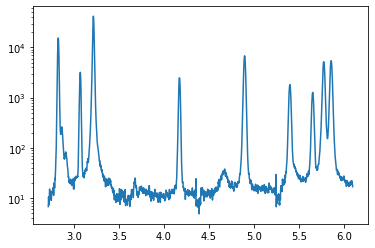


 fit after re-setting peak parameters


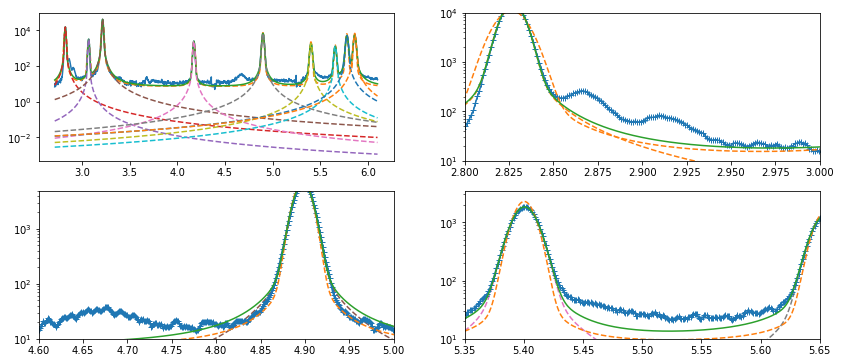

fitting frame:  00296 	 index:  30


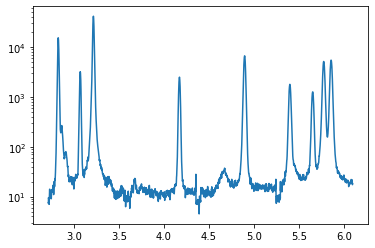


 fit after re-setting peak parameters


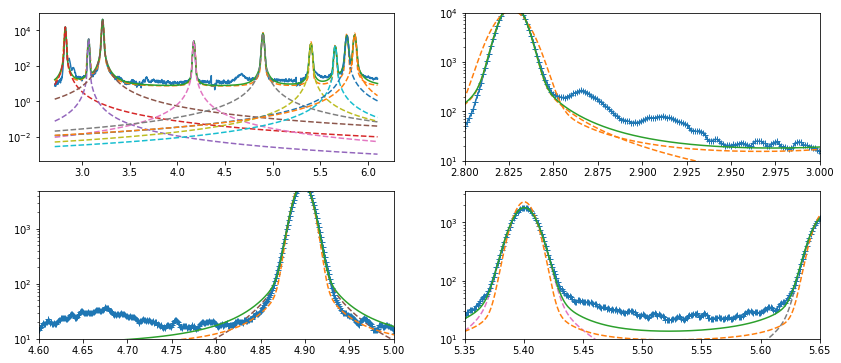

fitting frame:  00306 	 index:  31


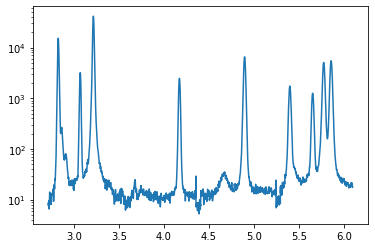


 fit after re-setting peak parameters


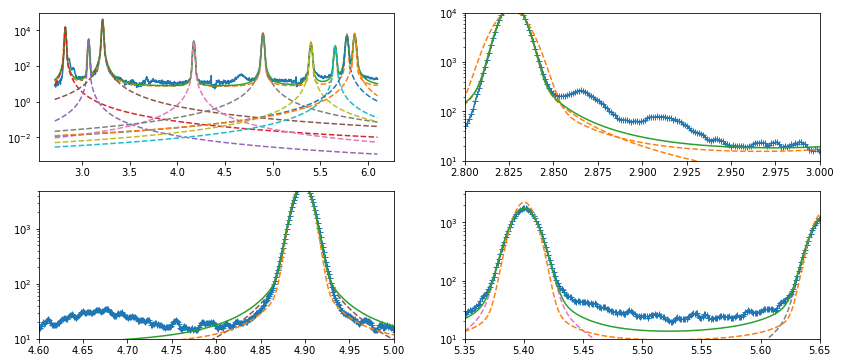

fitting frame:  00316 	 index:  32


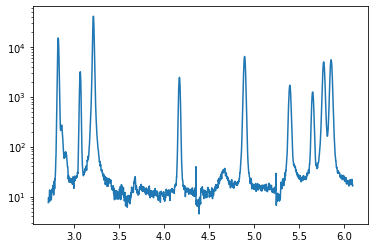


 fit after re-setting peak parameters


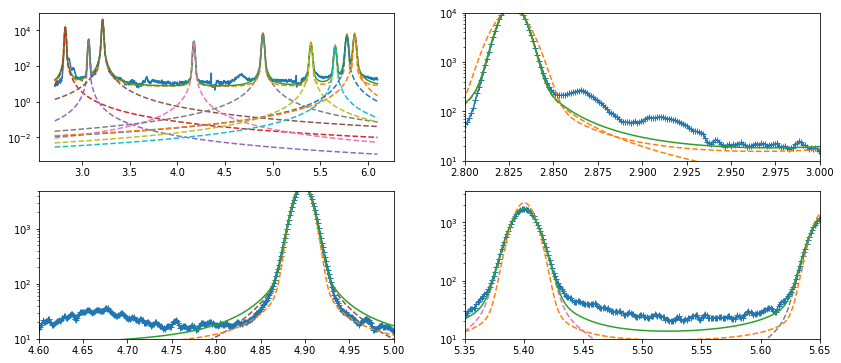

fitting frame:  00326 	 index:  33


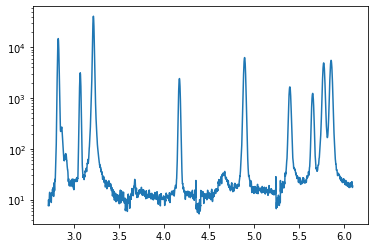


 fit after re-setting peak parameters


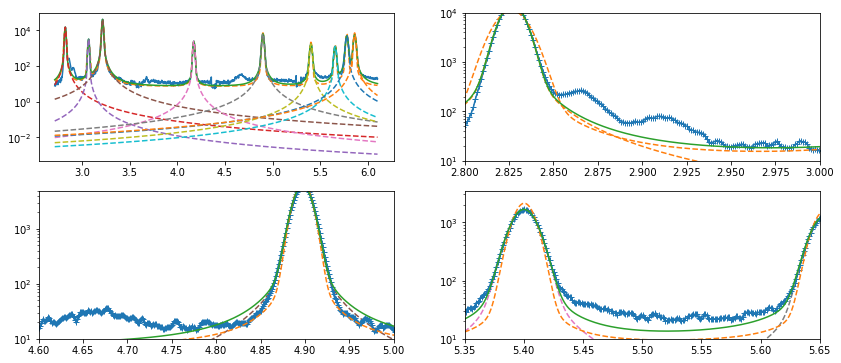

fitting frame:  00336 	 index:  34


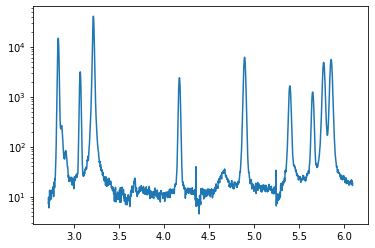


 fit after re-setting peak parameters


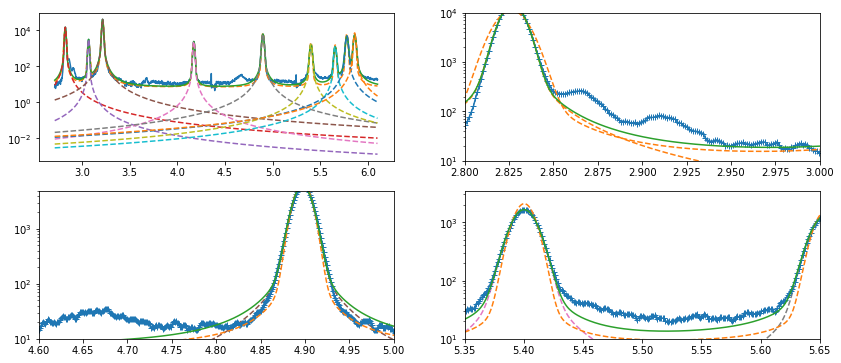

fitting frame:  00346 	 index:  35


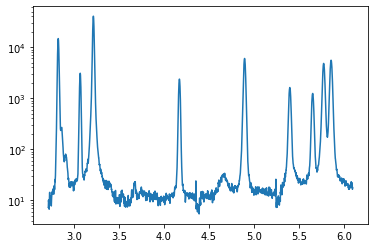


 fit after re-setting peak parameters


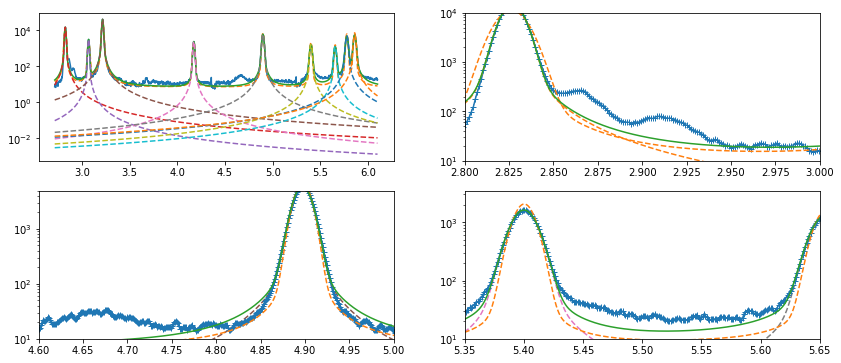

fitting frame:  00356 	 index:  36


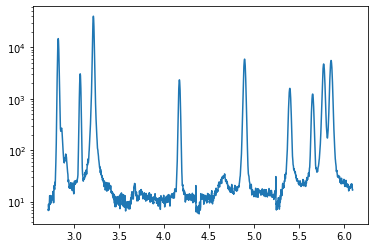


 fit after re-setting peak parameters


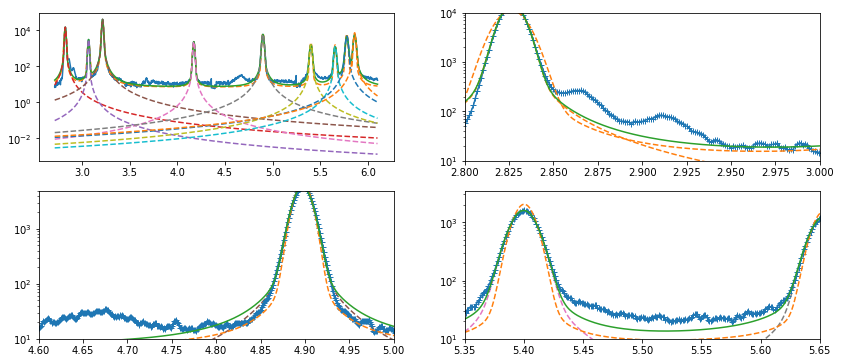

fitting frame:  00366 	 index:  37


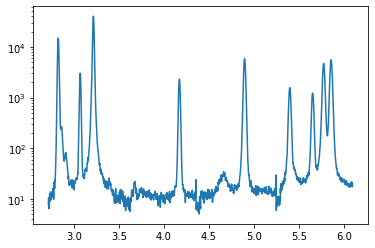


 fit after re-setting peak parameters


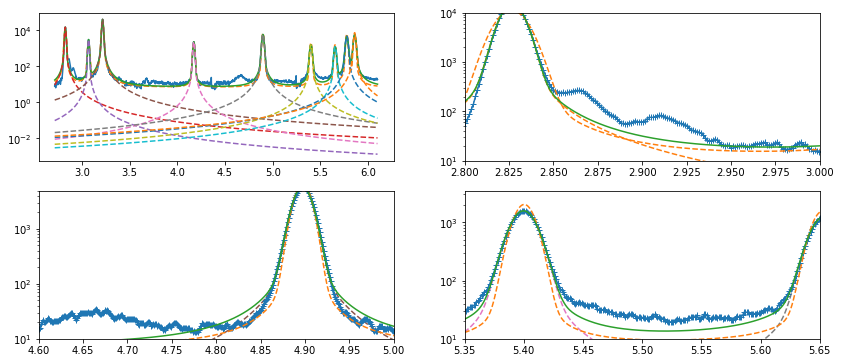

fitting frame:  00376 	 index:  38


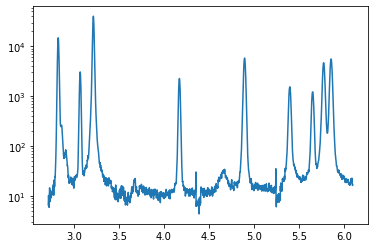


 fit after re-setting peak parameters


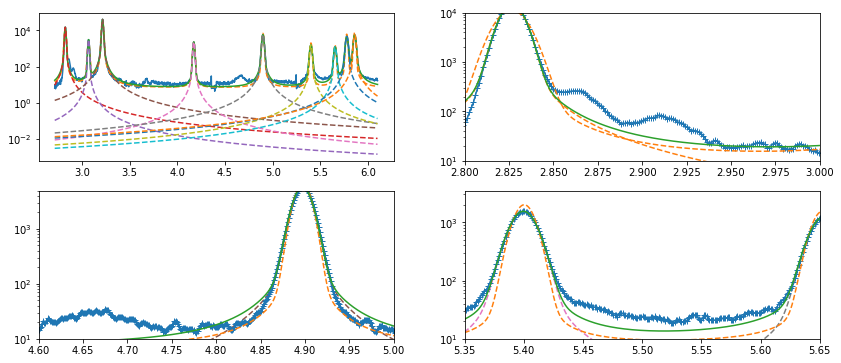

fitting frame:  00386 	 index:  39


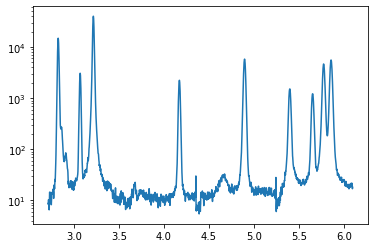


 fit after re-setting peak parameters


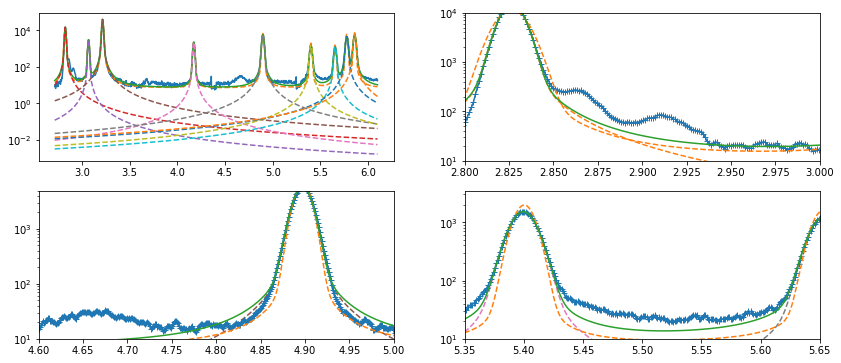

fitting frame:  00396 	 index:  40


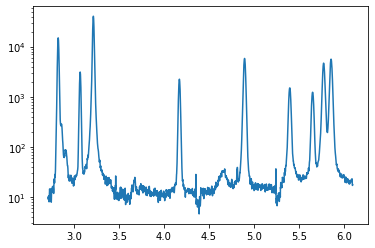


 fit after re-setting peak parameters


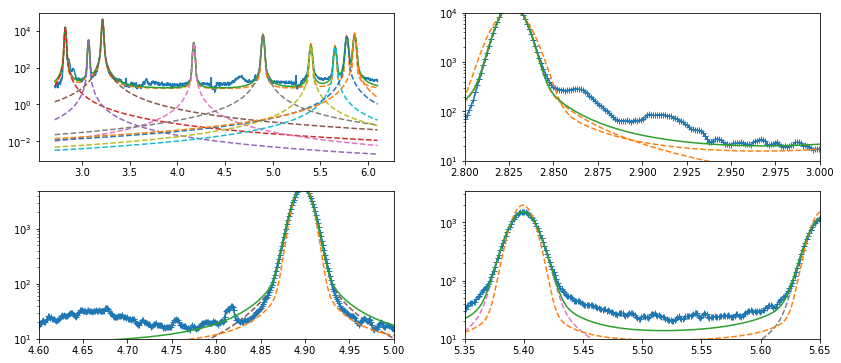

fitting frame:  00406 	 index:  41


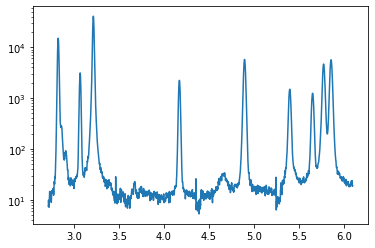


 fit after re-setting peak parameters


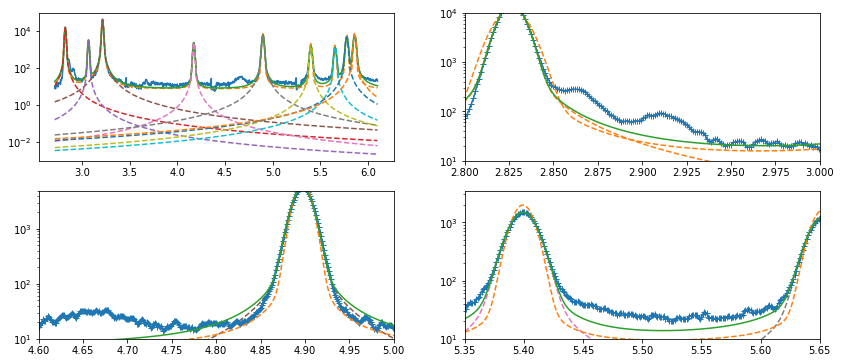

fitting frame:  00416 	 index:  42


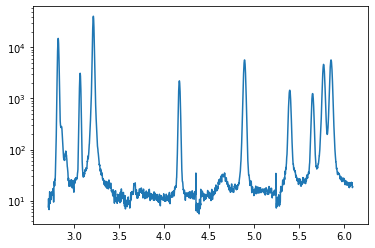


 fit after re-setting peak parameters


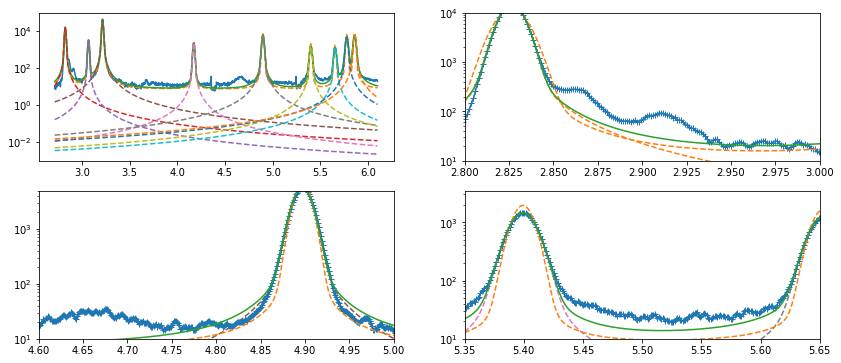

fitting frame:  00426 	 index:  43


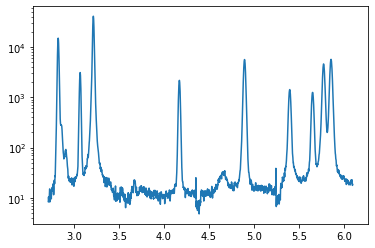


 fit after re-setting peak parameters


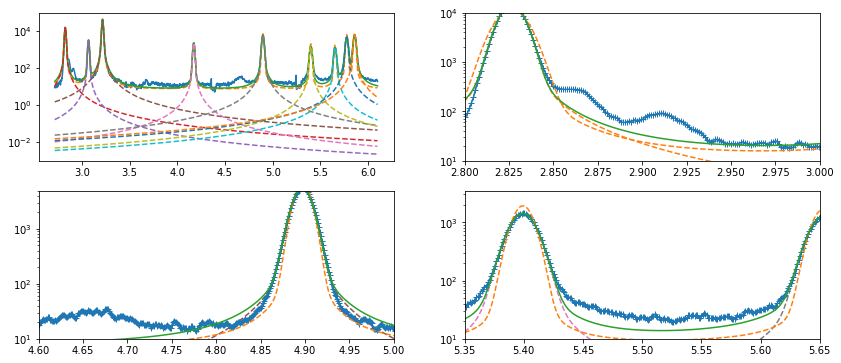

fitting frame:  00436 	 index:  44


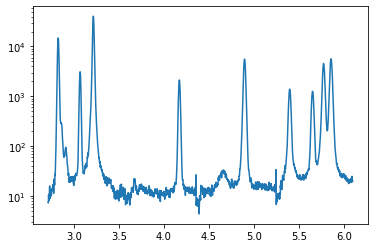


 fit after re-setting peak parameters


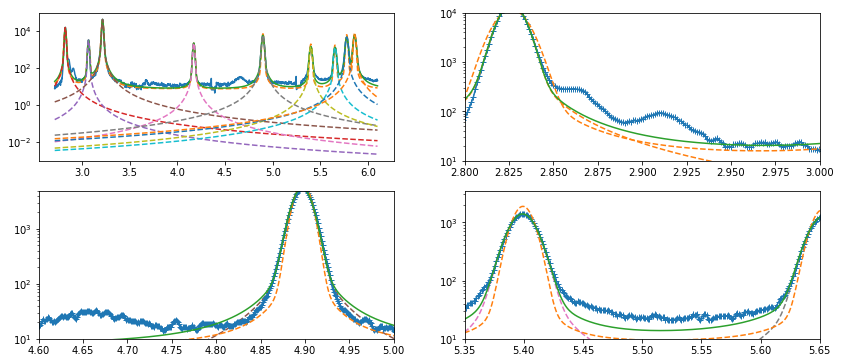

fitting frame:  00446 	 index:  45


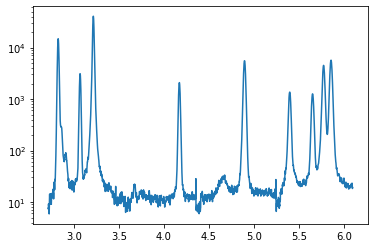


 fit after re-setting peak parameters


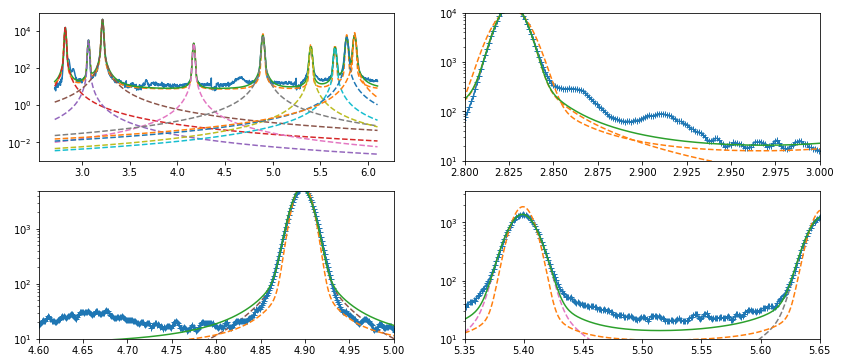

fitting frame:  00456 	 index:  46


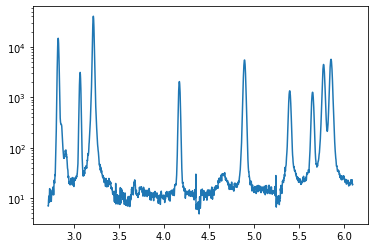


 fit after re-setting peak parameters


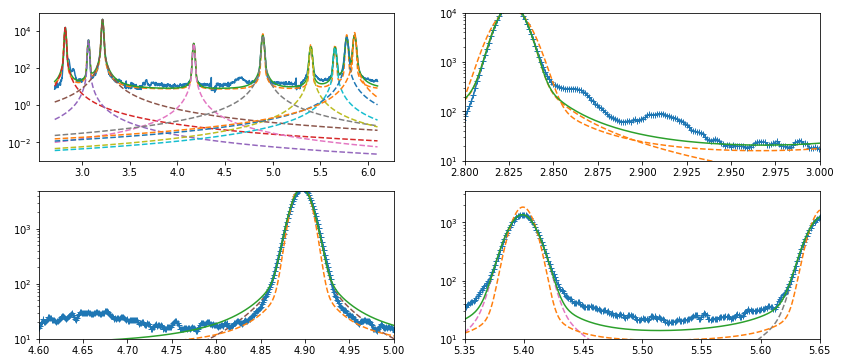

fitting frame:  00466 	 index:  47


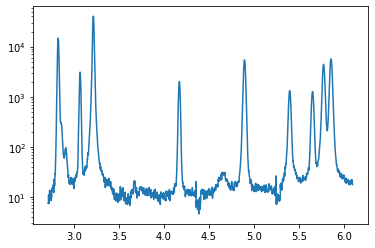


 fit after re-setting peak parameters


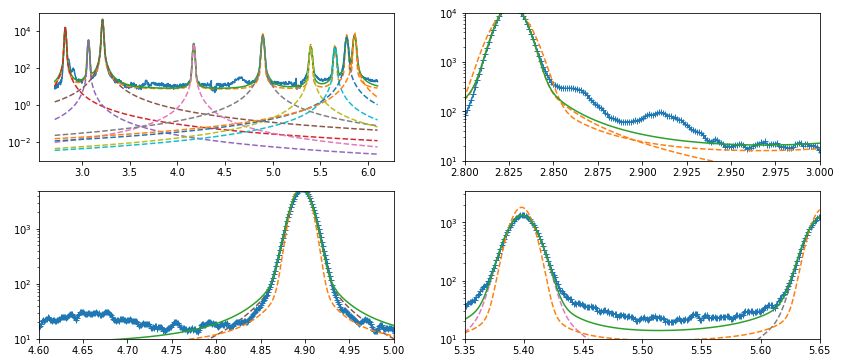

fitting frame:  00476 	 index:  48


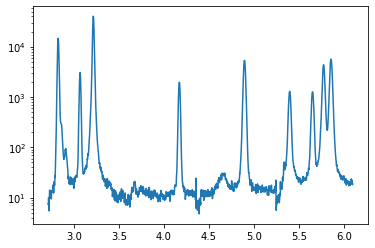


 fit after re-setting peak parameters


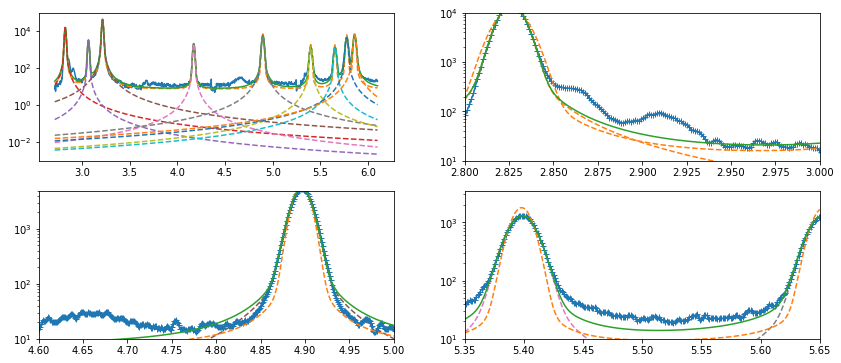

fitting frame:  00486 	 index:  49


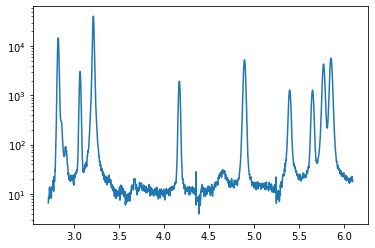


 fit after re-setting peak parameters


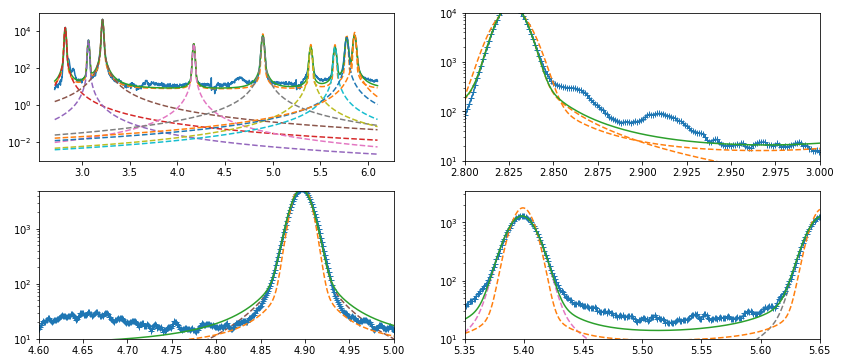

fitting frame:  00496 	 index:  50


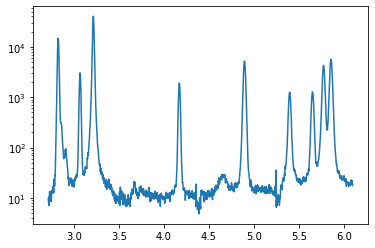


 fit after re-setting peak parameters


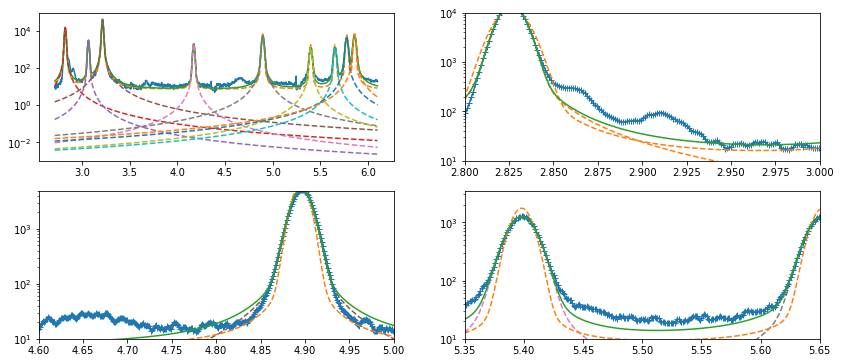

fitting frame:  00506 	 index:  51


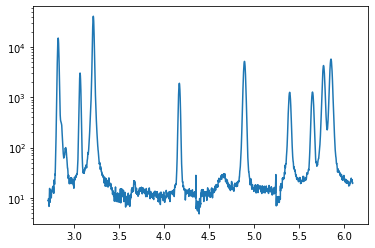


 fit after re-setting peak parameters


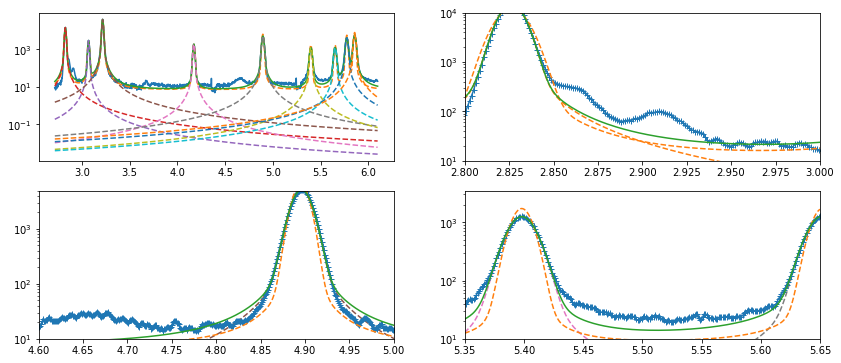

fitting frame:  00516 	 index:  52


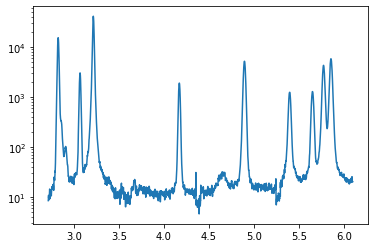


 fit after re-setting peak parameters


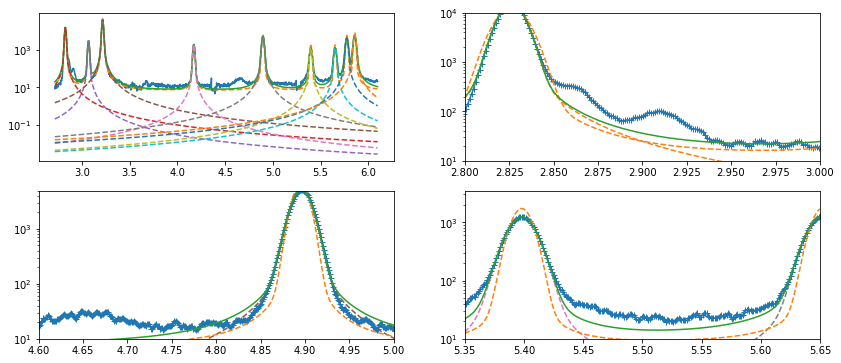

fitting frame:  00526 	 index:  53


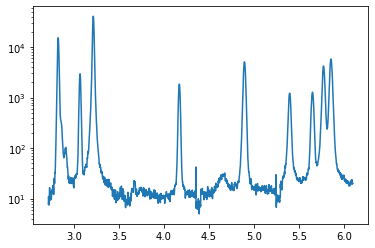


 fit after re-setting peak parameters


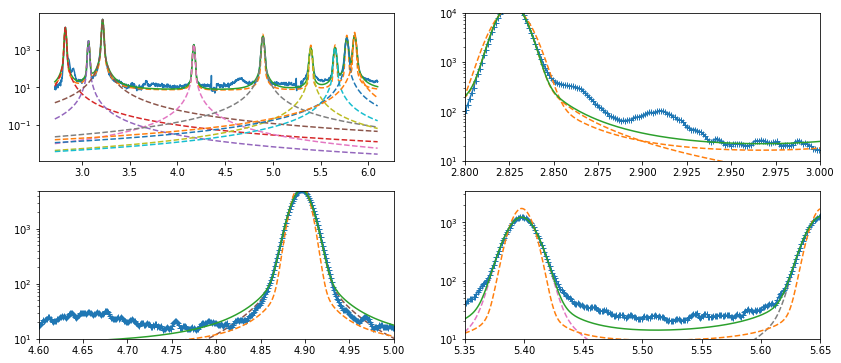

fitting frame:  00536 	 index:  54


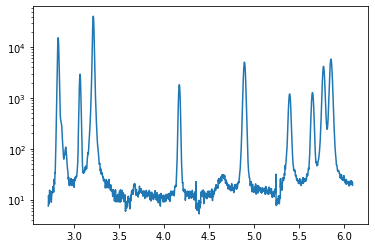


 fit after re-setting peak parameters


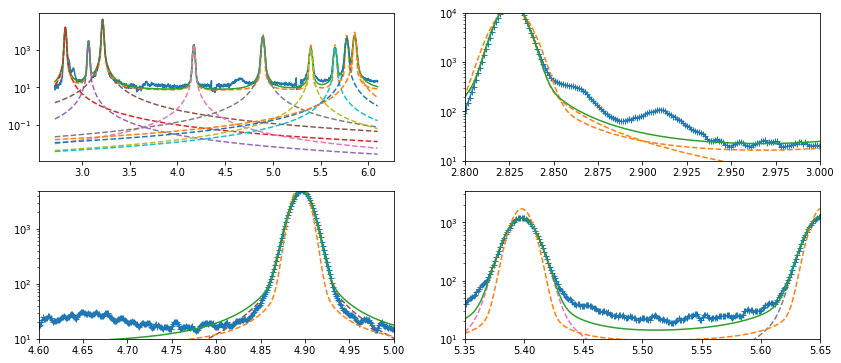

fitting frame:  00546 	 index:  55


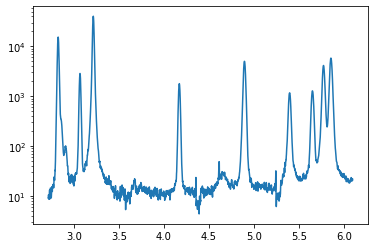


 fit after re-setting peak parameters


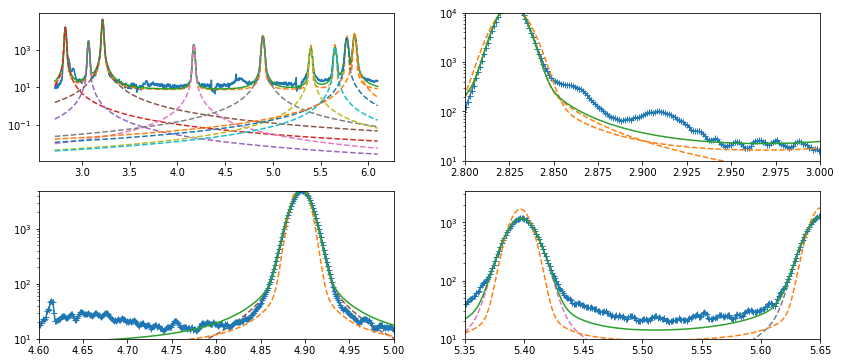

fitting frame:  00556 	 index:  56


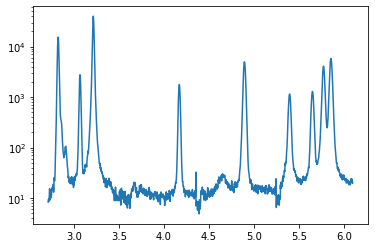


 fit after re-setting peak parameters


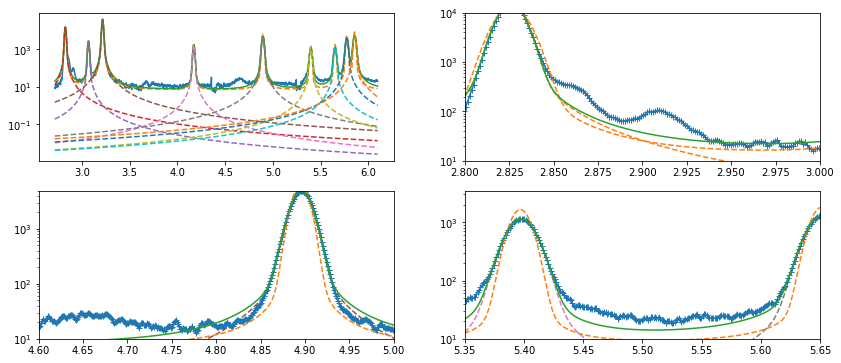

fitting frame:  00566 	 index:  57


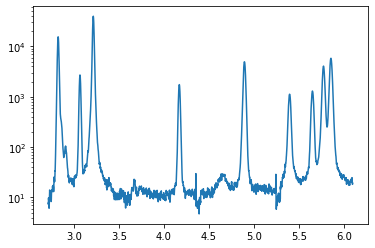


 fit after re-setting peak parameters


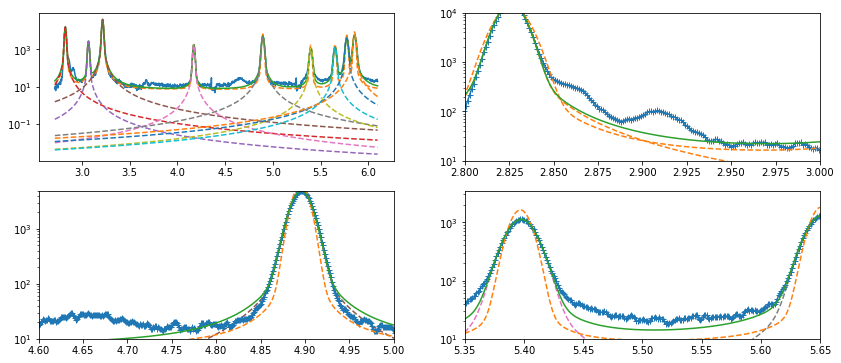

fitting frame:  00576 	 index:  58


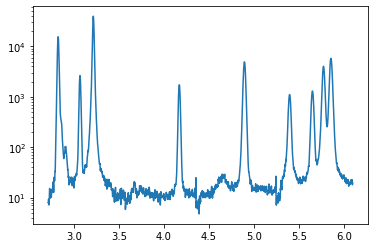


 fit after re-setting peak parameters


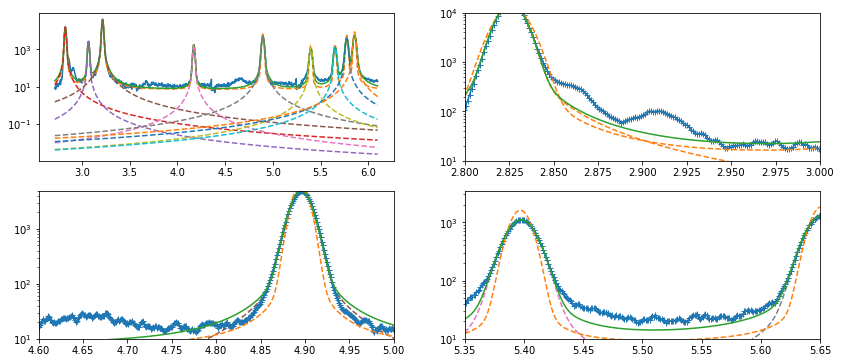

fitting frame:  00586 	 index:  59


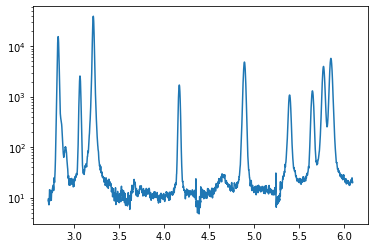


 fit after re-setting peak parameters


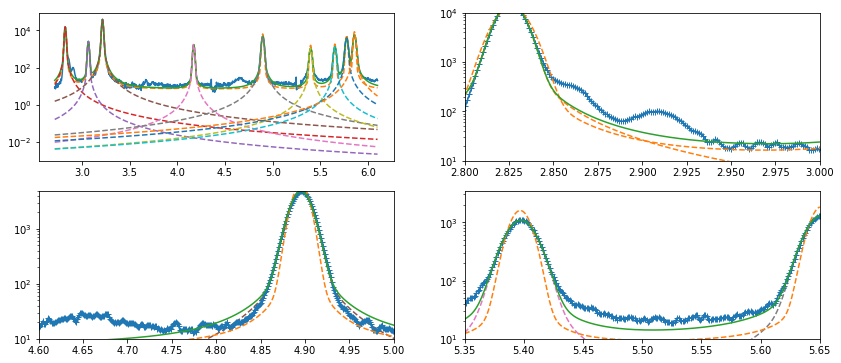

fitting frame:  00596 	 index:  60


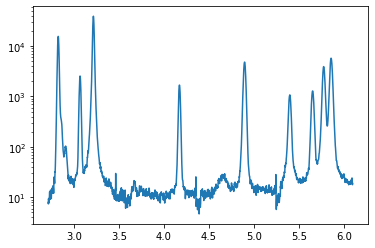


 fit after re-setting peak parameters


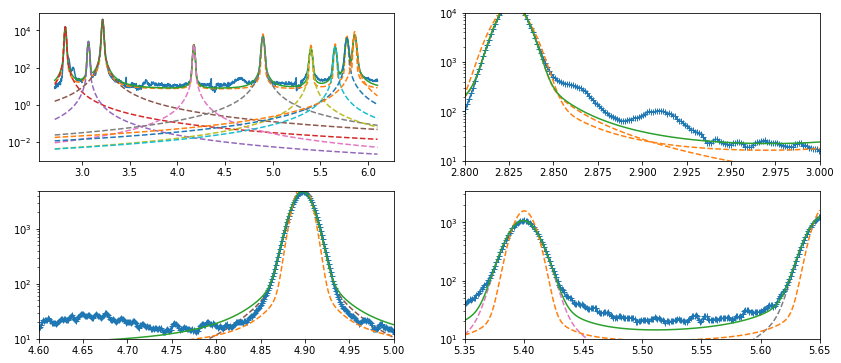

fitting frame:  00606 	 index:  61


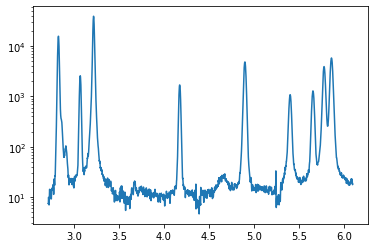


 fit after re-setting peak parameters


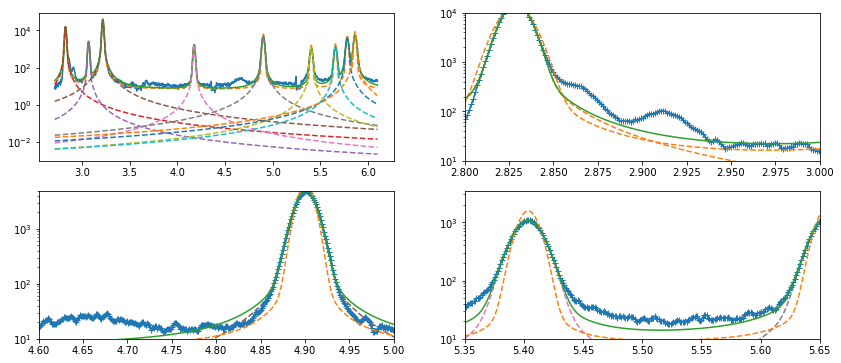

fitting frame:  00616 	 index:  62


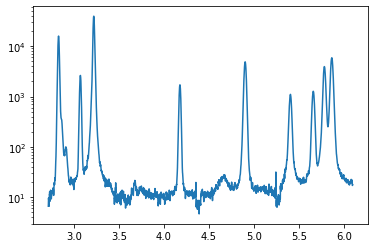


 fit after re-setting peak parameters


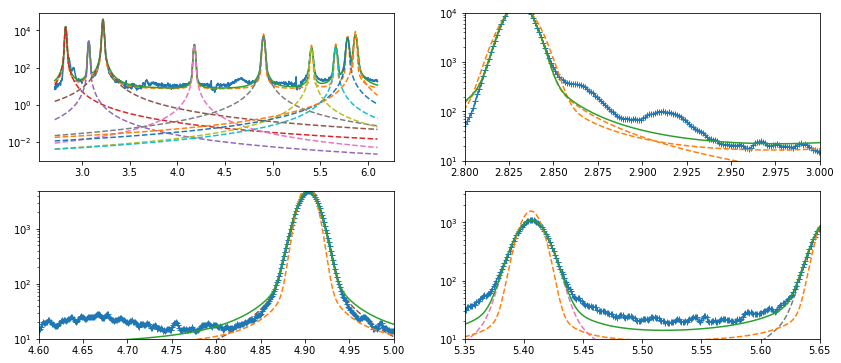

fitting frame:  00626 	 index:  63


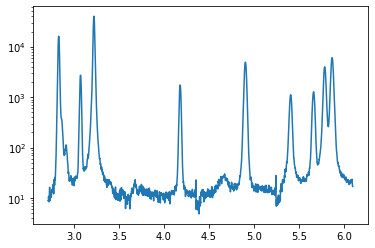


 fit after re-setting peak parameters


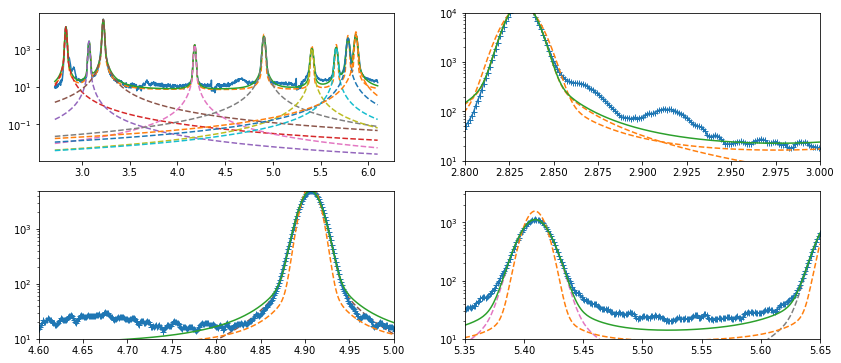

fitting frame:  00636 	 index:  64


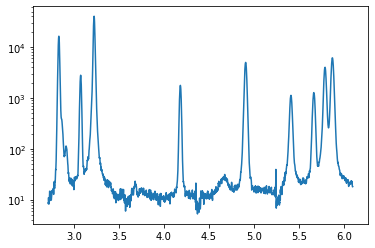


 fit after re-setting peak parameters


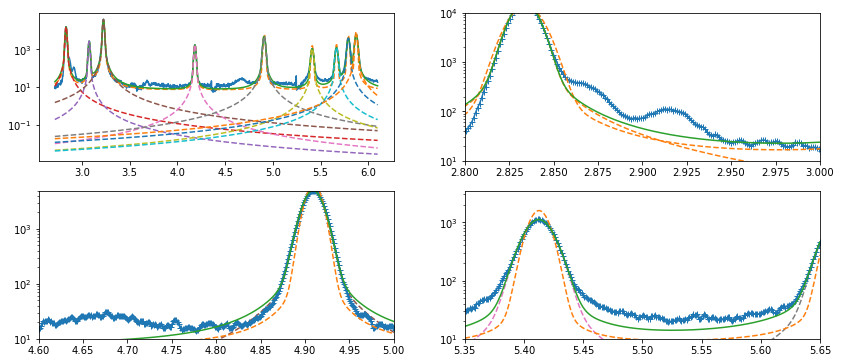

fitting frame:  00646 	 index:  65


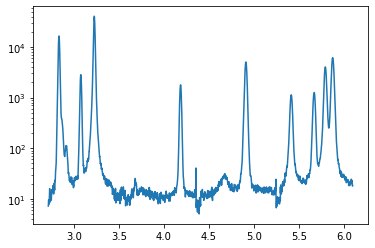


 fit after re-setting peak parameters


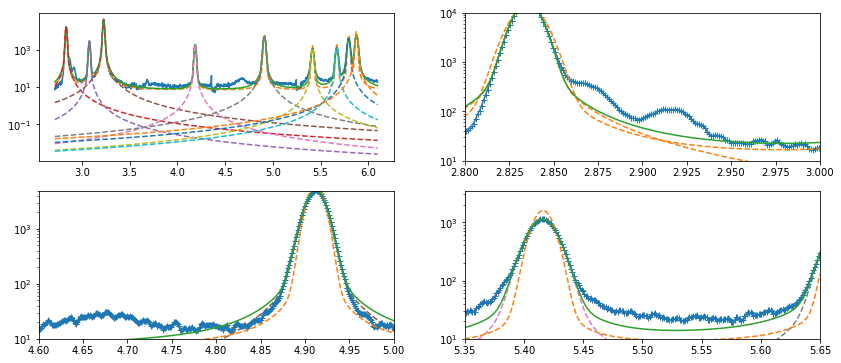

fitting frame:  00656 	 index:  66


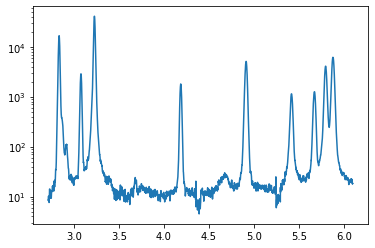


 fit after re-setting peak parameters


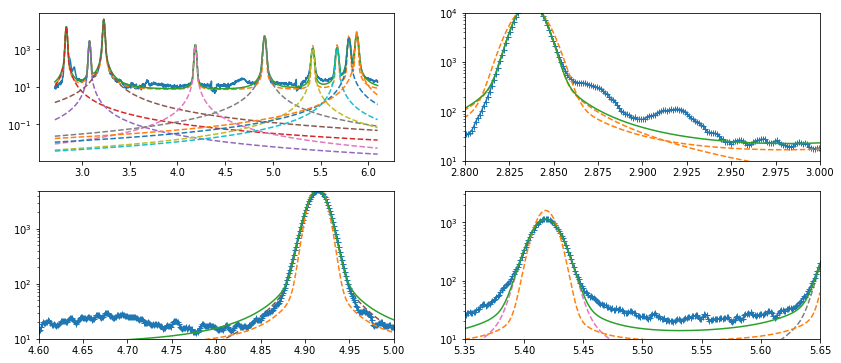

fitting frame:  00666 	 index:  67


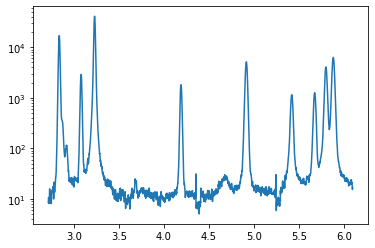


 fit after re-setting peak parameters


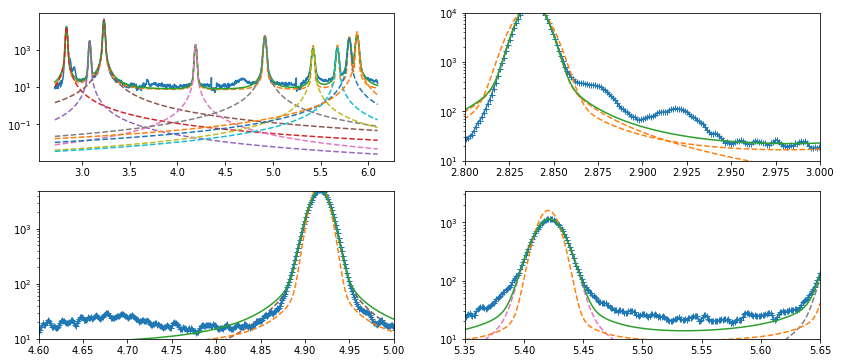

fitting frame:  00676 	 index:  68


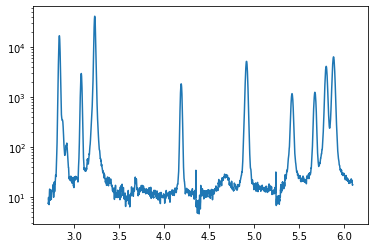


 fit after re-setting peak parameters


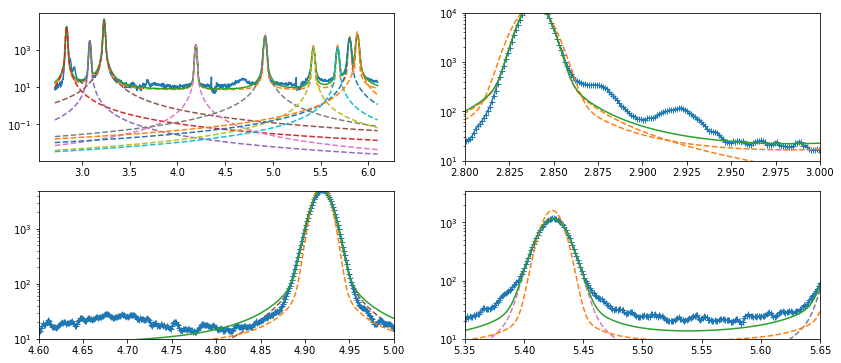

fitting frame:  00686 	 index:  69


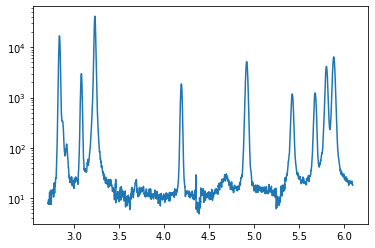


 fit after re-setting peak parameters


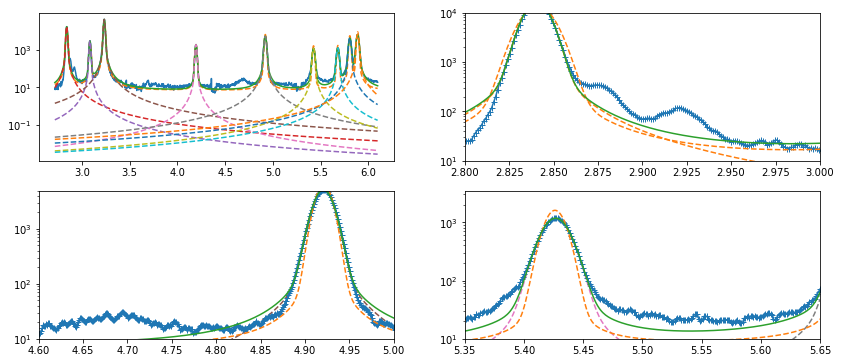

fitting frame:  00696 	 index:  70


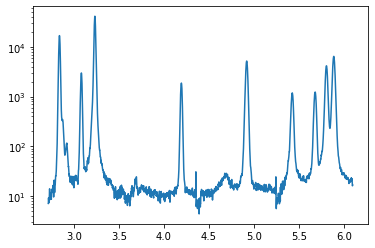


 fit after re-setting peak parameters


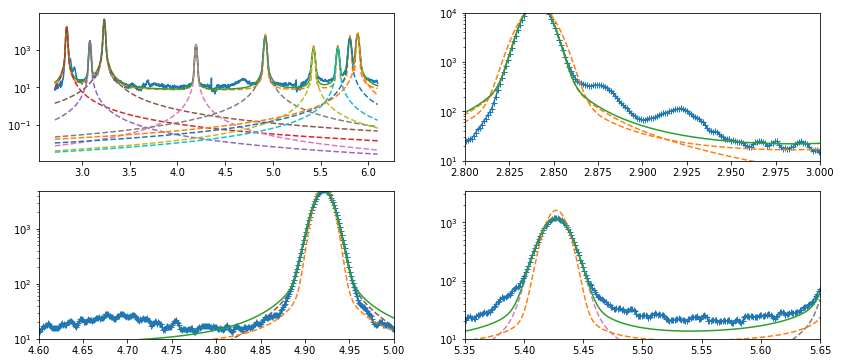

fitting frame:  00706 	 index:  71


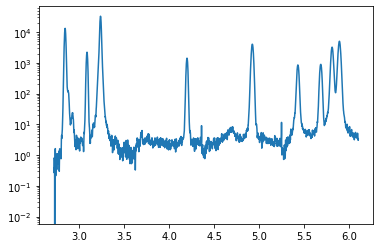


 fit after re-setting peak parameters


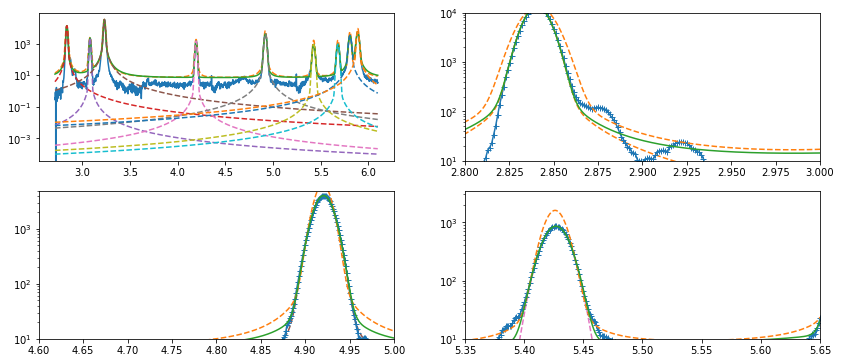

In [13]:
%matplotlib inline

for i, frame in enumerate(list(frames)[1:]): #  fit from next frame in list
    print("fitting frame: ", frame, "\t index: ", i+2)
    ### slice the data to the required twotheta range ###
    
    x = data[0][x_min:x_max]
    y = data[i+2][x_min:x_max]
    plt.plot(x, y)
    plt.yscale("log")
    plt.show()

    ### find all Zr peaks above threshold ###
    auto_peaks = list(auto_peak_selector(x, y, max_threshold))

    ### find zr peak center for indexed peak & set initial parameters ###
    for i, maxima in enumerate(auto_peaks):

        ### set initial parameter values
        # find peak max; find x position of maxima
        intensitys = [val[1] for val in maxima]
        max_y = max(intensitys)
#             print("max_y: ", max_y)
        ymax_twotheta = maxima[intensitys.index(max_y)][0]
        sigma = 0.01 # set sigma to known approximate value
        
        prefix = "pv" + str(i+1) + "_"
        previous_params[prefix + "center"].set(value=ymax_twotheta, min=ymax_twotheta-sigma, max=ymax_twotheta+sigma)
        previous_params[prefix + "sigma"].set(value=sigma, min=sigma/10, max=sigma*2)
        previous_params[prefix + "fraction"].set(value=0.1, min=0.01, max=0.2)

    ### perform fit with re-set parameters ###
    init = zr_model.eval(previous_params, x=x)
    out = zr_model.fit(y, previous_params, x=x, nan_policy='omit')
    comps = out.eval_components(x=x)
    print("\n fit after re-setting peak parameters")
    plot_results(x, y, init, out)
    
    ### update params ###
    previous_params = out.params
    
    ### add to dictionary ###
    zr_fits[str(frame)] = [out, init]
    
%matplotlib notebook

In [ ]:
### take a look at the lattice strains calculated from the peak centre positions ###

Zr_100_centers = []
Zr_xxx_centers = []

for key, var in zr_fits.items():
    if "pv1_center" in var[0].params:
        Zr_100_centers.append(var[0].params["pv1_center"].value)
    if "pv7_center" in var[0].params:
        Zr_xxx_centers.append(var[0].params["pv7_center"].value)

Zr_100_d_centers = [] 

for ttheta in Zr_100_centers:
    d = 0.141565 / (2*np.sin(np.deg2rad(ttheta)))
    Zr_100_d_centers.append(d)
    
Zr_xxx_d_centers = [] 

for ttheta in Zr_xxx_centers:
    d = 0.141565 / (2*np.sin(np.deg2rad(ttheta)))
    Zr_xxx_d_centers.append(d)

Zr_100_L0 = Zr_100_d_centers[0]
Zr_xxx_L0 = Zr_xxx_d_centers[0]
Zr_100_strain = []
Zr_xxx_strain = []

for Zr_100, Zr_xxx in zip(Zr_100_d_centers, Zr_xxx_d_centers):
    Zr_100_strain.append((Zr_100 - Zr_100_L0) / Zr_100_L0)
    Zr_xxx_strain.append((Zr_xxx - Zr_xxx_L0) / Zr_xxx_L0)

print(np.asarray(Zr_100_strain)*10**6)
print(np.asarray(Zr_xxx_strain)*10**6)

%matplotlib inline

plt.plot([int(x) for x in frames], np.asarray(Zr_100_strain)*10**6)
plt.plot([int(x) for x in frames], np.asarray(Zr_xxx_strain)*10**6)

# Add Hydrides

- Background is just a flat constant, can this be improved with CubicSpline? 
- Add hydride peaks (and SPP's?) 
- Update parameters to give the next fit good starting point. How to do this: 
    - Starting point is the "manual" first fit i.e. user has input good parameters
    - These parameters can be used as guess for the next fit
    - Parmeters can then be "updated" so that the parmeters are always one fit behind the data being fitted. With luck this will be enough to get a good fit.
    - For the peak centre the issue is that this only updates param.value NOT min & max
    - Min & Max values man be adjusted by an incremental amount based on the difference between the peak parameter value from the previous fit
    - This is not a terrible idea as long as the increments are not too far appart. In the elastic region where peak shifts are large, the increment will be large but as yield is reached this increment will drop. 

Problems:

- If no shift is detected, center, min & max will not change and fit will rapidly deterioate 
    - If no shift in the ZrH peak is detected, can anoter more reliable ZrH or Zr peak be used?
- If fit is bad the updated parameters become nonesense
    - Can parameters be given pre-defined criteria to meet
    - What can be done if criteria are not met?

In [14]:
### set zr parameters to parameters of first frame & fix ###
zr_params = list(zr_fits.values())[0][0].params
for param in zr_params:
    zr_params[param].set(vary=False)
    
### re-load first frame data ###
x = data[0][x_min:x_max]
y = data[1][x_min:x_max]

In [85]:
############################################################################################
### setup new parameters file and add Zr-Hydrides (and SPP's) so these vary ###
zrh_params = zr_params

ZrH_111d = PseudoVoigtModel(prefix='ZrH111d_')
zrh_params.update(ZrH_111d.make_params())
zrh_params['ZrH111d_center'].set(value=ZrH111d_min+(ZrH111d_max-ZrH111d_min)/2, min=ZrH111d_min, max=ZrH111d_max)
zrh_params["ZrH111d_sigma"].set(value = (ZrH111d_max-ZrH111d_min)/4, max=(ZrH111d_max-ZrH111d_min), min=(ZrH111d_max-ZrH111d_min)/10)
zrh_params['ZrH111d_amplitude'].set(min=0)
zrh_params["ZrH111d_fraction"].set(min=0.3, max=0.6)

ZrH_111g = PseudoVoigtModel(prefix='ZrH111g_')
zrh_params.update(ZrH_111g.make_params())
zrh_params['ZrH111g_center'].set(value=ZrH111g_min+(ZrH111g_max-ZrH111g_min)/2, min=ZrH111g_min, max=ZrH111g_max)
zrh_params["ZrH111g_sigma"].set(value = (ZrH111g_max-ZrH111g_min)/4, max=(ZrH111g_max-ZrH111g_min), min=(ZrH111g_max-ZrH111g_min)/10)
zrh_params['ZrH111g_amplitude'].set(min=0)
zrh_params["ZrH111g_fraction"].set(min=0.3, max=0.6)

# ZrH_200d = PseudoVoigtModel(prefix='ZrH200d_')
# zrh_params.update(ZrH_200d.make_params())
# zrh_params['ZrH200d_center'].set(value=ZrH200d_min+(ZrH200d_max-ZrH200d_min)/2, min=ZrH200d_min, max=ZrH200d_max)
# zrh_params["ZrH200d_sigma"].set(value = (ZrH200d_max-ZrH200d_min)/4, max=(ZrH200d_max-ZrH200d_min)/2, min=(ZrH200d_max-ZrH200d_min)/10)
# zrh_params['ZrH200d_amplitude'].set(min=0)
# zrh_params["ZrH200d_fraction"].set(min=0.3, max=0.6)

# ZrH_200g = PseudoVoigtModel(prefix='ZrH200g_')
# zrh_params.update(ZrH_200g.make_params())
# zrh_params['ZrH200g_center'].set(value=ZrH200g_min+(ZrH200g_max-ZrH200g_min)/2, min=ZrH200g_min, max=ZrH200g_max)
# zrh_params["ZrH200g_sigma"].set(value = (ZrH200g_max-ZrH200g_min)/4, max=(ZrH200g_max-ZrH200g_min)/2, min=(ZrH200g_max-ZrH200g_min)/10)
# zrh_params['ZrH200g_amplitude'].set(min=0)
# zrh_params["ZrH200g_fraction"].set(min=0.3, max=0.6)

# ZrH_220d = PseudoVoigtModel(prefix='ZrH220d_')
# zrh_params.update(ZrH_220d.make_params())
# zrh_params['ZrH220d_center'].set(value=ZrH220a_min+(ZrH220a_max-ZrH220a_min)/2, min=ZrH220a_min, max=ZrH220a_max)
# zrh_params["ZrH220d_sigma"].set(value = (ZrH220a_max-ZrH220a_min)/4, max=(ZrH220a_max-ZrH220a_min), min=(ZrH220a_max-ZrH220a_min)/10)
# zrh_params['ZrH220d_amplitude'].set(min=0)
# zrh_params["ZrH220d_fraction"].set(min=0.3, max=0.6)

# ZrH_220g = PseudoVoigtModel(prefix='ZrH_220g_')
# zrh_params.update(ZrH_220g.make_params())
# zrh_params['ZrH_220g_center'].set(value=ZrH220b_min+(ZrH220b_max-ZrH220b_min)/2, min=ZrH220b_min, max=ZrH220b_max)
# zrh_params["ZrH_220g_sigma"].set(value = (ZrH220b_max-ZrH220b_min)/4, max=(ZrH220b_max-ZrH220b_min), min=(ZrH220b_max-ZrH220b_min)/10)
# zrh_params['ZrH_220g_amplitude'].set(min=0)
# zrh_params["ZrH_220g_fraction"].set(min=0.3, max=0.6)

# ZrH_311 = PseudoVoigtModel(prefix='ZrH311_')
# zrh_params.update(ZrH_311.make_params())
# zrh_params['ZrH311_center'].set(value=ZrH311_min+(ZrH311_max-ZrH311_min)/2, min=ZrH311_min, max=ZrH311_max)
# zrh_params["ZrH311_sigma"].set(value = (ZrH311_max-ZrH311_min)/4, max=(ZrH311_max-ZrH311_min), min=(ZrH311_max-ZrH311_min)/10)
# zrh_params['ZrH311_amplitude'].set(min=0)
# zrh_params["ZrH311_fraction"].set(min=0.3, max=0.6)

# SPP1 = PseudoVoigtModel(prefix='SPP1_')
# zrh_params.update(SPP1.make_params())
# zrh_params['SPP1_center'].set(value=SPP1_min+(SPP1_max-SPP1_min)/2, min=SPP1_min, max=SPP1_max)
# zrh_params["SPP1_sigma"].set(value = (SPP1_max-SPP1_min)/4, max=(SPP1_max-SPP1_min), min=(SPP1_max-SPP1_min)/10)
# zrh_params['SPP1_amplitude'].set(min=0)
# zrh_params["SPP1_fraction"].set(min=0.3, max=0.8)

# SPP2 = PseudoVoigtModel(prefix='SPP2_')
# zrh_params.update(SPP2.make_params())
# zrh_params['SPP2_center'].set(value=SPP2_min+(SPP2_max-SPP2_min)/2, min=SPP2_min, max=SPP2_max)
# zrh_params["SPP2_sigma"].set(value=(SPP2_max-SPP2_min)/4, max=(SPP2_max-SPP2_min), min=(SPP2_max-SPP2_min)/10)
# zrh_params['SPP2_amplitude'].set(min=0)
# zrh_params["SPP2_fraction"].set(min=0.3, max=0.8)

ZrFeCr = PseudoVoigtModel(prefix='ZrFeCr_')
zrh_params.update(ZrFeCr.make_params())
zrh_params['ZrFeCr_center'].set(value=ZrFeCr_min+(ZrFeCr_max-ZrFeCr_min)/2, min=ZrFeCr_min, max=ZrFeCr_max)
zrh_params["ZrFeCr_sigma"].set(value=(ZrFeCr_max-ZrFeCr_min)/4, max=(ZrFeCr_max-ZrFeCr_min), min=(ZrFeCr_max-ZrFeCr_min)/10)
zrh_params['ZrFeCr_amplitude'].set(min=0)
zrh_params["ZrFeCr_fraction"].set(min=0.3, max=0.8)

# ###########################################################################################

### make composite model with background & Zr peak parameteres fixed ###
# comp_model = Zr_model + ZrH_111d + ZrH_111g + ZrFeCr + ZrH_200d + SPP1 + SPP2 + ZrH_220d + ZrH_220g + ZrH_311 # + ZrH_200g

comp_model = zr_model + ZrH_111d + ZrH_111g + ZrFeCr 

In [ ]:
### rough fit for hydride peaks ###
comp_init = comp_model.eval(zrh_params, x=x)
comp_out = comp_model.fit(y, zrh_params, x=x, nan_policy='omit')
comp_comps = comp_out.eval_components(x=x)

In [ ]:
# print(comp_out.fit_report())

In [ ]:
# print(comp_out.params.pretty_print())
%matplotlib notebook
%matplotlib notebook
import matplotlib as plt

interactive_plot_results(x, y, comp_init, comp_out)

In [ ]:
interactive_plot_results(x, data[1][x_min:x_max], list(zr_fits.values())[0][1], list(zr_fits.values())[0][0])

In [ ]:
%matplotlib inline 

for i, model_result in enumerate(zr_fits.values()): #  fit from beginning
    x = data[0][x_min:x_max]
    y = data[i+1][x_min:x_max]
    plot_results(x, y, model_result[1], model_result[0])

In [ ]:
list(zr_fits.values())[0][0].params["pv1_center"].value

In [ ]:
### handy reminder of how to access all parameters for a fit ###

for component in list(zr_fits.values())[0][0].components:
    print(component._param_names)

# Load ESRF data ###

In [16]:
### load ESRF data ###
fname = r"C:\Users\mbgnwob2\Documents\GitHub\ESRF_xrdfit_analysis\Lattice_strains\Zr4_RXA_WQ_2_3B.csv"
rfit_fname = r"C:\Users\mbgnwob2\Documents\GitHub\ESRF_xrdfit_analysis\Lattice_strains\Zr4_RXA_WQ_2_3B_Rfit.csv"
Zr4_RXA_WQ_2_3B = pd.read_csv(fname).iloc[:,1:]
Zr4_RXA_WQ_2_3B_rfit = pd.read_csv(rfit_fname).iloc[:,1:]

eng_strains = list(Zr4_RXA_WQ_2_3B["Engineering Strain"])
r_eng_strains = list(Zr4_RXA_WQ_2_3B_rfit["Engineering Strain"])

In [49]:
# Zr4_RXA_WQ_2_3B
Zr4_RXA_WQ_2_3B_rfit

,Frame,Engineering Strain,(10-10),d(111),g(111),(0002),(10-11)
0,742,7.748650,0.004346,0.013715,0.010141,0.004862,0.004180
1,706,7.339702,0.004301,0.013519,0.010083,0.004796,0.004155
2,670,6.930754,0.004255,0.013296,0.009992,0.004735,0.004130
3,634,6.530961,0.004215,0.013154,0.009880,0.004679,0.004114
4,597,6.109806,0.004166,0.012891,0.009721,0.004613,0.004099
5,561,5.703909,0.004118,0.012617,0.009616,0.004558,0.004085
6,525,5.319376,0.004065,0.012324,0.009488,0.004494,0.004059
7,489,4.915006,0.004011,0.011985,0.009340,0.004428,0.004025
8,453,4.509110,0.003939,0.011567,0.009238,0.004368,0.003975
9,417,4.104740,0.003860,0.011067,0.009127,0.004333,0.003926


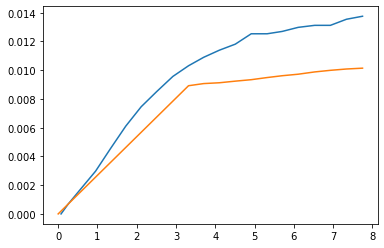

In [61]:
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize=(6,4))

g111_e_strains = list(Zr4_RXA_WQ_2_3B_rfit["Engineering Strain"][:12]) + [0]
g111_L_strains = list(Zr4_RXA_WQ_2_3B_rfit["g(111)"][:12]) + [0]

ax.plot(Zr4_RXA_WQ_2_3B["Engineering Strain"],Zr4_RXA_WQ_2_3B["d(111)"])
ax.plot(g111_e_strains, g111_L_strains)

In [17]:
### get engineering strain data for experiment

# Define paths
data_dir = r'Z:\Diamond_MG28894-1_DATA_BACKUP\rawdata'

with open('Diamond_experiments.pkl', 'rb') as f:
    Samples = pickle.load(f)
    
experiment_scanIDs = sorted([str(value[0]) for value in Samples.values() if value[0] != None])
experiment_keys = sorted(key for key in Samples.keys())

drop_down = Dropdown(options=experiment_keys, value=experiment_keys[0], description='scanID:', disabled=False, 
                             layout=Layout(width='40%'), style={'description_width': 'initial'})

def dropdown_handler(change):
    global scanID
    scanID = change.new
    scanID = str(Samples[scanID][0])
drop_down.observe(dropdown_handler, names='value')
display(drop_down)

Dropdown(description='scanID:', layout=Layout(width='40%'), options=('PuerZr_WQ_400_1mm_#1', 'PuerZr_WQ_400_1m…

In [18]:
### get metadata ###
from nexusformat.nexus import *
fname = data_dir + "\\" + scanID + ".nxs"
metadata = nxload(fname)
# print(metadata.tree)

load = metadata.entry1.instrument.adc01_06.adc01_06
pos = metadata.entry1.instrument.adc01_07.adc01_07
temp = metadata.entry1.instrument.adc01_08.adc01_08

In [19]:
# convert load to stress & position to strain

x_section = 1.8796
stress = np.array(load)*x_section
eng_strain = (np.array(pos)-np.array(pos)[0])/np.array(pos)[0]

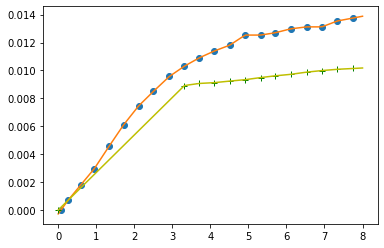

In [64]:
# Will interpolation work?

x_eng=Zr4_RXA_WQ_2_3B["Engineering Strain"]
y_d111=Zr4_RXA_WQ_2_3B["d(111)"]

x_eng_r = g111_e_strains
y_g111 = g111_L_strains

d111_interp = interp1d(x_eng,y_d111, fill_value="extrapolate")
g111_interp = interp1d(x_eng_r,y_g111, fill_value="extrapolate")
d111_new = np.linspace(0,8,100)
g111_new = np.linspace(0,8,100)

plt.plot(x_eng, y_d111, 'o', d111_new, d111_interp(d111_new), '-', x_eng_r, y_g111, "+g", g111_new, g111_interp(g111_new), "-y")

In [77]:
interps_dict = {"ZrH111d_guess": d111_interp, 
               "ZrH111g_guess": g111_interp}

In [22]:
def twotheta_to_d(twotheta, wavelength):
    '''
    d: angstroms
    wavelength: angstroms
    '''
    return wavelength / (2*np.sin(np.deg2rad(twotheta)))

def d_to_twotheta(d, wavelength):
    '''
    d: angstroms
    wavelength: angstroms
    '''
    two_theta = 0
    if d>0: 
        two_theta = np.degrees(np.arcsin(wavelength/(2*d)))
    return two_theta

In [82]:
for param  in zrh_params:
    if "center" in param and "pv" not in param and "bg" not in param and "ZrFeCr" not in param:
        dict_key = param.split("_")[0] + "_guess"
        print(interps_dict[dict_key])

fitting frame:  00006 	 index:  1
ZrH111d_center 2.90 2.88 2.91
ZrH111g_center 2.93 2.92 2.95


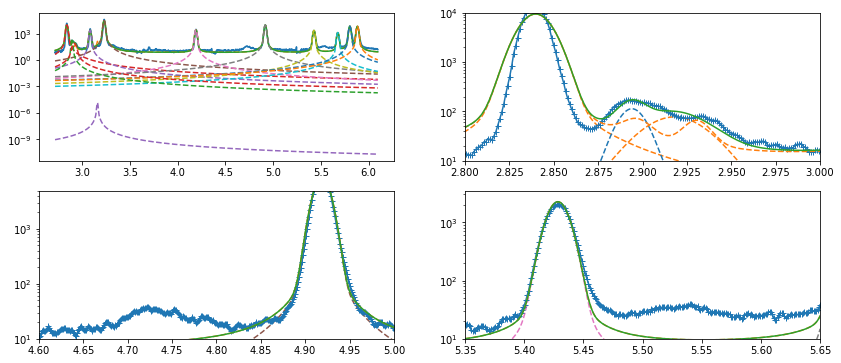

fitting frame:  00016 	 index:  2
ZrH111d_center 2.90 2.88 2.91
ZrH111g_center 2.93 2.92 2.95


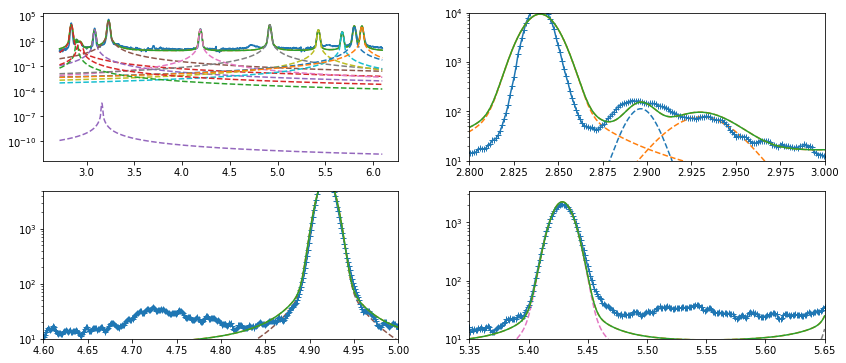

fitting frame:  00026 	 index:  3
ZrH111d_center 2.90 2.88 2.91
ZrH111g_center 2.93 2.92 2.95


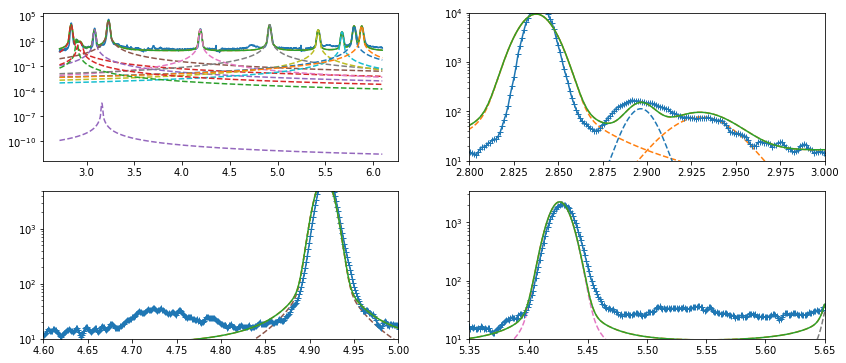

fitting frame:  00036 	 index:  4
ZrH111d_center 2.90 2.88 2.91
ZrH111g_center 2.93 2.91 2.94


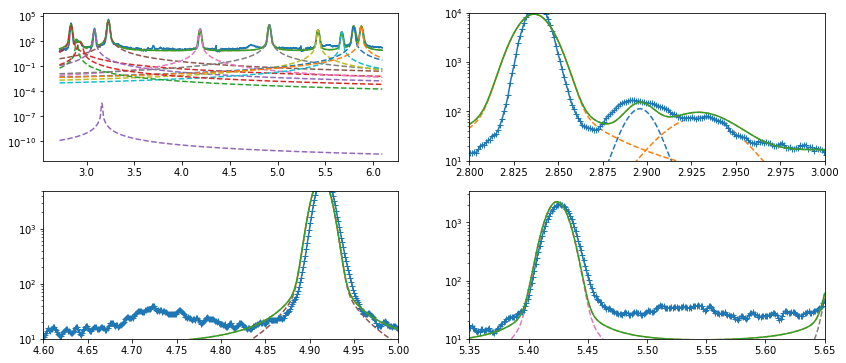

fitting frame:  00046 	 index:  5
ZrH111d_center 2.89 2.88 2.91
ZrH111g_center 2.93 2.91 2.94


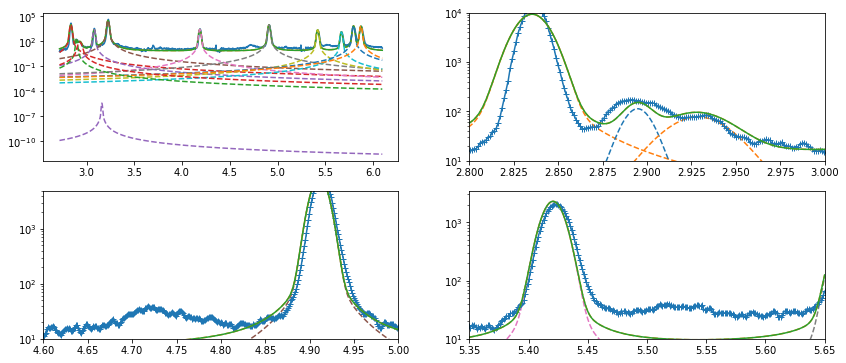

fitting frame:  00056 	 index:  6
ZrH111d_center 2.89 2.88 2.91
ZrH111g_center 2.93 2.91 2.94


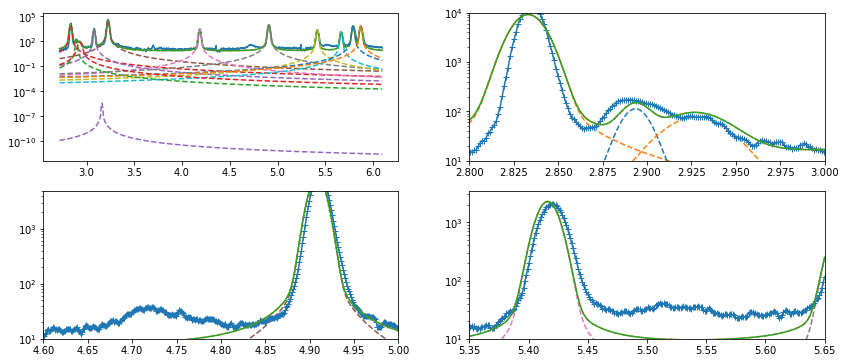

fitting frame:  00066 	 index:  7
ZrH111d_center 2.89 2.88 2.91
ZrH111g_center 2.93 2.91 2.94


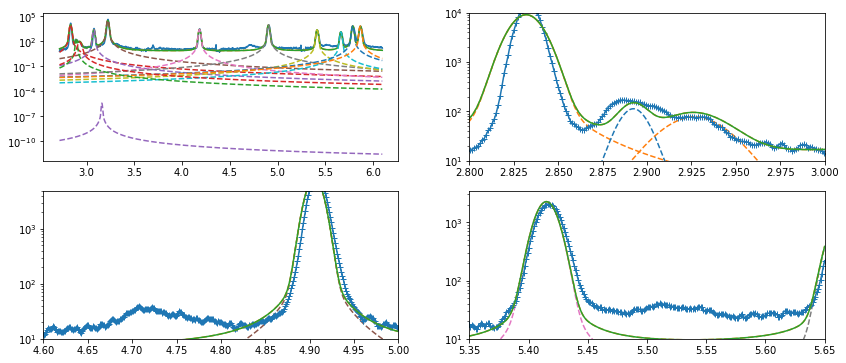

fitting frame:  00076 	 index:  8
ZrH111d_center 2.89 2.88 2.91
ZrH111g_center 2.93 2.91 2.94


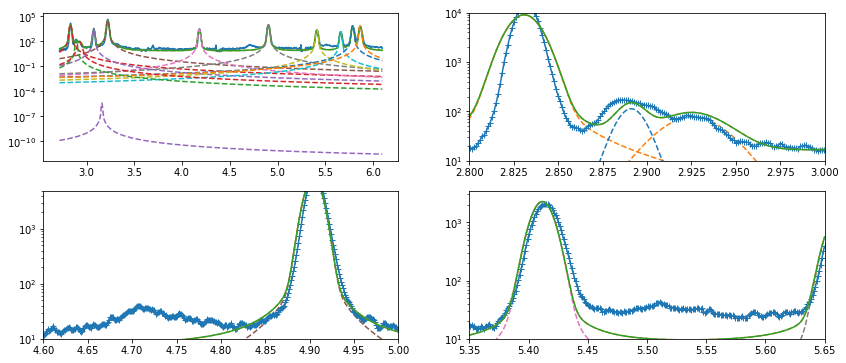

fitting frame:  00086 	 index:  9
ZrH111d_center 2.89 2.87 2.90
ZrH111g_center 2.92 2.91 2.94


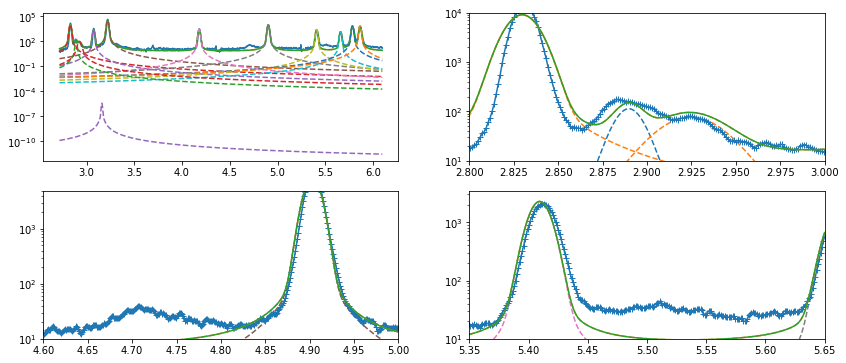

fitting frame:  00096 	 index:  10
ZrH111d_center 2.89 2.87 2.90
ZrH111g_center 2.92 2.91 2.94


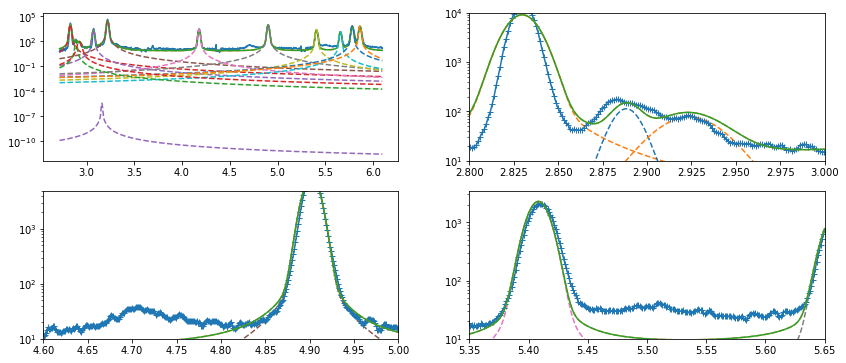

fitting frame:  00106 	 index:  11
ZrH111d_center 2.89 2.87 2.90
ZrH111g_center 2.92 2.91 2.94


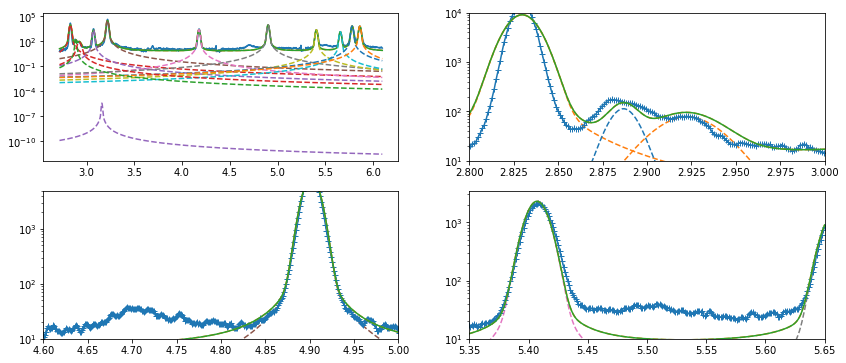

fitting frame:  00116 	 index:  12
ZrH111d_center 2.89 2.87 2.90
ZrH111g_center 2.92 2.91 2.94


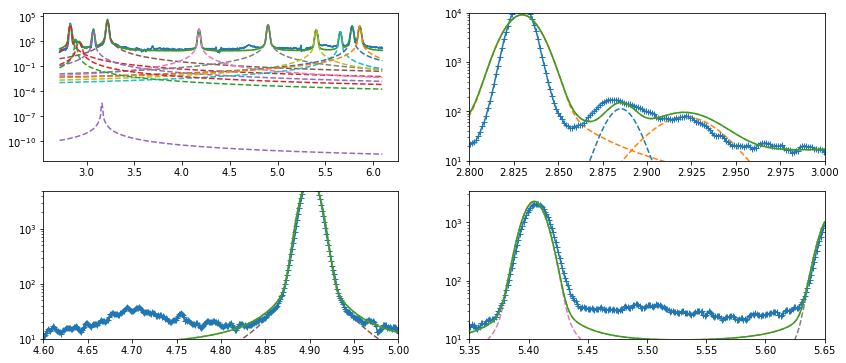

fitting frame:  00126 	 index:  13
ZrH111d_center 2.88 2.87 2.90
ZrH111g_center 2.92 2.91 2.94


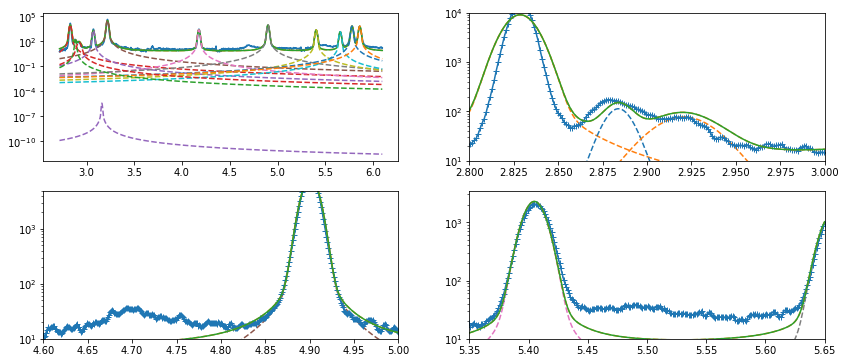

fitting frame:  00136 	 index:  14
ZrH111d_center 2.88 2.87 2.90
ZrH111g_center 2.92 2.90 2.93


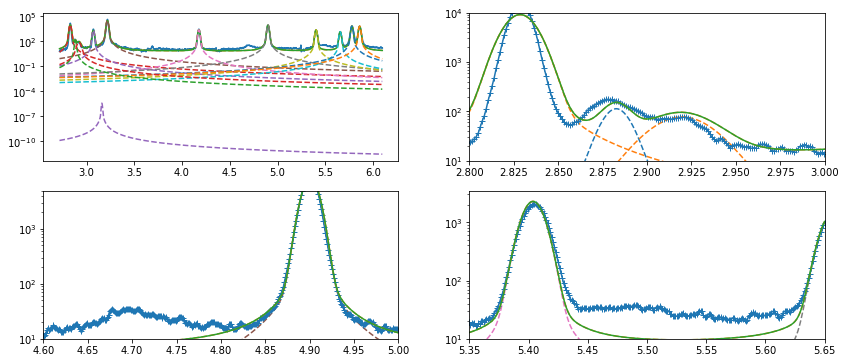

fitting frame:  00146 	 index:  15
ZrH111d_center 2.88 2.87 2.90
ZrH111g_center 2.92 2.90 2.93


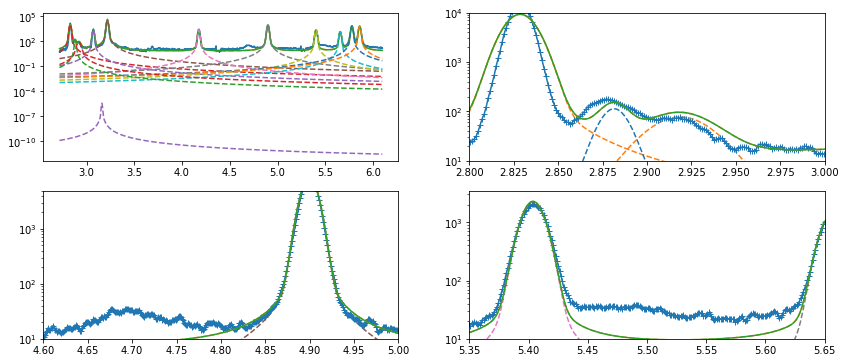

fitting frame:  00156 	 index:  16
ZrH111d_center 2.88 2.87 2.90
ZrH111g_center 2.92 2.90 2.93


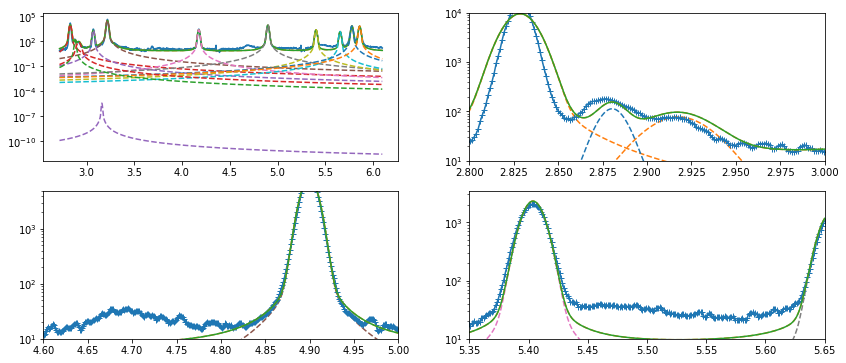

fitting frame:  00166 	 index:  17
ZrH111d_center 2.88 2.86 2.89
ZrH111g_center 2.92 2.90 2.93


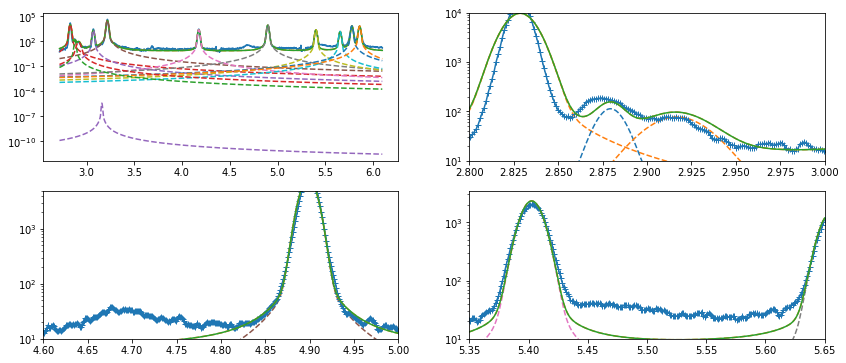

fitting frame:  00176 	 index:  18
ZrH111d_center 2.88 2.86 2.89
ZrH111g_center 2.92 2.90 2.93


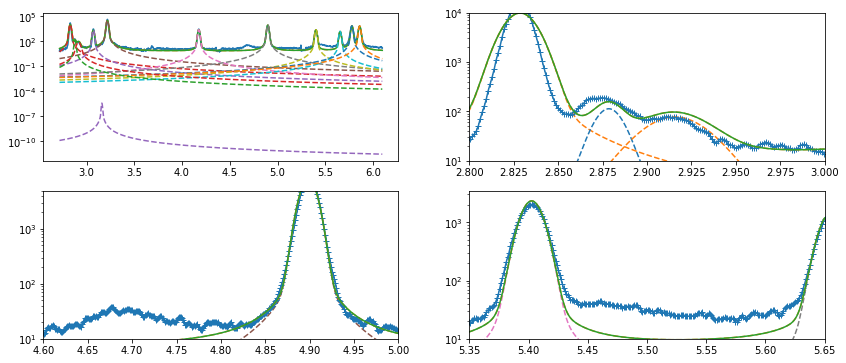

fitting frame:  00186 	 index:  19
ZrH111d_center 2.88 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


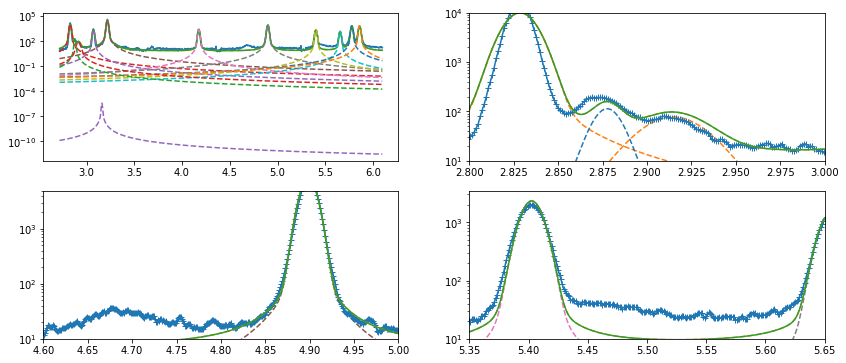

fitting frame:  00196 	 index:  20
ZrH111d_center 2.88 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


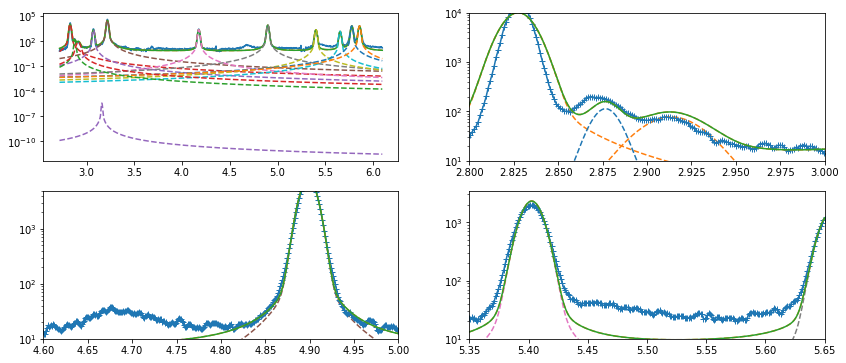

fitting frame:  00206 	 index:  21
ZrH111d_center 2.88 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


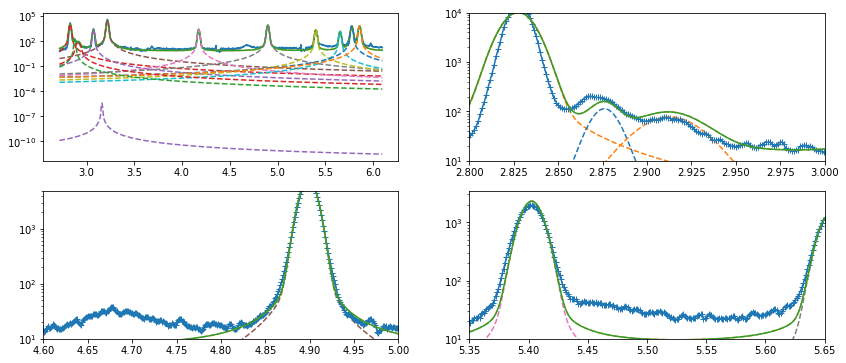

fitting frame:  00216 	 index:  22
ZrH111d_center 2.88 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


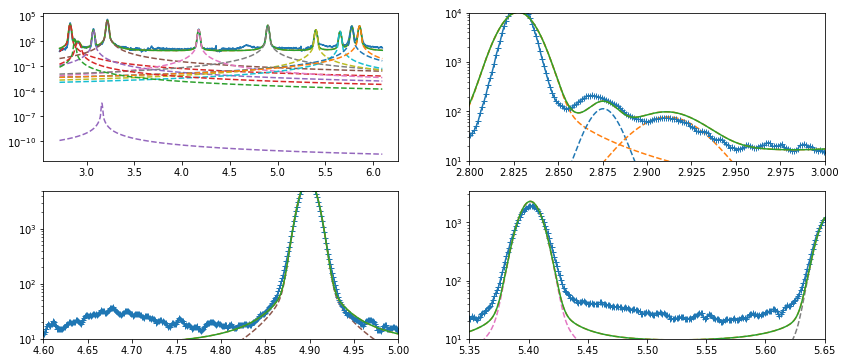

fitting frame:  00226 	 index:  23
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


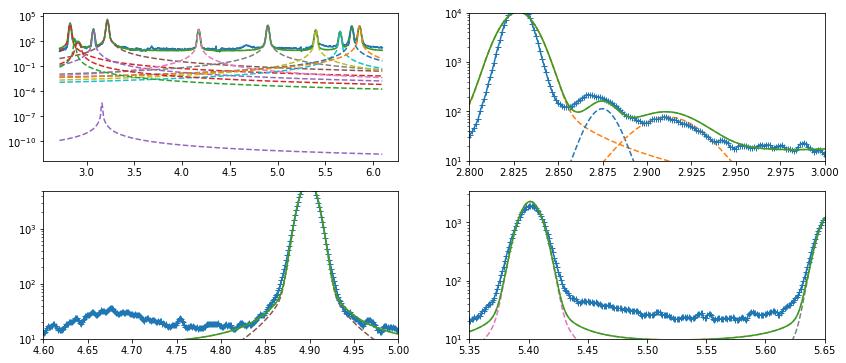

fitting frame:  00236 	 index:  24
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


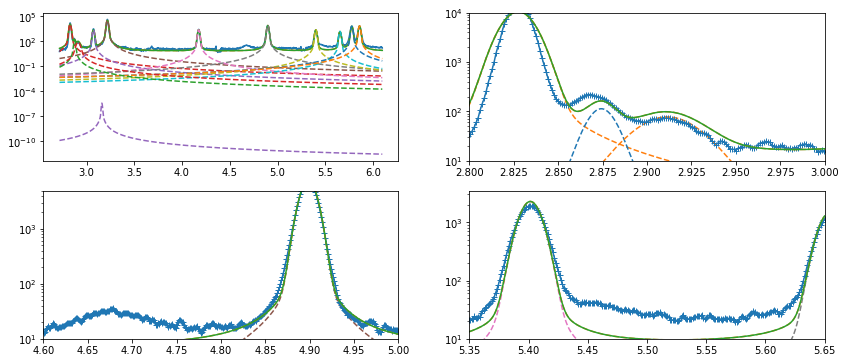

fitting frame:  00246 	 index:  25
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


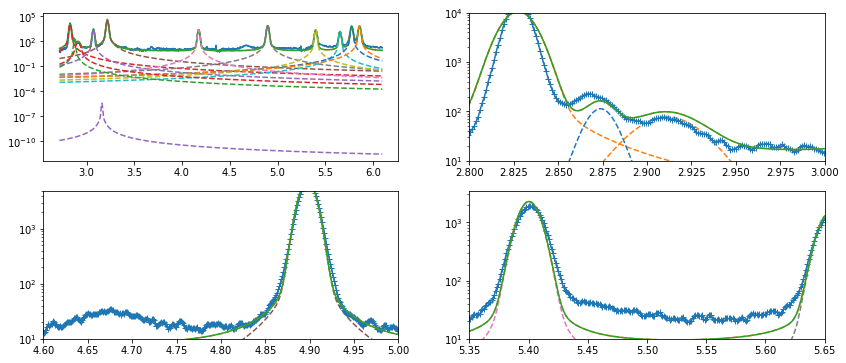

fitting frame:  00256 	 index:  26
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


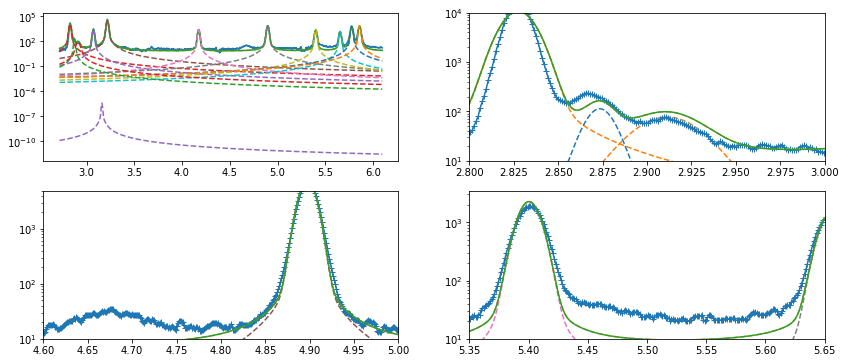

fitting frame:  00266 	 index:  27
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


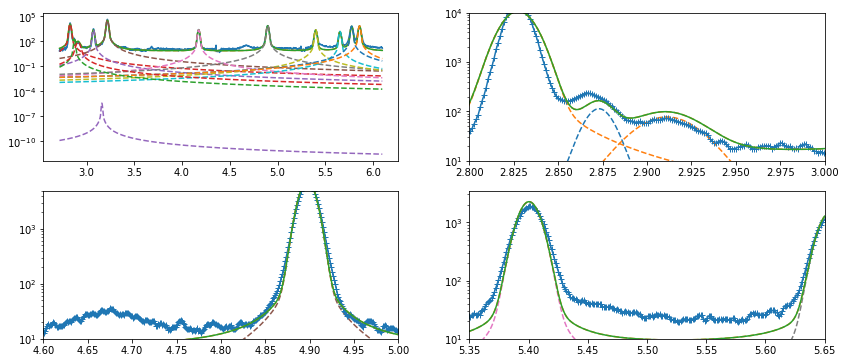

fitting frame:  00276 	 index:  28
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


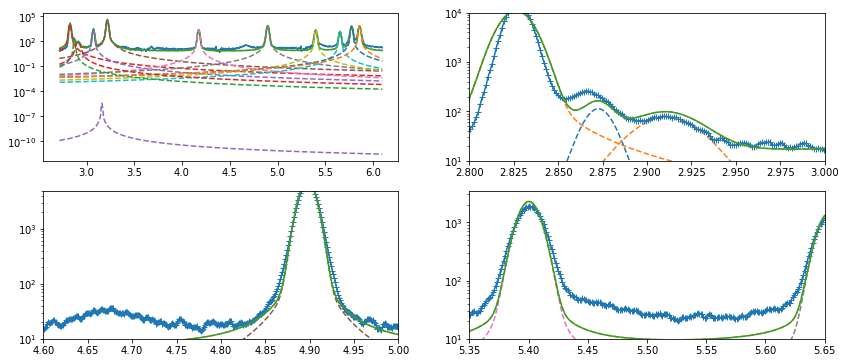

fitting frame:  00286 	 index:  29
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


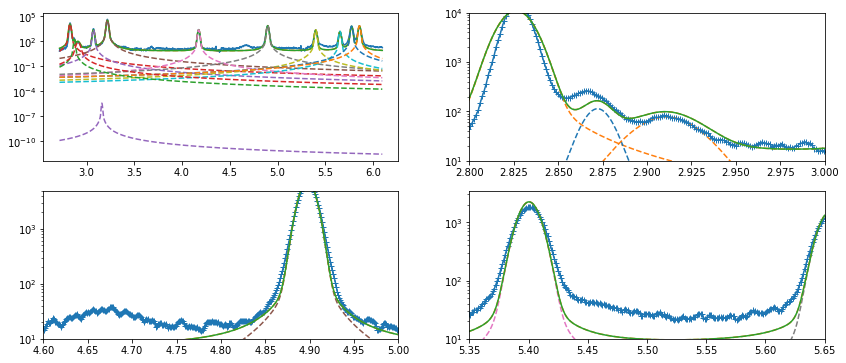

fitting frame:  00296 	 index:  30
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


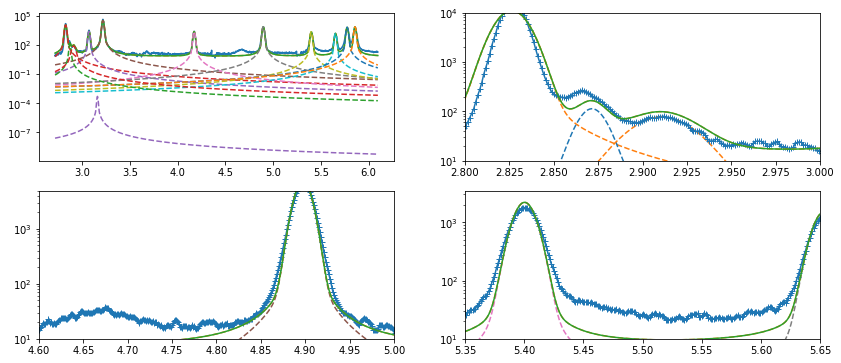

fitting frame:  00306 	 index:  31
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


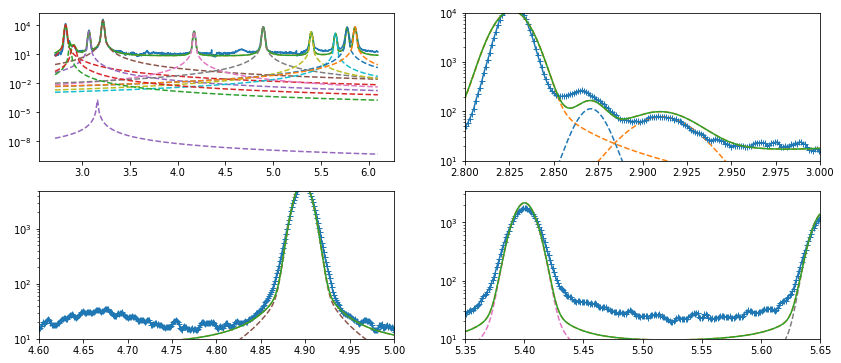

fitting frame:  00316 	 index:  32
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


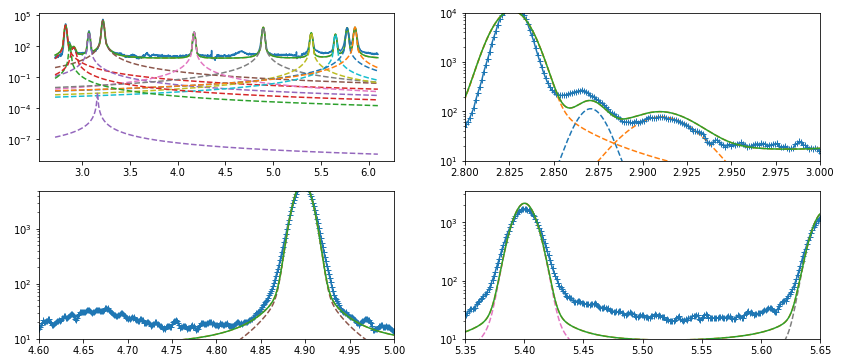

fitting frame:  00326 	 index:  33
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


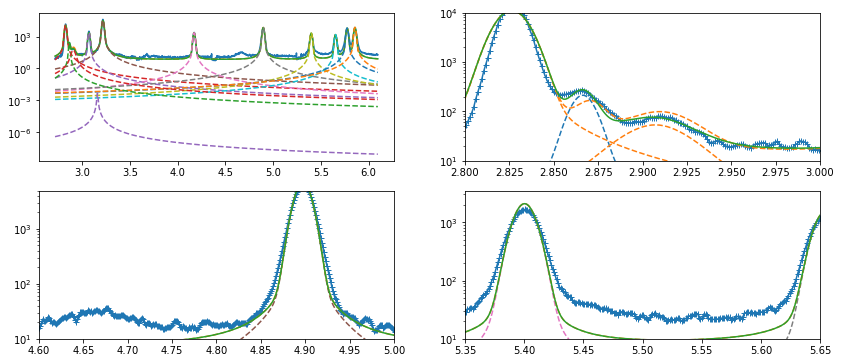

fitting frame:  00336 	 index:  34
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


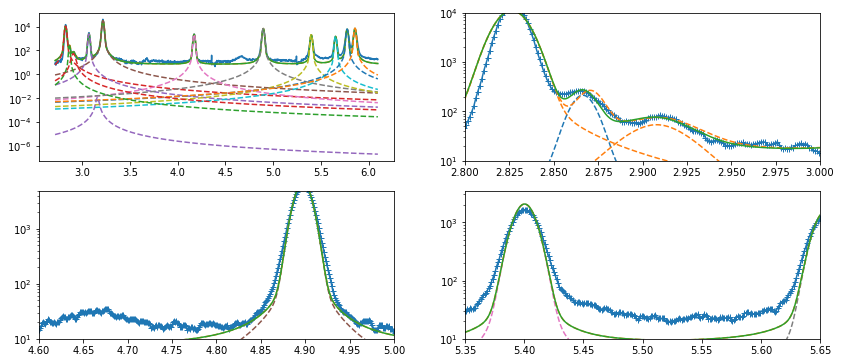

fitting frame:  00346 	 index:  35
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


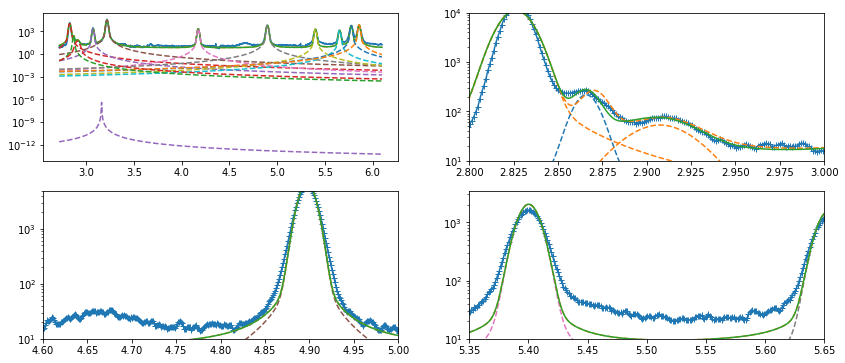

fitting frame:  00356 	 index:  36
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


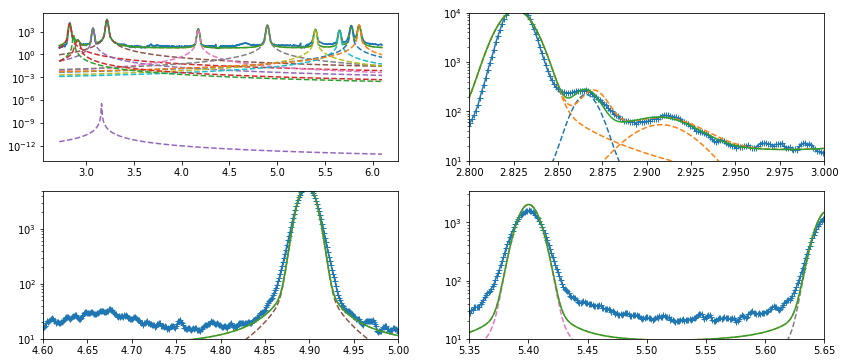

fitting frame:  00366 	 index:  37
ZrH111d_center 2.87 2.86 2.89
ZrH111g_center 2.91 2.90 2.93


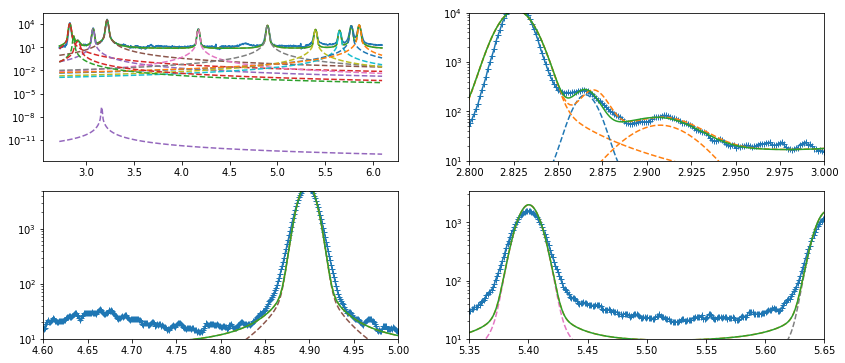

fitting frame:  00376 	 index:  38
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.90 2.93


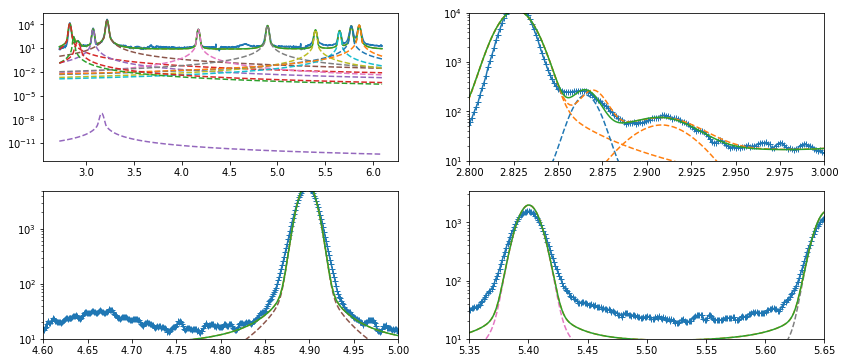

fitting frame:  00386 	 index:  39
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


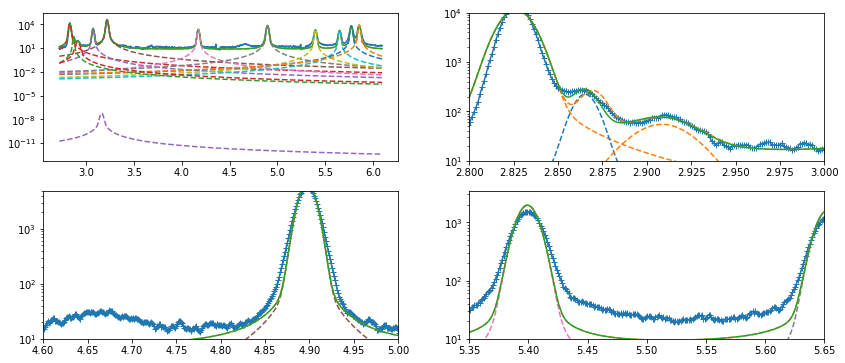

fitting frame:  00396 	 index:  40
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


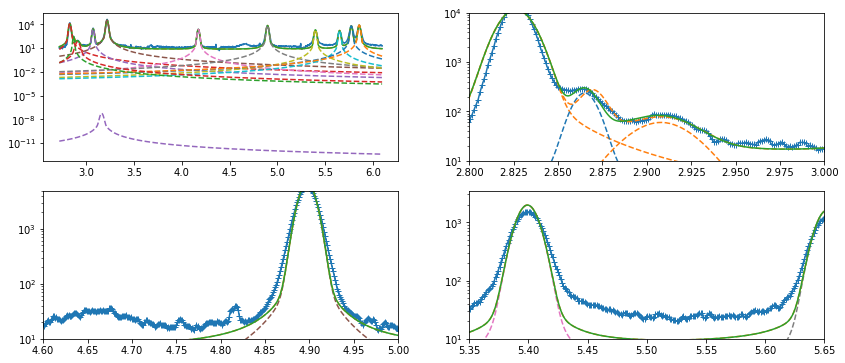

fitting frame:  00406 	 index:  41
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


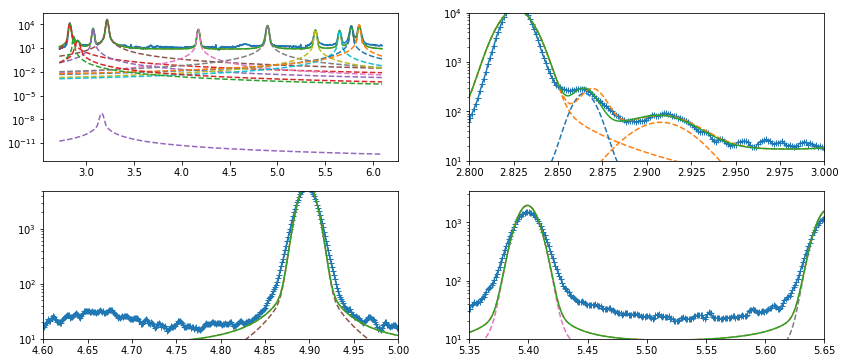

fitting frame:  00416 	 index:  42
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


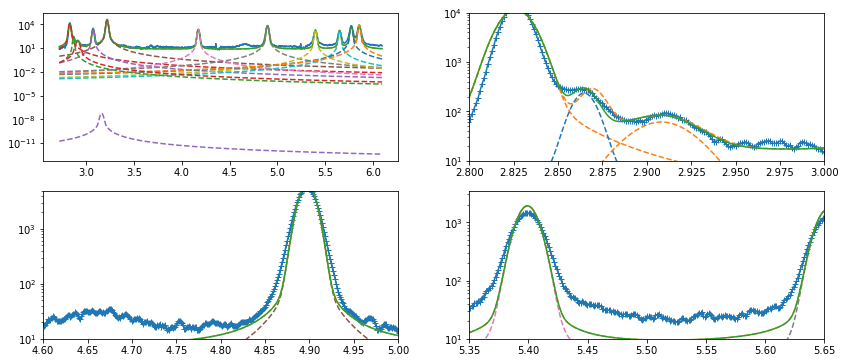

fitting frame:  00426 	 index:  43
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


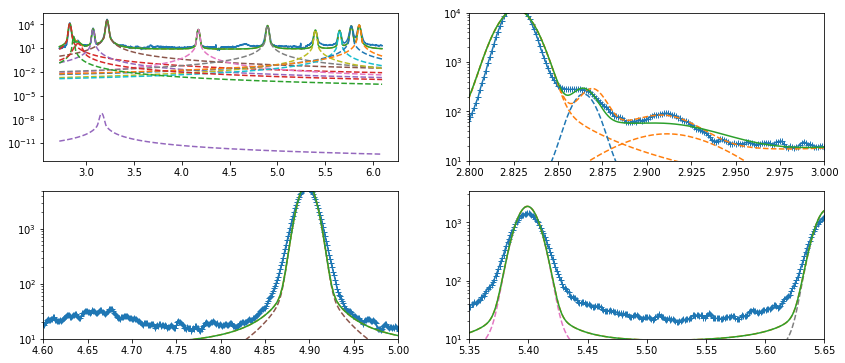

fitting frame:  00436 	 index:  44
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


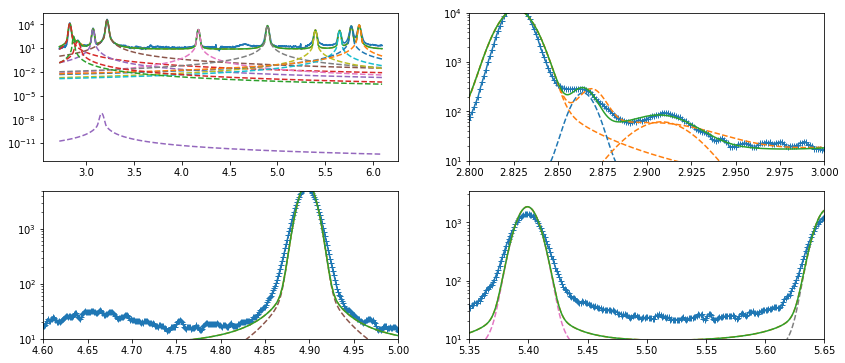

fitting frame:  00446 	 index:  45
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


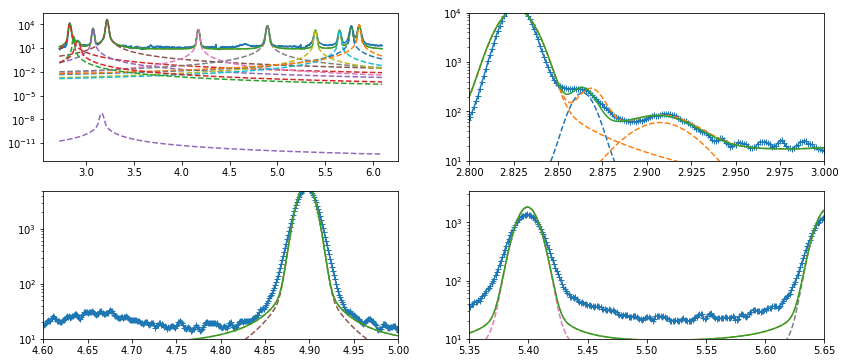

fitting frame:  00456 	 index:  46
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


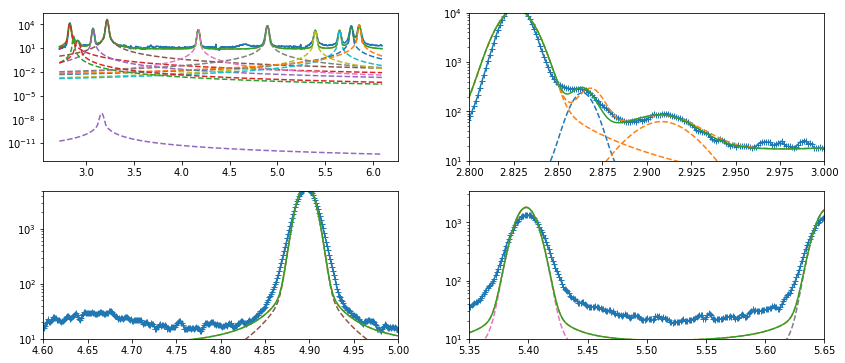

fitting frame:  00466 	 index:  47
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


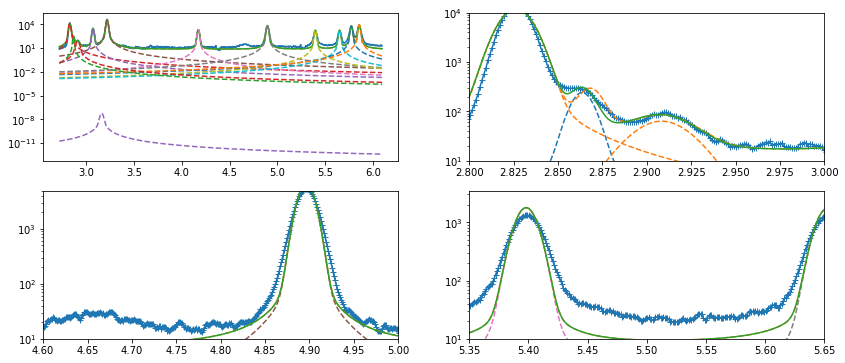

fitting frame:  00476 	 index:  48
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


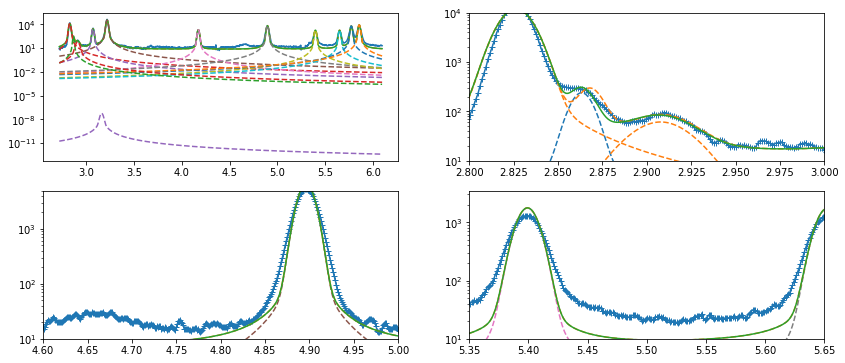

fitting frame:  00486 	 index:  49
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


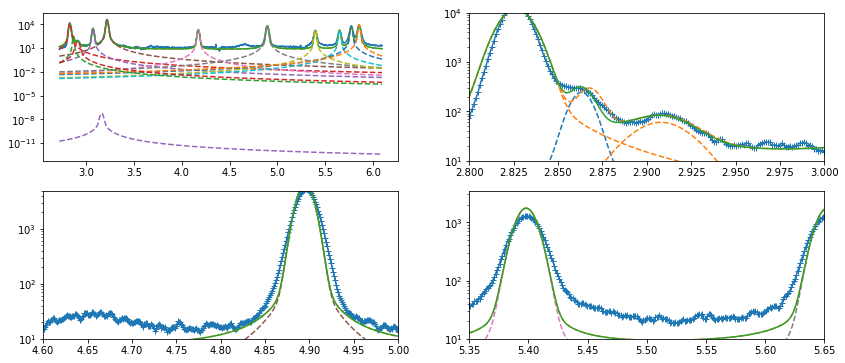

fitting frame:  00496 	 index:  50
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


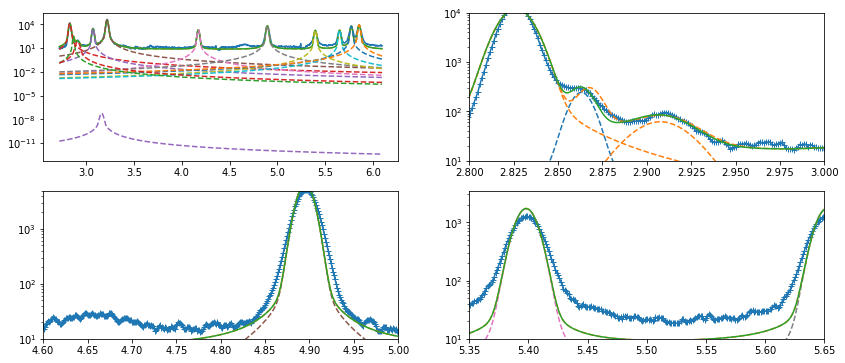

fitting frame:  00506 	 index:  51
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


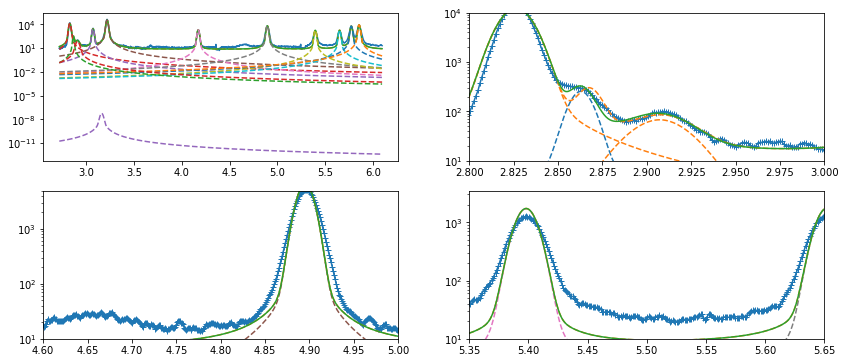

fitting frame:  00516 	 index:  52
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


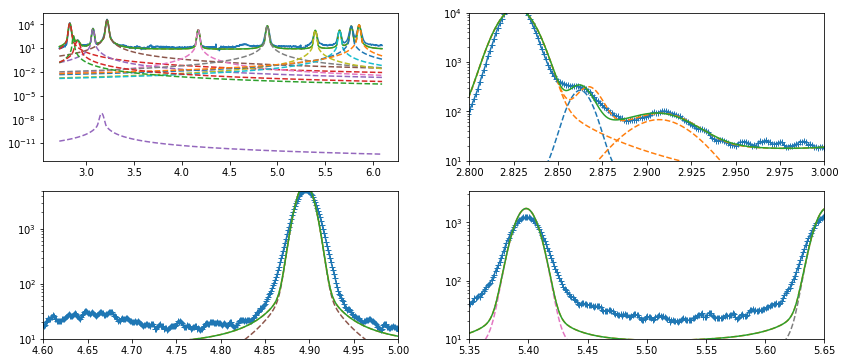

fitting frame:  00526 	 index:  53
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


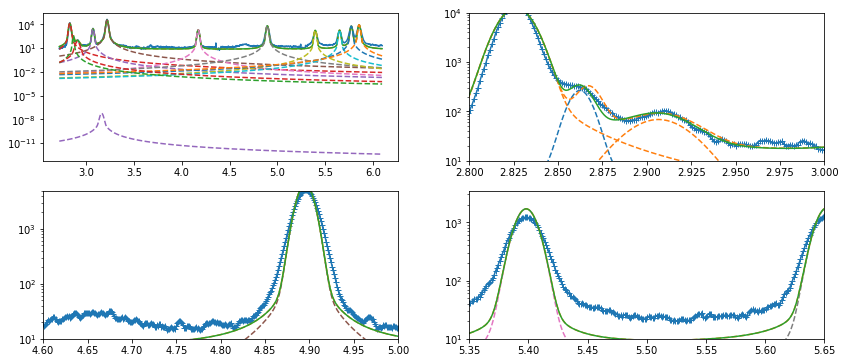

fitting frame:  00536 	 index:  54
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


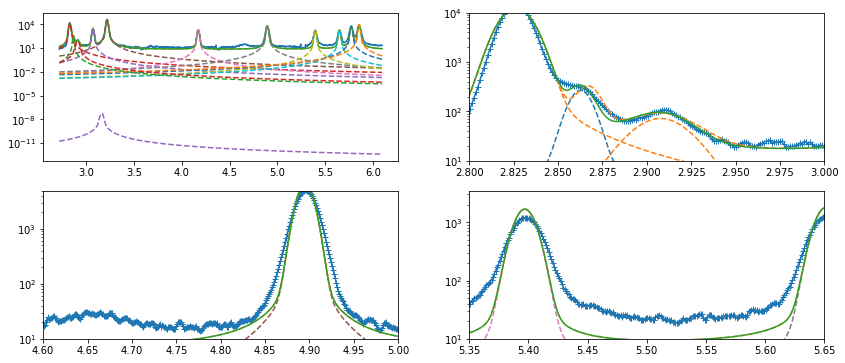

fitting frame:  00546 	 index:  55
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


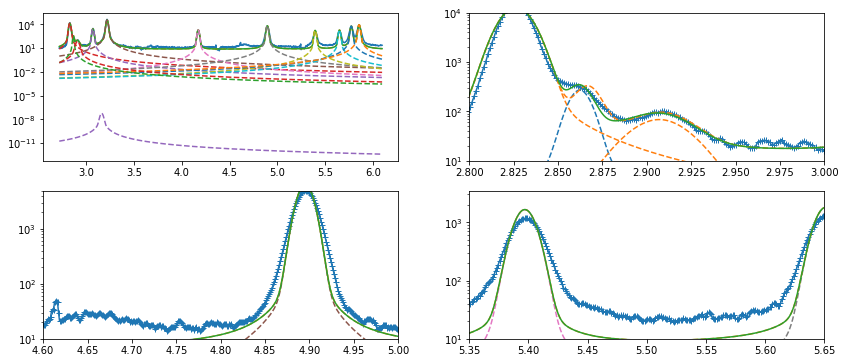

fitting frame:  00556 	 index:  56
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


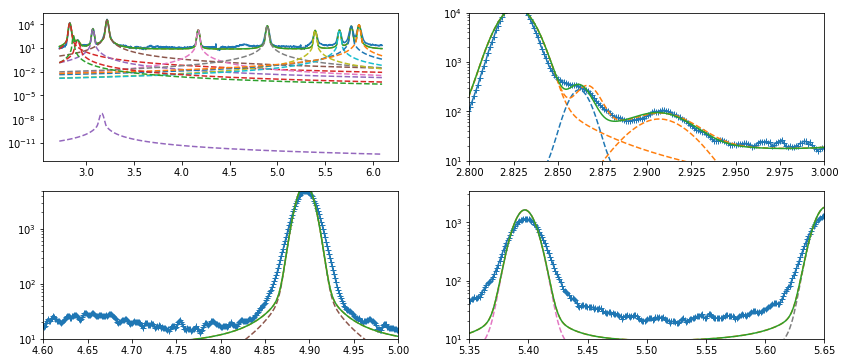

fitting frame:  00566 	 index:  57
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


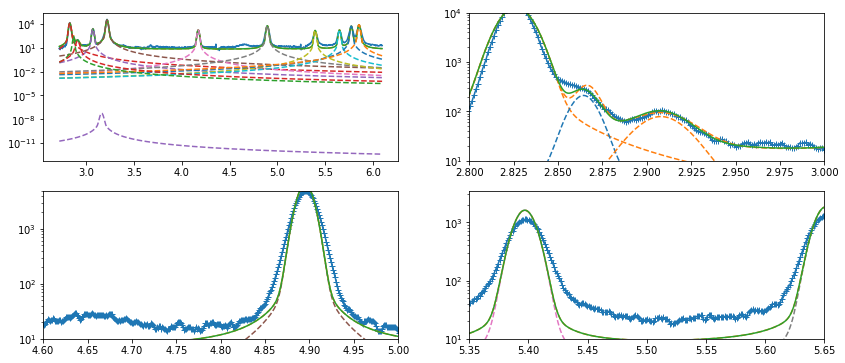

fitting frame:  00576 	 index:  58
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


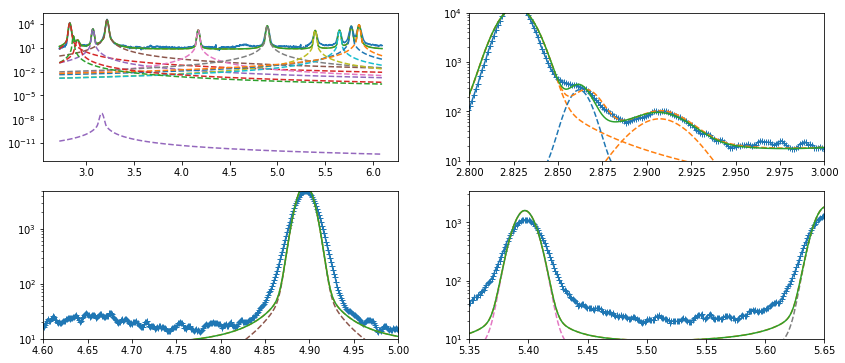

fitting frame:  00586 	 index:  59
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


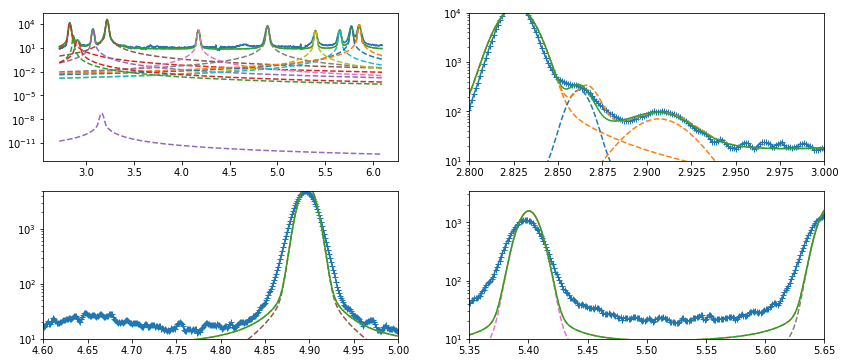

fitting frame:  00596 	 index:  60
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


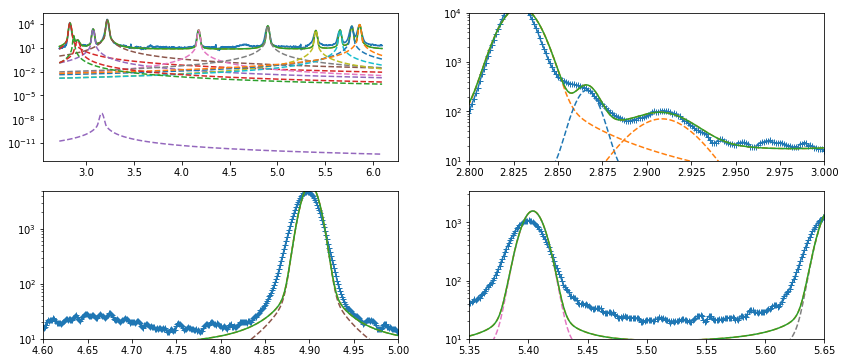

fitting frame:  00606 	 index:  61
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


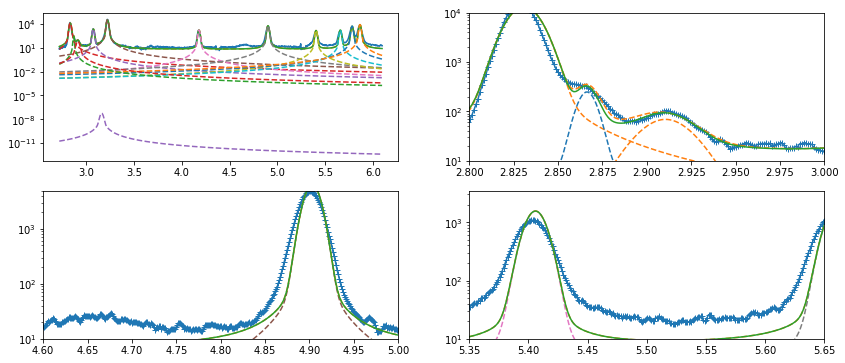

fitting frame:  00616 	 index:  62
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


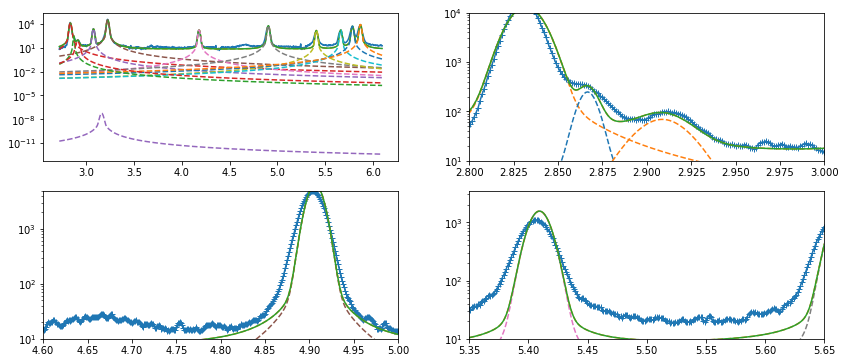

fitting frame:  00626 	 index:  63
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


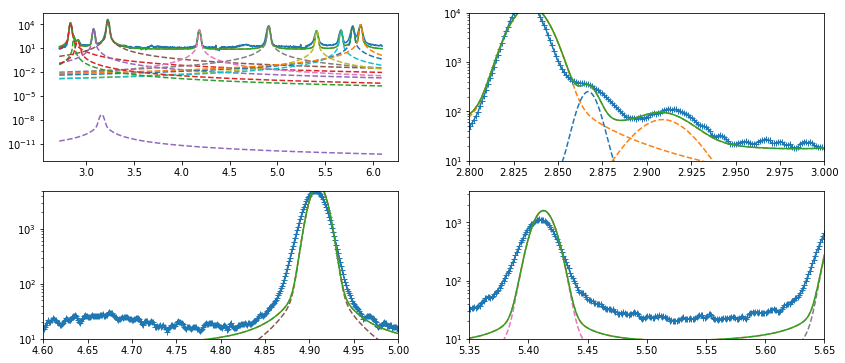

fitting frame:  00636 	 index:  64
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


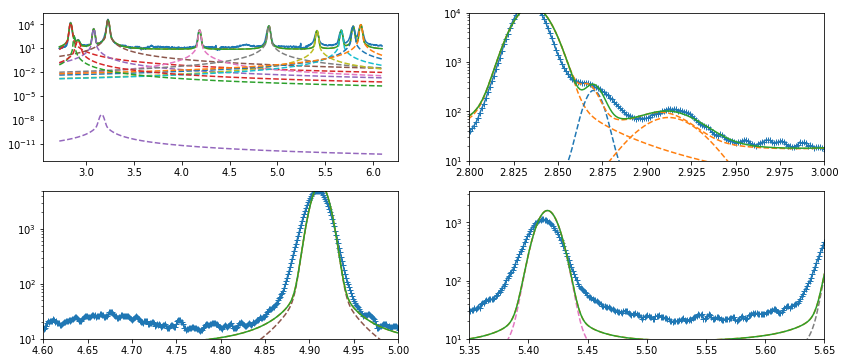

fitting frame:  00646 	 index:  65
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


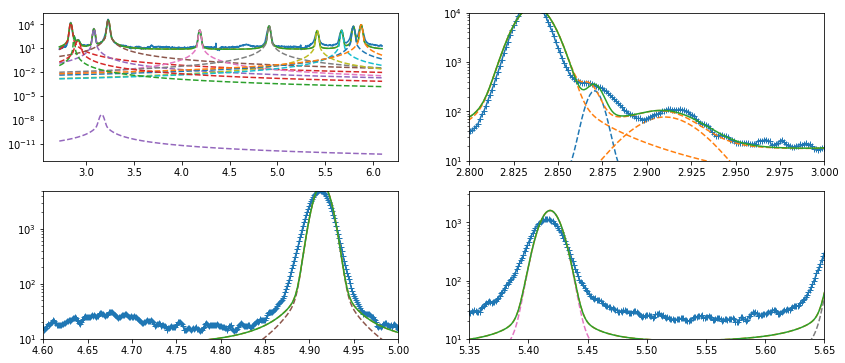

fitting frame:  00656 	 index:  66
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


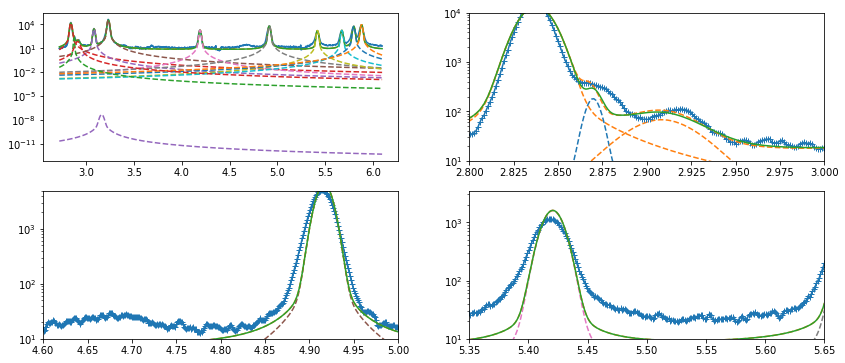

fitting frame:  00666 	 index:  67
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


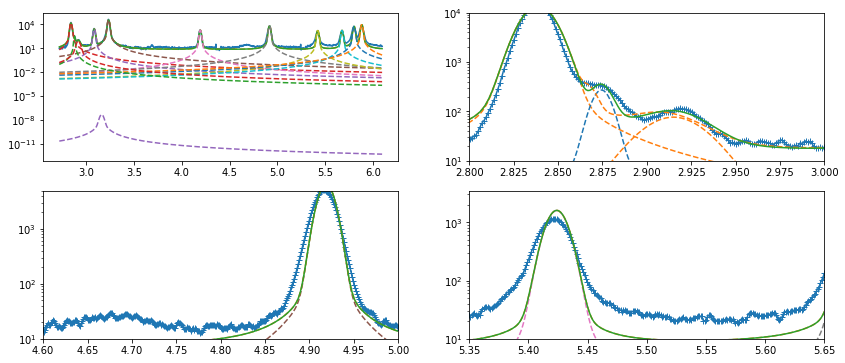

fitting frame:  00676 	 index:  68
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


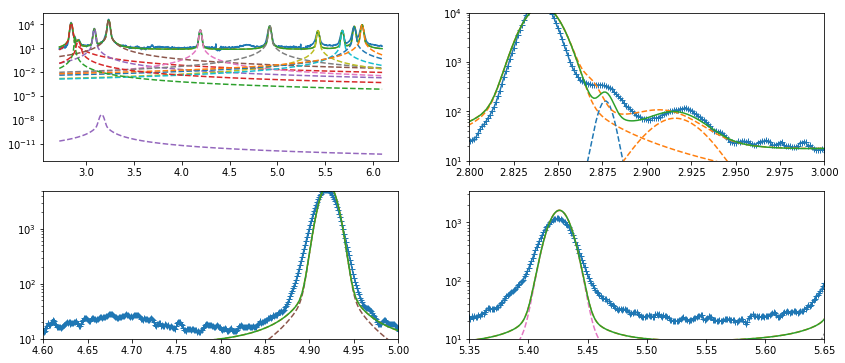

fitting frame:  00686 	 index:  69
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


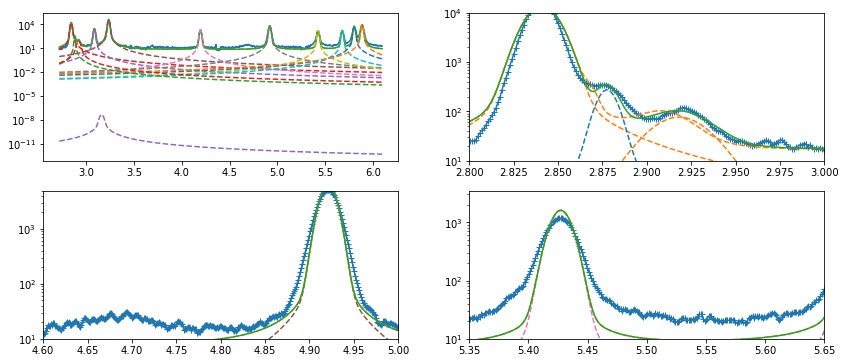

fitting frame:  00696 	 index:  70
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


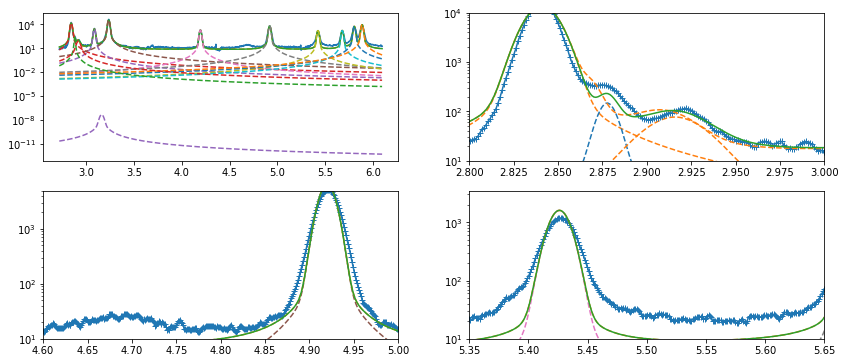

fitting frame:  00706 	 index:  71
ZrH111d_center 2.87 2.85 2.88
ZrH111g_center 2.91 2.89 2.92


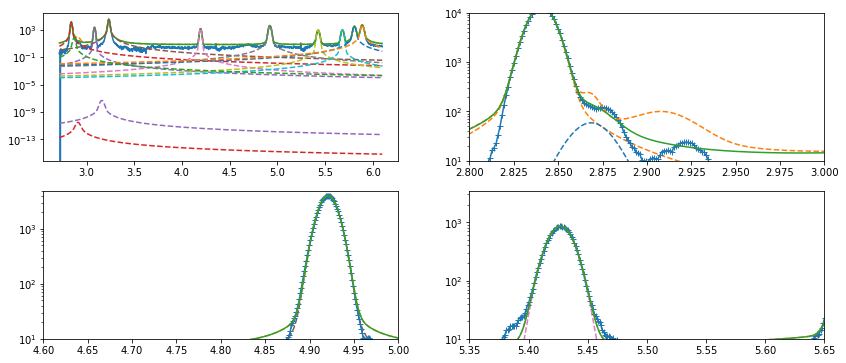

In [86]:
### setup loop to apply above to all frames ###

%matplotlib inline

zrh_fits = dict()
init_zrh_params = zrh_params

for i, (frame, model_result) in enumerate(zr_fits.items()): #  fit from beginning
    print("fitting frame: ", frame, "\t index: ", i+1)
    
    ### slice the data to the pre-set twotheta range ###
    x = data[0][x_min:x_max]
    y = data[i+1][x_min:x_max]

    ### fix zr parameters to frame_num & switch off ### 
    for param in zrh_params:
        if "pv" in param:
            zr_fit_val = model_result[0].params[param].value
            zrh_params[param].set(value=zr_fit_val, min=zr_fit_val*0.95, max=zr_fit_val*1.05, vary=False)

            
    ### update min & max values for ZrH centres using previous strain estimates ###
    wavelength = 0.141565
    for param  in zrh_params:
        if "center" in param and "pv" not in param and "bg" not in param and "ZrFeCr" not in param:
            # update value to last fitted centre position
            # new_centre = comp_out.params[param].value   
                
            # engineering strain of the frame
            frame_eng_strain = eng_strain[int(frame)]

            # convert to expected lattice strain using interpolation
            dict_key = param.split("_")[0] + "_guess"
            guess_Lstrain_function =  interps_dict[dict_key]
            expected_Lstrain = lambda x: guess_Lstrain_function(x) if (x > 0) else 0
            Lstrain = expected_Lstrain(frame_eng_strain)

            # take starting two-theta, convert to d-space and add lattice strain
            strained_d = twotheta_to_d(init_zrh_params[param].value, wavelength) + Lstrain

            # convert back to twotheta
            strained_twotheta = d_to_twotheta(strained_d, wavelength)
            
            offset=0.015
            guess_centre = strained_twotheta
            min_bound = strained_twotheta - offset
            max_bound = strained_twotheta + offset
            
            print(param, f"{guess_centre:0.2f}", f"{min_bound:0.2f}", f"{max_bound:0.2f}")
            zrh_params[param].set(value=guess_centre, min=min_bound, max=max_bound)
            
    ### print params ###
#     zrh_params.pretty_print()
    
    ### setup model ###
    comp_model = zr_model + ZrH_111d + ZrH_111g + ZrFeCr 

    ### rough fit for hydride peaks (i.e. Zr peaks are not varying during this fit) ###
    comp_init = comp_model.eval(zrh_params, x=x)
    comp_out = comp_model.fit(y, zrh_params, x=x, nan_policy='omit')
    comp_comps = comp_out.eval_components(x=x)
          
    plot_results(x, y, comp_init, comp_out)
    
    ######### update params #########
            
    zrh_params = comp_out.params
    
    ### add to dictionary ###
    zrh_fits[str(frame)] = [comp_out, comp_init]
    
%matplotlib notebook

In [ ]:
### use zrh_params as base for fit with all parameters free'd ###

In [ ]:
### Slice down data to onlt the first 3-4 Zr peaks

### got to look at the background again... ###

fitting frame:  00006 	 index:  1
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.134e-07        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.4188      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01237     -inf      inf     None     True     None     None
ZrFeCr_height      1.402e-05     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.006186    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.897    2.881    2.912     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

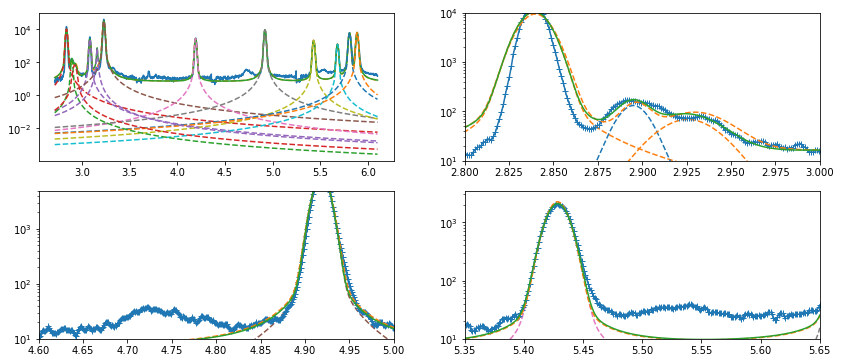

fitting frame:  00016 	 index:  2
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.897    2.881    2.912     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

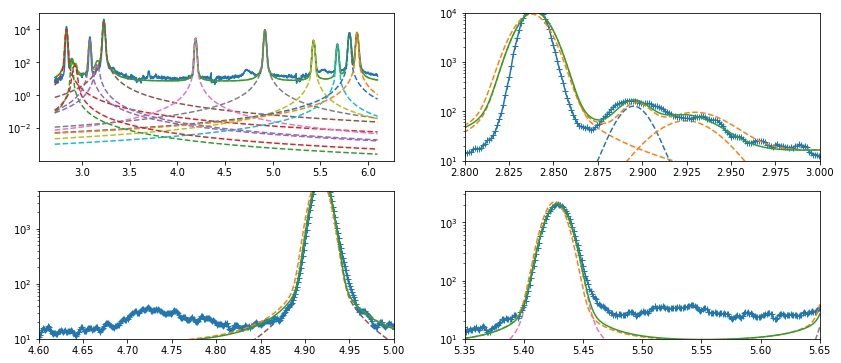

fitting frame:  00026 	 index:  3
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.896    2.881    2.911     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

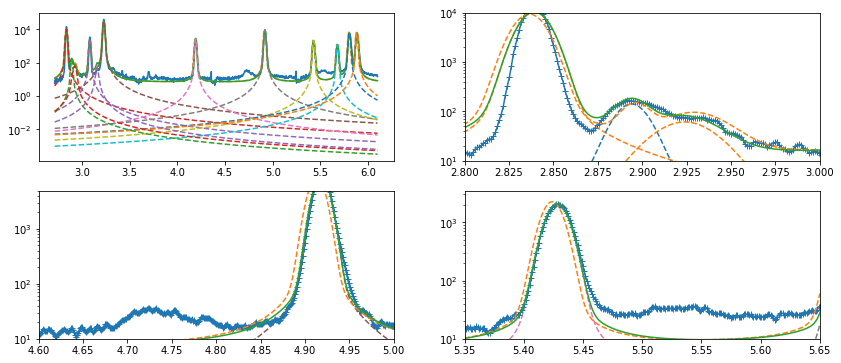

fitting frame:  00036 	 index:  4
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.895     2.88     2.91     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

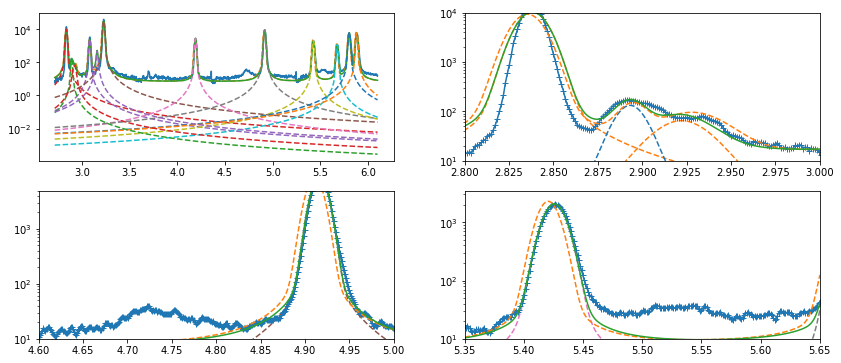

fitting frame:  00046 	 index:  5
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.894    2.879    2.909     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

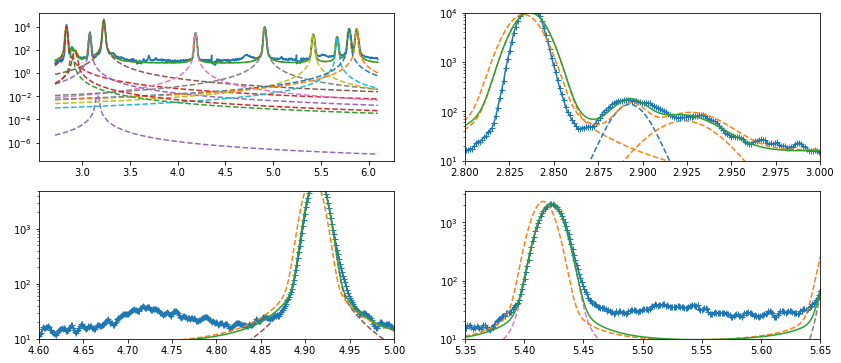

fitting frame:  00056 	 index:  6
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.892    2.877    2.907     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

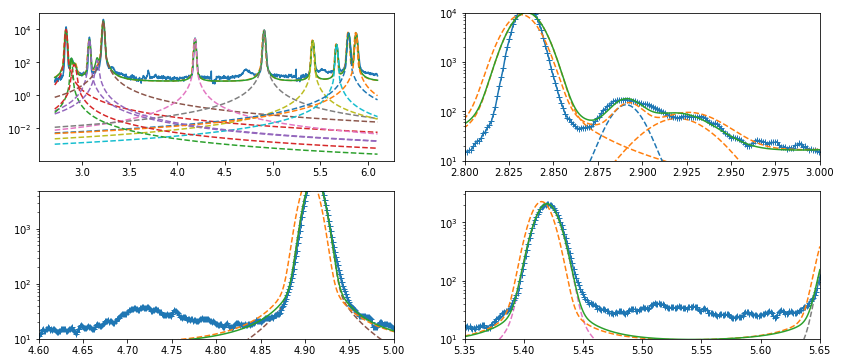

fitting frame:  00066 	 index:  7
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.891    2.876    2.906     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

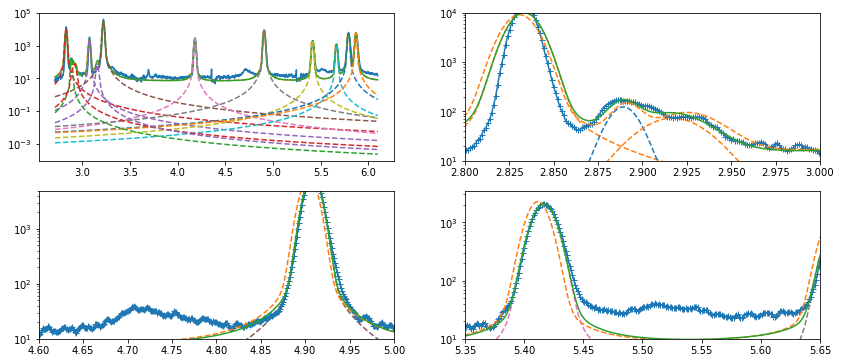

fitting frame:  00076 	 index:  8
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center         2.89    2.875    2.905     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

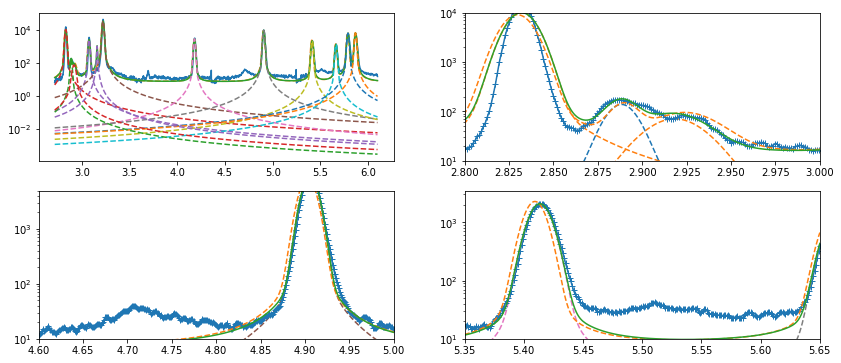

fitting frame:  00086 	 index:  9
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.888    2.873    2.903     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

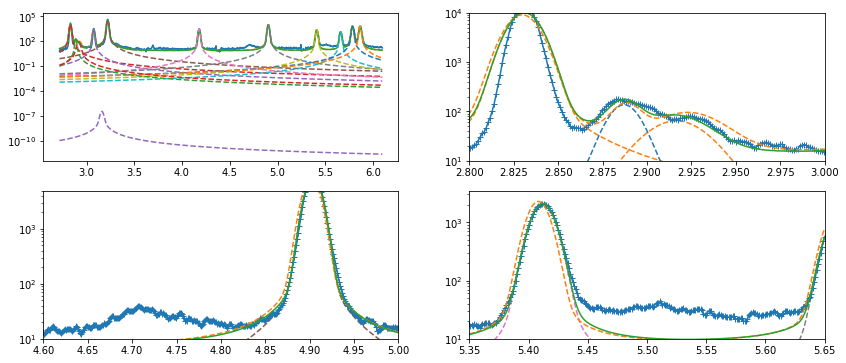

fitting frame:  00096 	 index:  10
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.887    2.872    2.902     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

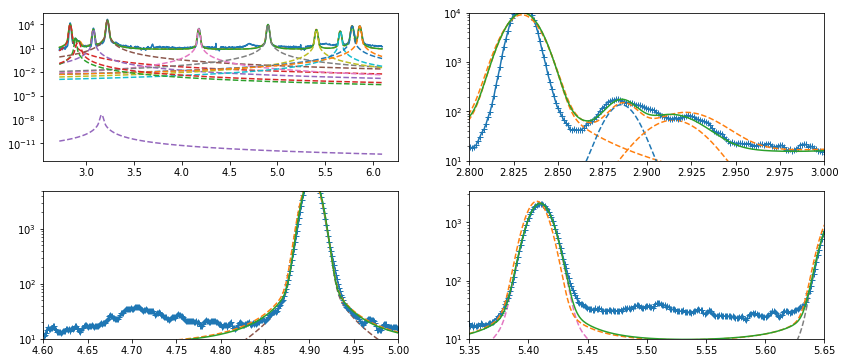

fitting frame:  00106 	 index:  11
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.885     2.87      2.9     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

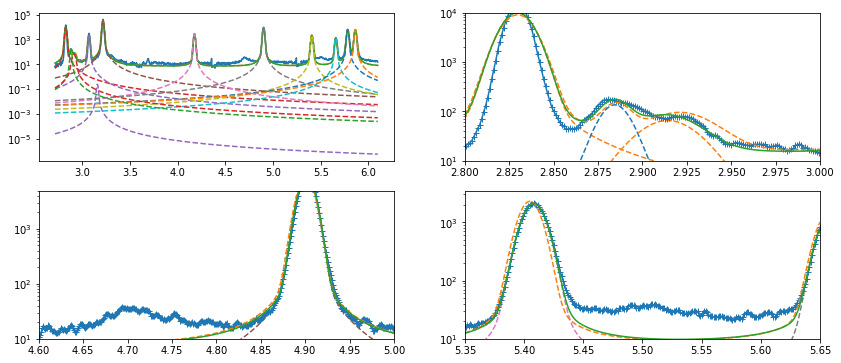

fitting frame:  00116 	 index:  12
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.884    2.869    2.899     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

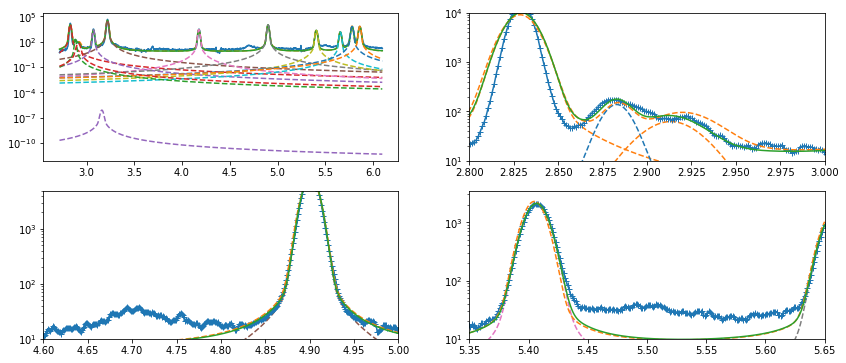

fitting frame:  00126 	 index:  13
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.883    2.868    2.898     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

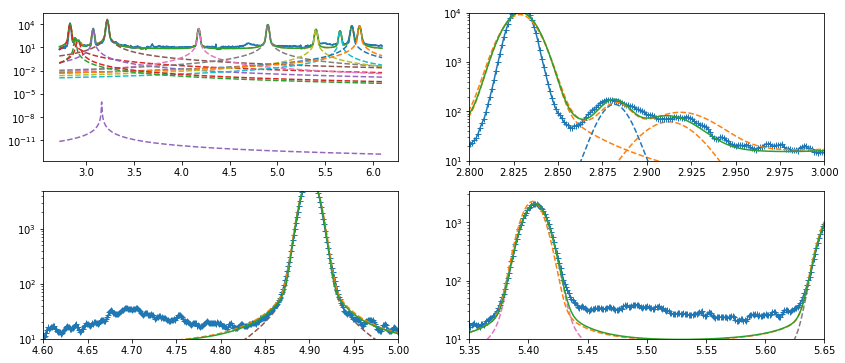

fitting frame:  00136 	 index:  14
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.881    2.866    2.896     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

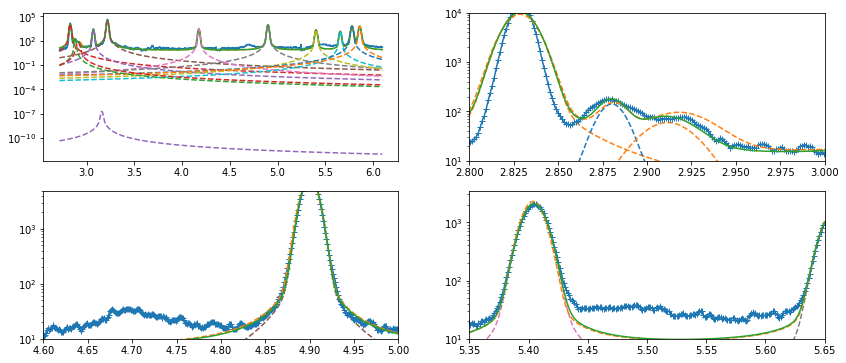

fitting frame:  00146 	 index:  15
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center         2.88    2.865    2.895     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

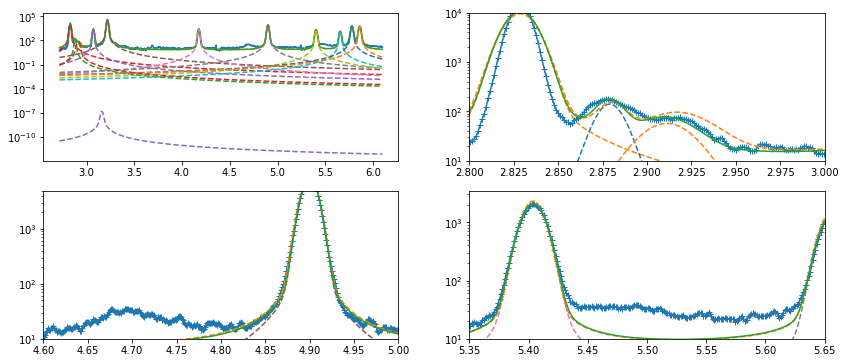

fitting frame:  00156 	 index:  16
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.879    2.864    2.894     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

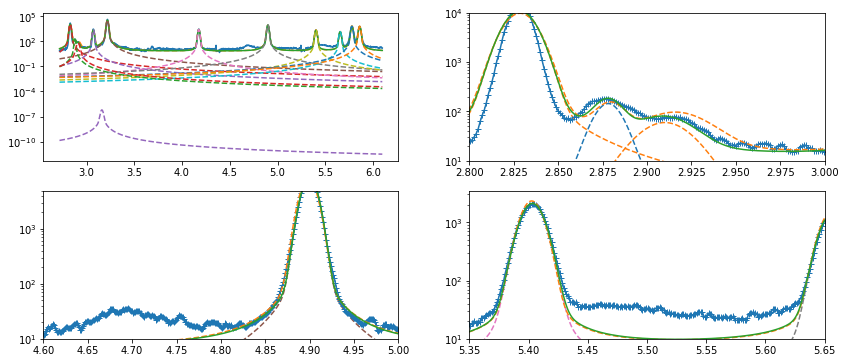

fitting frame:  00166 	 index:  17
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.878    2.863    2.893     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

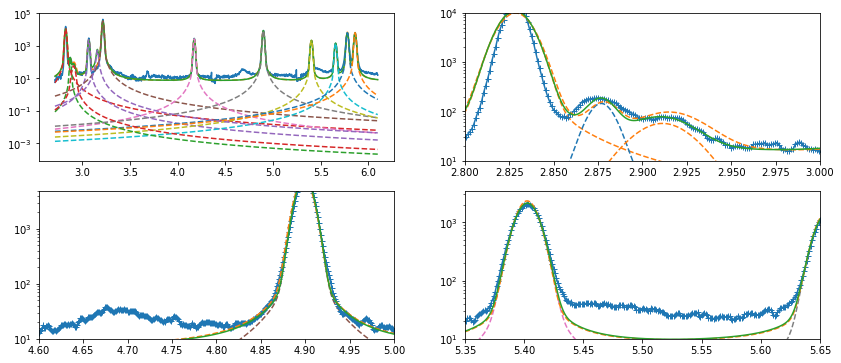

fitting frame:  00176 	 index:  18
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.878    2.863    2.893     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

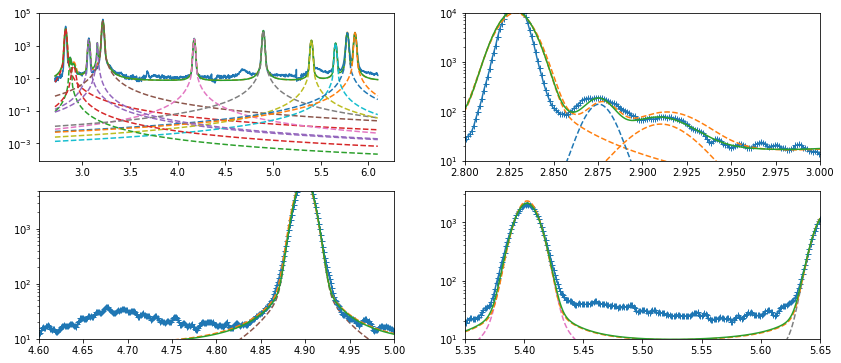

fitting frame:  00186 	 index:  19
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.877    2.862    2.892     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

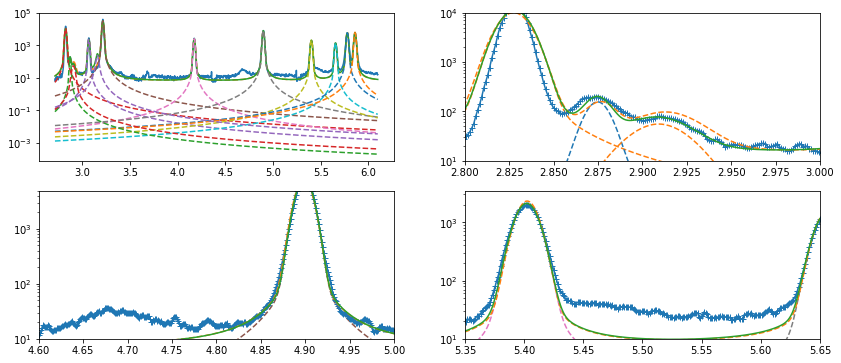

fitting frame:  00196 	 index:  20
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.876    2.861    2.891     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

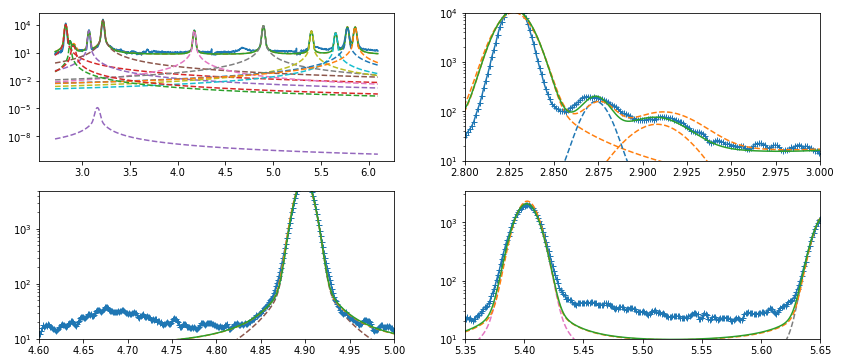

fitting frame:  00206 	 index:  21
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.875     2.86     2.89     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

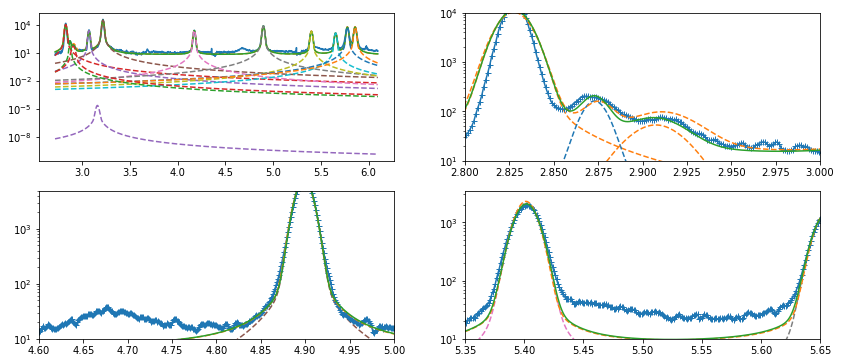

fitting frame:  00216 	 index:  22
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.875     2.86     2.89     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

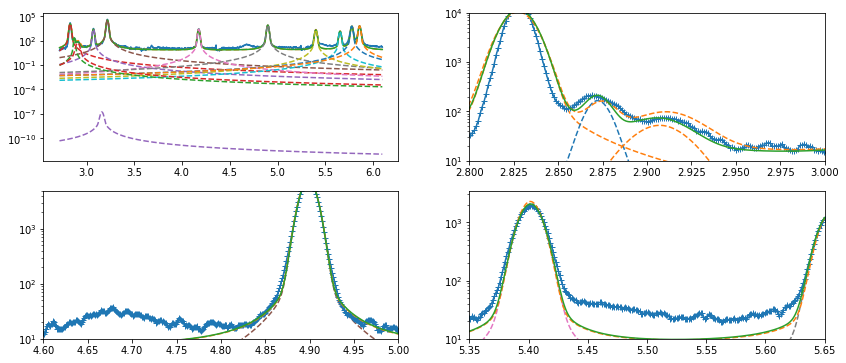

fitting frame:  00226 	 index:  23
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.874    2.859    2.889     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

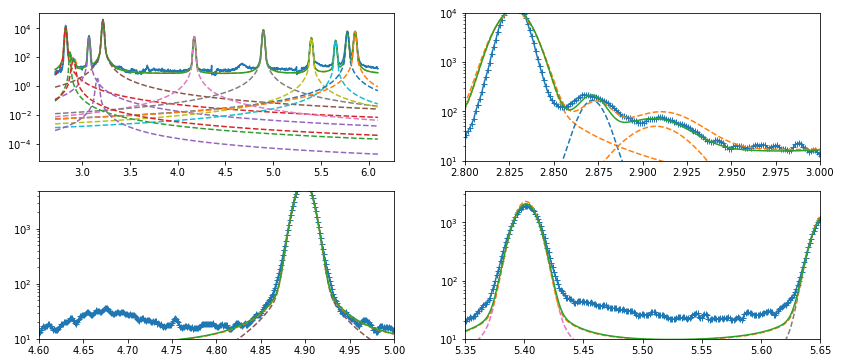

fitting frame:  00236 	 index:  24
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.874    2.859    2.889     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

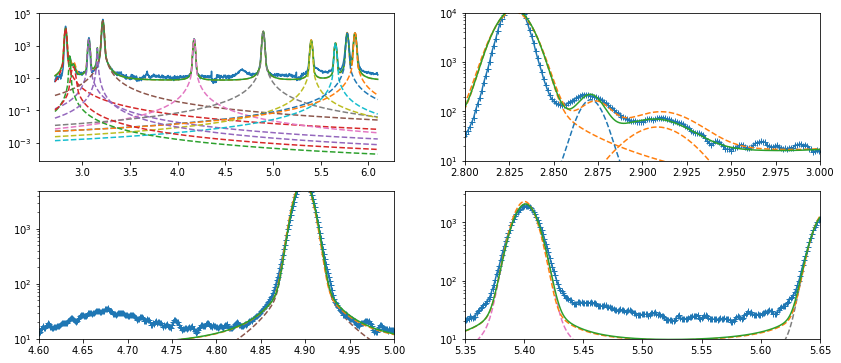

fitting frame:  00246 	 index:  25
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.873    2.858    2.888     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

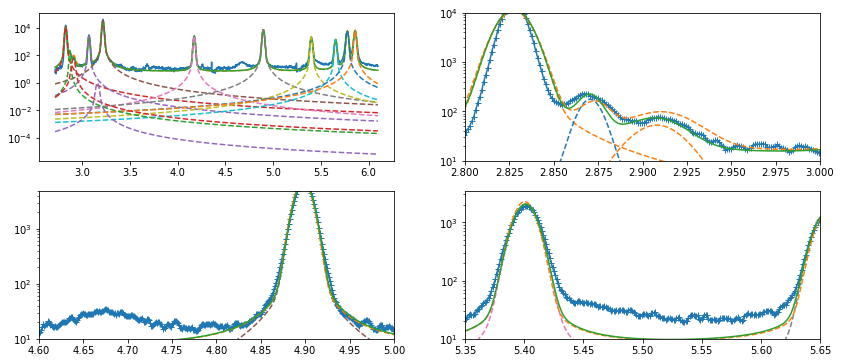

fitting frame:  00256 	 index:  26
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.873    2.858    2.888     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

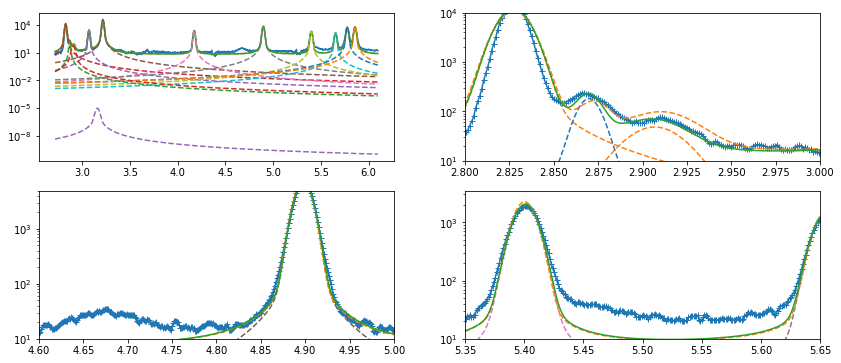

fitting frame:  00266 	 index:  27
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.873    2.858    2.888     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

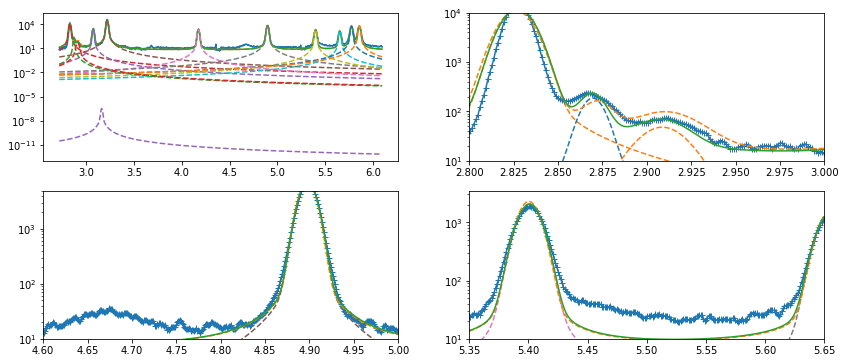

fitting frame:  00276 	 index:  28
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.872    2.857    2.887     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

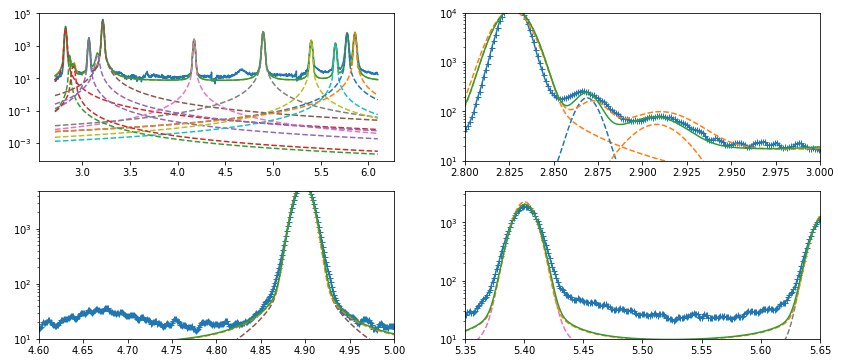

fitting frame:  00286 	 index:  29
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   4.956e-08        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01096     -inf      inf     None     True     None     None
ZrFeCr_height      3.836e-06     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005482    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.872    2.857    2.887     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

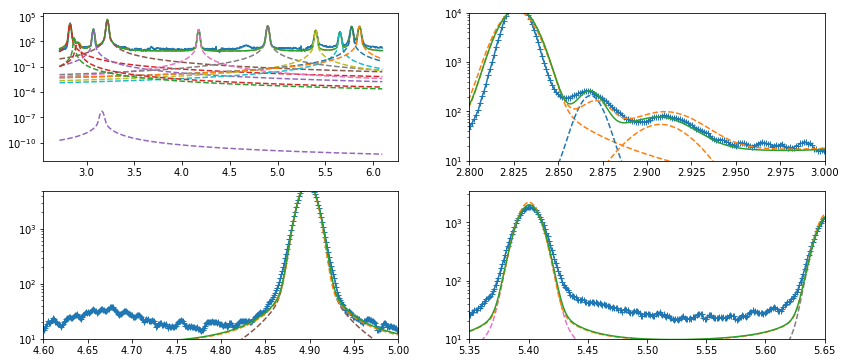

fitting frame:  00296 	 index:  30
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   8.014e-06        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3003      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.01343     -inf      inf     None     True     None     None
ZrFeCr_height      0.0005065     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.006713    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.871    2.856    2.886     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

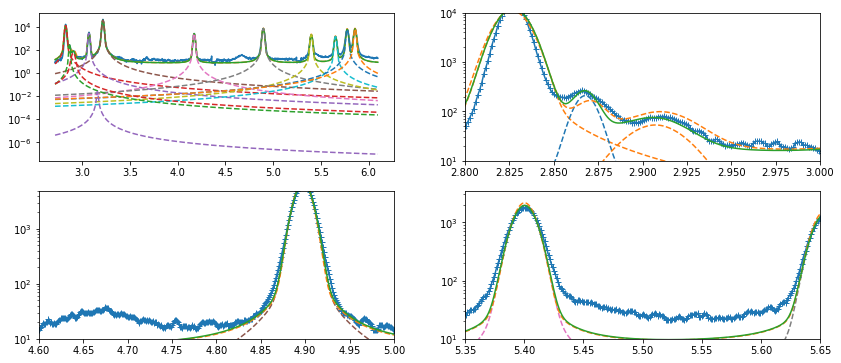

fitting frame:  00306 	 index:  31
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   3.086e-06        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.7231      0.3      0.8     None     True     None     None
ZrFeCr_fwhm          0.0118     -inf      inf     None     True     None     None
ZrFeCr_height      0.0001884     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005902    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.871    2.856    2.886     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     

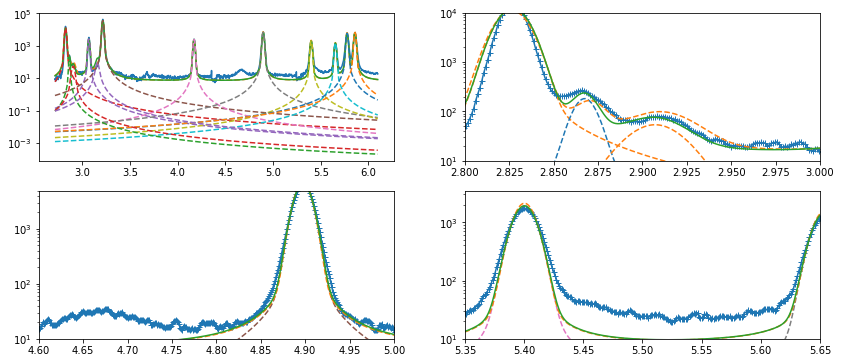

fitting frame:  00316 	 index:  32
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   3.662e-05        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.7459      0.3      0.8     None     True     None     None
ZrFeCr_fwhm        0.007379     -inf      inf     None     True     None     None
ZrFeCr_height      0.003541     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.003689    0.002     0.02     None     True     None     None
ZrH111d_amplitude     2.322        0      inf     None     True     None     None
ZrH111d_center        2.871    2.856    2.886     None     True     None     None
ZrH111d_fraction     0.3001      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01731     -inf      inf     None     True     None     None
ZrH111d_height        113.8     -inf      inf     None     T

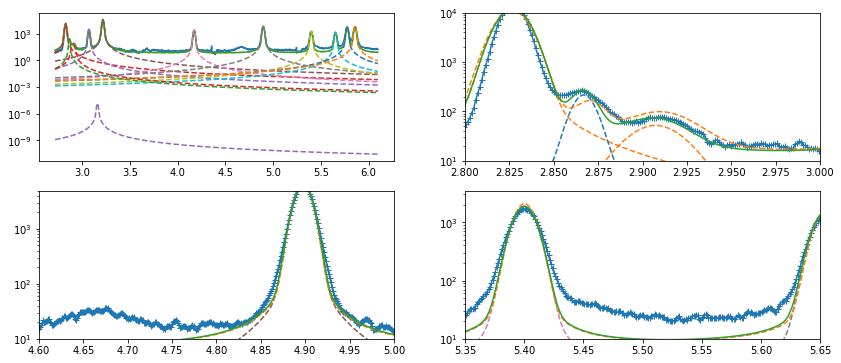

fitting frame:  00326 	 index:  33
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   6.366e-05        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.7993      0.3      0.8     None     True     None     None
ZrFeCr_fwhm        0.009493     -inf      inf     None     True     None     None
ZrFeCr_height      0.004676     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.004747    0.002     0.02     None     True     None     None
ZrH111d_amplitude     3.791        0      inf     None     True     None     None
ZrH111d_center        2.871    2.856    2.886     None     True     None     None
ZrH111d_fraction     0.3002      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01506     -inf      inf     None     True     None     None
ZrH111d_height        213.6     -inf      inf     None     T

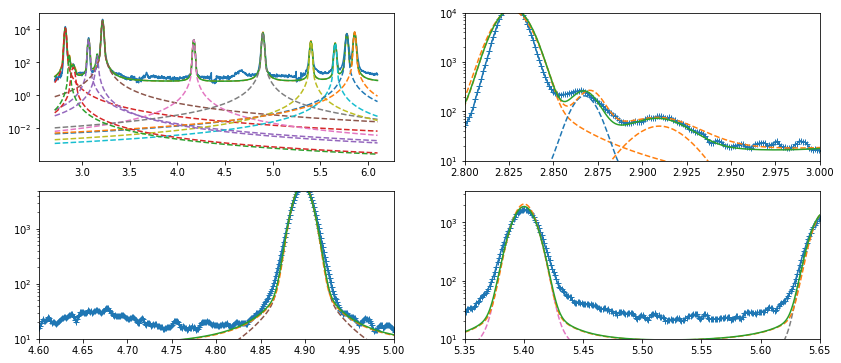

fitting frame:  00336 	 index:  34
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   0.0004774        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.7995      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.02893     -inf      inf     None     True     None     None
ZrFeCr_height       0.01151     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01446    0.002     0.02     None     True     None     None
ZrH111d_amplitude     3.901        0      inf     None     True     None     None
ZrH111d_center        2.871    2.856    2.886     None     True     None     None
ZrH111d_fraction     0.3003      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01548     -inf      inf     None     True     None     None
ZrH111d_height        213.8     -inf      inf     None     T

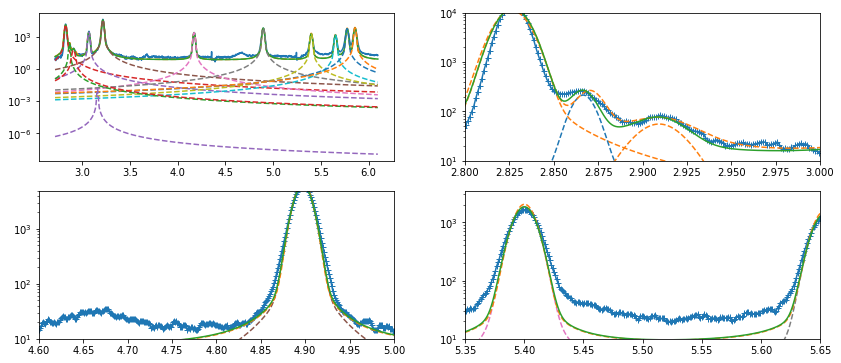

fitting frame:  00346 	 index:  35
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction       0.304      0.3      0.8     None     True     None     None
ZrFeCr_fwhm        0.004534     -inf      inf     None     True     None     None
ZrFeCr_height      4.071e-07     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.002267    0.002     0.02     None     True     None     None
ZrH111d_amplitude     3.931        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction     0.3001      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01529     -inf      inf     None     True     None     None
ZrH111d_height        218.2     -inf      inf     None     

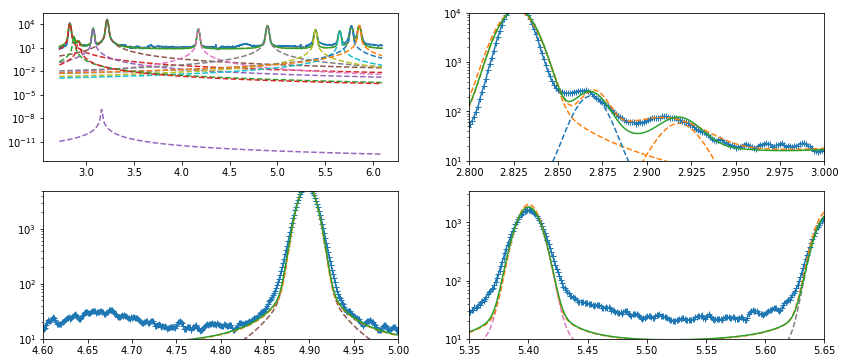

fitting frame:  00356 	 index:  36
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3566      0.3      0.8     None     True     None     None
ZrFeCr_fwhm        0.005309     -inf      inf     None     True     None     None
ZrFeCr_height      3.412e-07     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.002655    0.002     0.02     None     True     None     None
ZrH111d_amplitude     3.973        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01528     -inf      inf     None     True     None     None
ZrH111d_height        220.7     -inf      inf     None     

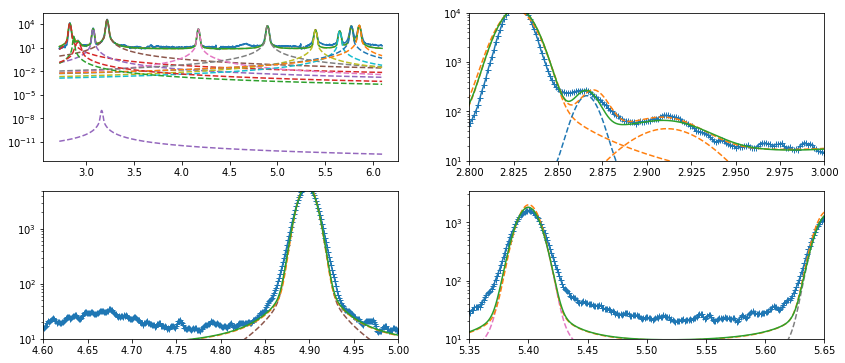

fitting frame:  00366 	 index:  37
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3566      0.3      0.8     None     True     None     None
ZrFeCr_fwhm            0.01     -inf      inf     None     True     None     None
ZrFeCr_height      1.811e-07     -inf      inf     None     True     None     None
ZrFeCr_sigma       0.005002    0.002     0.02     None     True     None     None
ZrH111d_amplitude     3.804        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01483     -inf      inf     None     True     None     None
ZrH111d_height        217.7     -inf      inf     None     

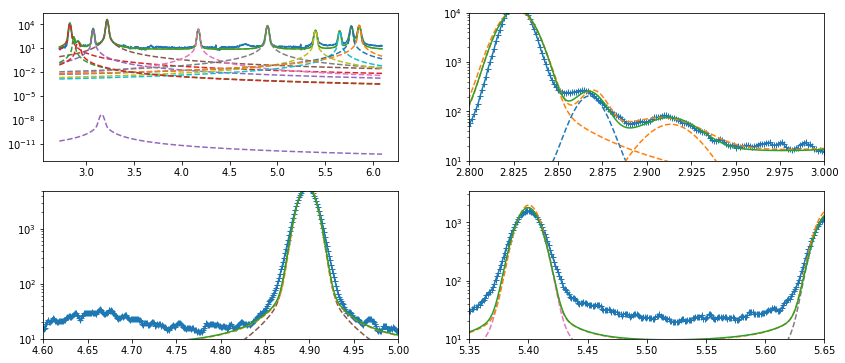

fitting frame:  00376 	 index:  38
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3049      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.03255     -inf      inf     None     True     None     None
ZrFeCr_height      5.669e-08     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01628    0.002     0.02     None     True     None     None
ZrH111d_amplitude      3.86        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm         0.0152     -inf      inf     None     True     None     None
ZrH111d_height        215.5     -inf      inf     None     

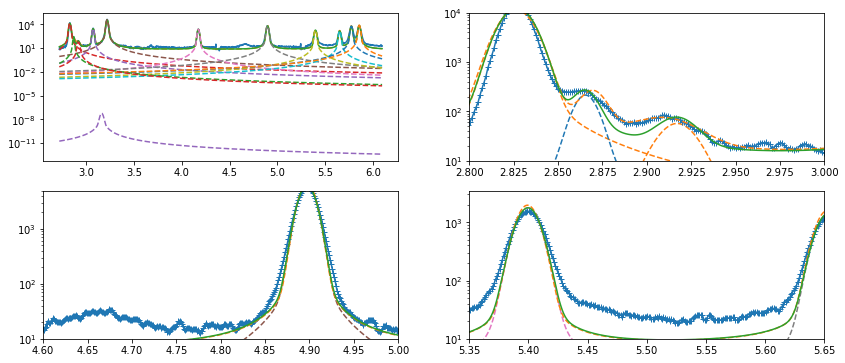

fitting frame:  00386 	 index:  39
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3049      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.03255     -inf      inf     None     True     None     None
ZrFeCr_height      5.669e-08     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01628    0.002     0.02     None     True     None     None
ZrH111d_amplitude      3.91        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction     0.3001      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01489     -inf      inf     None     True     None     None
ZrH111d_height        222.9     -inf      inf     None     

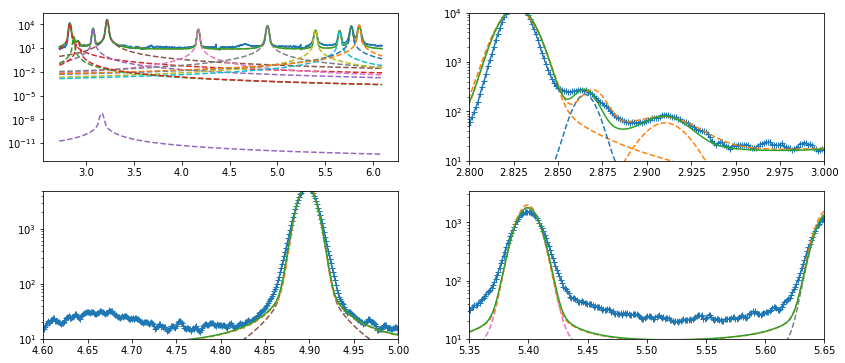

fitting frame:  00396 	 index:  40
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3049      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.03255     -inf      inf     None     True     None     None
ZrFeCr_height      5.669e-08     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01628    0.002     0.02     None     True     None     None
ZrH111d_amplitude     4.172        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01491     -inf      inf     None     True     None     None
ZrH111d_height        237.5     -inf      inf     None     

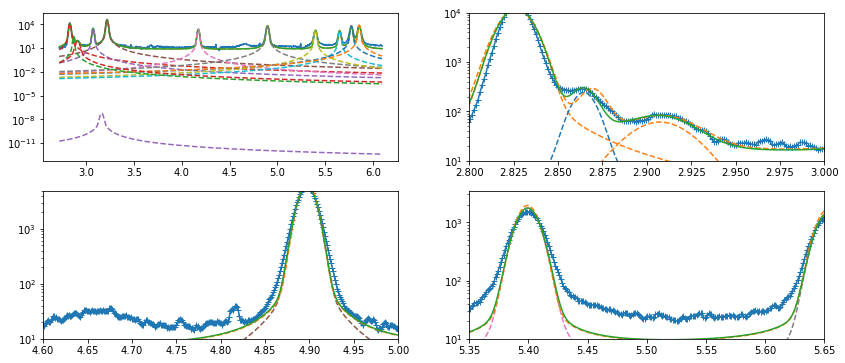

fitting frame:  00406 	 index:  41
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3049      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.03255     -inf      inf     None     True     None     None
ZrFeCr_height      5.669e-08     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01628    0.002     0.02     None     True     None     None
ZrH111d_amplitude     4.096        0      inf     None     True     None     None
ZrH111d_center         2.87    2.855    2.885     None     True     None     None
ZrH111d_fraction     0.3001      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01481     -inf      inf     None     True     None     None
ZrH111d_height        234.7     -inf      inf     None     

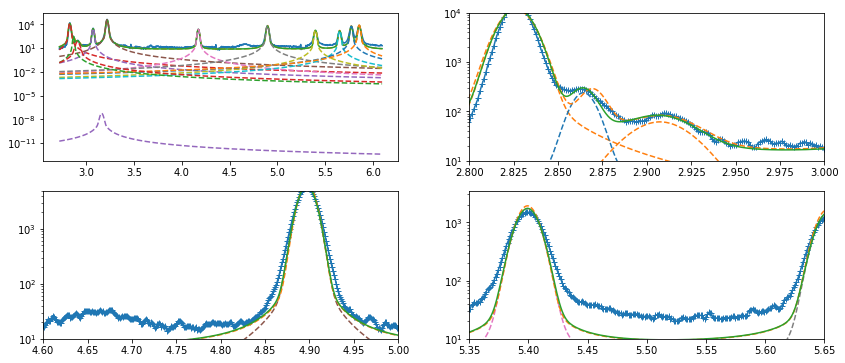

fitting frame:  00416 	 index:  42
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3049      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.03255     -inf      inf     None     True     None     None
ZrFeCr_height      5.669e-08     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01628    0.002     0.02     None     True     None     None
ZrH111d_amplitude     4.113        0      inf     None     True     None     None
ZrH111d_center        2.869    2.854    2.884     None     True     None     None
ZrH111d_fraction        0.3      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01477     -inf      inf     None     True     None     None
ZrH111d_height        236.4     -inf      inf     None     

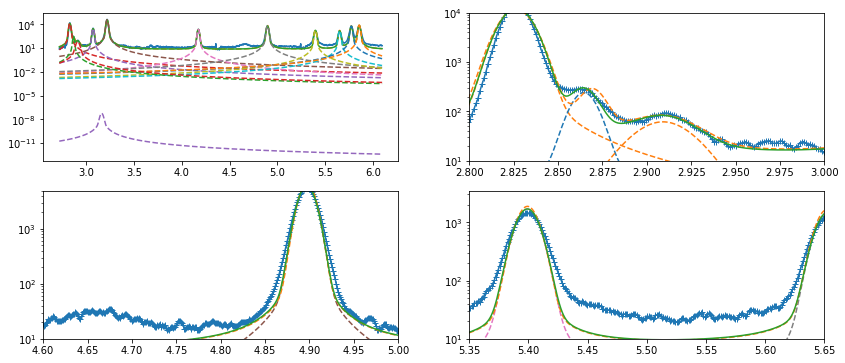

fitting frame:  00426 	 index:  43
Name                  Value      Min      Max   Stderr     Vary     Expr Brute_Step
ZrFeCr_amplitude   2.178e-09        0      inf     None     True     None     None
ZrFeCr_center          3.16     3.15     3.17     None     True     None     None
ZrFeCr_fraction      0.3049      0.3      0.8     None     True     None     None
ZrFeCr_fwhm         0.03255     -inf      inf     None     True     None     None
ZrFeCr_height      5.669e-08     -inf      inf     None     True     None     None
ZrFeCr_sigma        0.01628    0.002     0.02     None     True     None     None
ZrH111d_amplitude     3.913        0      inf     None     True     None     None
ZrH111d_center        2.869    2.854    2.884     None     True     None     None
ZrH111d_fraction     0.3012      0.3      0.6     None     True     None     None
ZrH111d_fwhm        0.01467     -inf      inf     None     True     None     None
ZrH111d_height        226.2     -inf      inf     None     

KeyboardInterrupt: 

In [90]:
%matplotlib inline

final_fits = dict()
final_params = zrh_fits["00006"][0].params

for i, (frame, model_result) in enumerate(zrh_fits.items()): 
    print("fitting frame: ", frame, "\t index: ", i+1)
    
    ### setup parameters & set to vary all ### 
    params = model_result[0].params
    for param in params:
        params[param].set(vary=True)
    
    params.pretty_print()

    ### slice the data to the pre-set twotheta range ###
    x = data[0][x_min:x_max]
    y = data[i+1][x_min:x_max]
        
    comp_init = comp_model.eval(params, x=x)
    comp_out = comp_model.fit(y, params, x=x, nan_policy='omit')
    comp_comps = comp_out.eval_components(x=x)
          
    plot_results(x, y, comp_init, comp_out)
    
    ### add to dictionary ###
    final_fits[str(frame)] = [comp_out, comp_init]
    
%matplotlib notebook

In [ ]:
DZrH_111_centers = []
GZrH_111_centers = []

for key, var in fits.items():
    if "ZrH111d_center" in var[0].params:
        DZrH_111_centers.append(var[0].params["ZrH111d_center"].value)
    if "ZrH111g_center" in var[0].params:
        GZrH_111_centers.append(var[0].params["ZrH111g_center"].value)

DZrH_111_d_centers = [] 

for ttheta in DZrH_111_centers:
    d = 0.141565 / (2*np.sin(np.deg2rad(ttheta)))
    DZrH_111_d_centers.append(d)
    
GZrH_111_d_centers = [] 

for ttheta in GZrH_111_centers:
    d = 0.141565 / (2*np.sin(np.deg2rad(ttheta)))
    GZrH_111_d_centers.append(d)

D_L0 = DZrH_111_d_centers[-1]
G_L0 = GZrH_111_d_centers[-1]
D_strain = []
G_strain = []

for Dl, Gl in zip(DZrH_111_d_centers, GZrH_111_d_centers):
    D_strain.append((Dl - D_L0) / D_L0)
    G_strain.append((Gl - G_L0) / G_L0)

print(np.asarray(D_strain)*10**6)
print(np.asarray(G_strain)*10**6)